In [58]:
import scvelo as scv
import numpy as np
import scipy.sparse
import scanpy as sc
import pandas as pd
import anndata
import seaborn as sns
import matplotlib.pyplot as plt

In [59]:
!which python

/PHShome/qq06/miniconda3/envs/bayes/bin/python


## Embedding from Sarah's downloaded dataset

In [3]:
adata = sc.read('normal_muscle.h5ad')
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)
sc.pp.highly_variable_genes(adata, n_top_genes=3000)
adata.raw = adata
adata = adata[:, adata.var.highly_variable]
sc.pp.scale(adata, max_value=10)
sc.tl.pca(adata, n_comps=30)
sc.pp.neighbors(adata, n_neighbors=30, n_pcs=30, use_rep='X_pca')
sc.tl.diffmap(adata, n_comps=15)

sc.pp.neighbors(adata, n_neighbors=30, n_pcs=2, use_rep='X_diffmap')
sc.tl.louvain(adata, resolution=0.05)
adata.obs.loc[:, 'orig.ident'] = adata.obs.loc[:, 'orig.ident'].map(lambda x: '_'.join(x.split('_')[:3]))

... storing 'orig.ident' as categorical


(3251, 2)


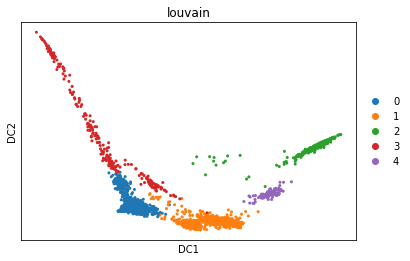

(3251, 2)


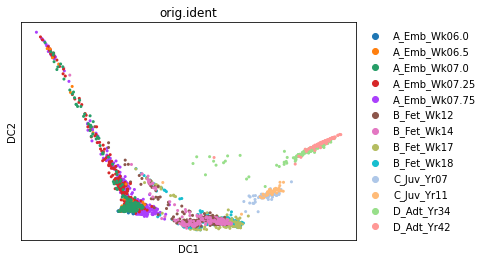

In [4]:
sc.pl.embedding(adata, basis='diffmap', color='louvain')
sc.pl.embedding(adata, basis='diffmap', color='orig.ident')

## Load markers

In [60]:
import glob
emt = pd.read_table('../01_sc_rms/final_annotations/gene_modules/EMT.txt', header=None)
diffmuscle = pd.read_table('../01_sc_rms/final_annotations/gene_modules/Muscle.txt', header=None)
prolif = pd.read_table('../01_sc_rms/final_annotations/gene_modules/Prolif.txt', header=None)
histone = pd.read_table('../01_sc_rms/final_annotations/gene_modules/Histone.txt', header=None)
muscle = pd.read_table('../01_sc_rms/final_annotations/gene_modules/Muscle.txt', header=None)
interferon = pd.read_table('../01_sc_rms/final_annotations/gene_modules/Interferon.txt', header=None)
apoptosis = pd.read_table('../01_sc_rms/final_annotations/gene_modules/Apoptosis.txt', header=None)
upr = pd.read_table('../01_sc_rms/final_annotations/gene_modules/UPR.txt', header=None)

uniq1 = pd.read_table('../01_sc_rms/final_annotations/gene_modules/UNIQUE_1.txt', header=None)
uniq2 = pd.read_table('../01_sc_rms/final_annotations/gene_modules/UNIQUE_2_4.txt', header=None)
uniq3 = pd.read_table('../01_sc_rms/final_annotations/gene_modules/UNIQUE_3.txt', header=None)
uniq5 = pd.read_table('../01_sc_rms/final_annotations/gene_modules/UNIQUE_5.txt', header=None)
uniq6 = pd.read_table('../01_sc_rms/final_annotations/gene_modules/UNIQUE_6.txt', header=None)

erms = np.array(["ITM2A", "FABP5", "EMILIN1", "RRBP1", "CCND1", "EMP3", "EIF4EBP1", "TSTA3", "ADA", "HMGA2"])
arms = np.array(["HSPB2", "MYL4", "PIPOX", "TNNT2", "MYOG", "ENO3", "NRN1", "GYPC", "TSPAN3", "TFF3"])

stages = [pd.read_table(i)
          for i in glob.glob('/PHShome/qq06/projects/02_atlas/normal_muscle_cellbrowser/stages_marker/*gz')]

stages = [s.iloc[:, 0].values for s in stages]

rms_marker = [m.iloc[:, 0].values for m in [emt, diffmuscle, prolif, histone, interferon, apoptosis, 
                                            upr, uniq1, uniq2, uniq3, uniq5, uniq6]] + [np.array(erms)] + [np.array(arms)]

In [61]:
cores = pd.read_table('../01_sc_rms/phaseA_explore_rms/RMS_core_t_test_pval0.05_fold1.5.xls', index_col=0)

FileNotFoundError: [Errno 2] No such file or directory: '../01_sc_rms/phaseA_explore_rms/RMS_core_t_test_pval0.05_fold1.5.xls'

In [62]:
arms_b = (cores.iloc[:, :4].mean(axis=1)-cores.iloc[:, 4:].mean(axis=1))>0

NameError: name 'cores' is not defined

In [6]:
arms_all = cores.index[arms_b].values
erms_all = cores.index[~arms_b].values

In [7]:
arms_all.shape

(93,)

In [8]:
erms_all.shape

(67,)

## New published dataset exploration

In [3]:
smp_sc_meta = pd.read_table('/PHShome/qq06/projects/02_atlas/normal_muscle_cellbrowser/skeletal-muscle/developmental-trajectory/smp-sc/meta.tsv', 
                             header=0, index_col=0)
smp_sc_map = pd.read_table('/PHShome/qq06/projects/02_atlas/normal_muscle_cellbrowser/skeletal-muscle/developmental-trajectory/smp-sc/Diffusion_Map.coords.tsv.gz',
                           header=None)
smp_sc_meta.loc[:, 'age'] = smp_sc_meta.loc[:, 'orig.ident.short'].map(lambda x: x.split('_')[0])
smp_sc = pd.read_table('/PHShome/qq06/projects/02_atlas/normal_muscle_cellbrowser/skeletal-muscle/developmental-trajectory/smp-sc/exprMatrix.tsv.gz',
                       header=0, index_col=0)

def load_adata():
    adata = anndata.AnnData(scipy.sparse.csr_matrix(smp_sc.values).T.toarray(), 
                        var=pd.DataFrame(smp_sc.index, index=smp_sc.index), 
                        obs=smp_sc_meta)
    adata.obsm['X_diffmap_orig'] = smp_sc_map.iloc[:, 1:].values
    adata.obsm['X_diffmap'] = smp_sc_map.iloc[:, 1:].values
    
    return adata

In [55]:
# adata = load_adata()
# sns.set('poster')
# sns.set_style('white')
# stages = pd.DataFrame({'DC1': adata.obsm['X_diffmap_orig'][:, 0], 
#               'DC2': adata.obsm['X_diffmap_orig'][:, 1],
#               'Stage': adata.obs.loc[:, 'Dev.Stage']})
# g = sns.scatterplot(x='DC1', y='DC2', data=stages, hue='Stage', legend='brief', s=20)
# sns.despine()
# g.legend(loc='center left', bbox_to_anchor=(1.25, 0.5), ncol=3)

# fig, ax = plt.subplots()
# sns.set('poster')
# sns.set_style('white')
# stages = pd.DataFrame({'DC1': adata.obsm['X_diffmap_orig'][:, 0], 
#               'DC2': adata.obsm['X_diffmap_orig'][:, 1],
#               'Age': adata.obs.loc[:, 'age']})
# g = sns.scatterplot(x='DC1', y='DC2', data=stages, hue='Age', legend='brief', s=20, ax=ax)
# sns.despine()
# g.legend(loc='center left', bbox_to_anchor=(1.25, 0.5), ncol=3)
# #ax.legend(bbox_to_anchor=(1.01, 1), loc=2, borderaxespad=0.)

In [56]:
# fig = plt.figure(figsize=(11, 12))
# sns.heatmap(pd.crosstab(adata.obs.age, adata.obs.loc[:, 'Dev.Stage']), 
#             annot=True)

... storing 'orig.ident' as categorical
... storing 'Phase' as categorical
... storing 'Dev.Stage' as categorical
... storing 'orig.ident.short' as categorical
... storing 'age' as categorical


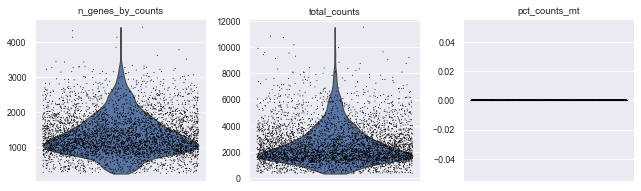

In [301]:
adata = load_adata()
sns.set('paper')
adata.var['mt'] = adata.var_names.str.startswith('MT-')  # annotate the group of mitochondrial genes as 'mt'
sc.pp.calculate_qc_metrics(adata, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)
sc.pl.violin(adata, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt'],
             jitter=0.4, multi_panel=True)
adata = load_adata()
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)

sc.pp.highly_variable_genes(adata, n_top_genes=1000)
adata.raw = adata
# adata.write('5stages_normal.h5ad')
# adata = adata[:, adata.var.highly_variable]
# sc.pp.scale(adata, max_value=10)
# sc.tl.pca(adata, n_comps=30)

# sc.pp.neighbors(adata, n_neighbors=30, n_pcs=30, use_rep='X_pca')
# sc.tl.umap(adata)

# sc.tl.diffmap(adata, n_comps=15)
# sc.pp.neighbors(adata, n_neighbors=10, n_pcs=10, use_rep='X_diffmap')
# sc.tl.louvain(adata, resolution=0.05)

(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)


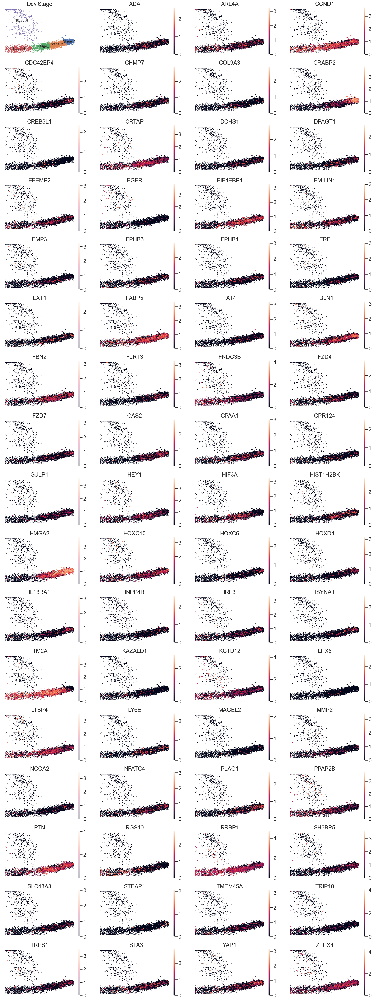

In [247]:
sns.set_context("poster", rc={"font.size": 14})        

sc.pl.embedding(adata, basis='diffmap_orig', color=['Dev.Stage']+\
                list(erms_all[np.in1d(erms_all, adata.var_names)]),
                frameon=False, ncols=4, use_raw=True, legend_loc='on data', save='all_ERMS_stages.pdf')

(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)


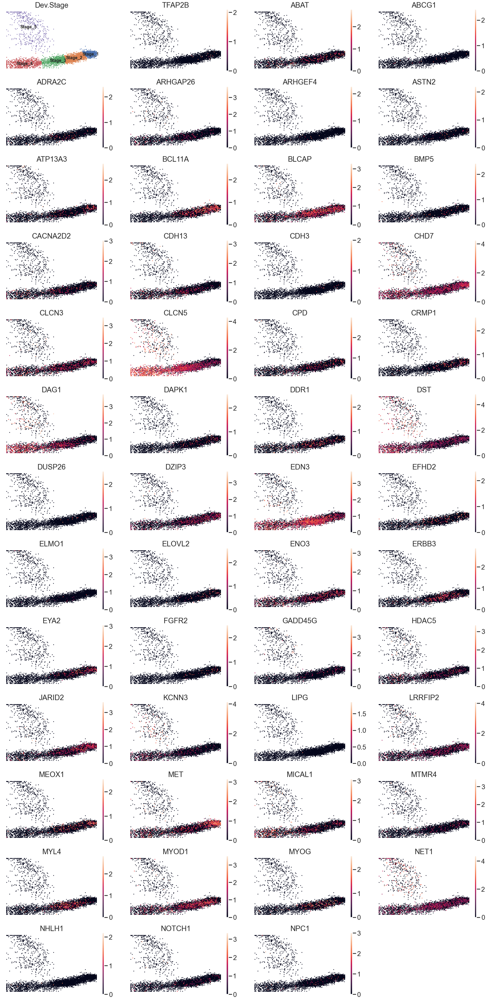

In [249]:
sns.set_context("poster", rc={"font.size": 14})        

sc.pl.embedding(adata, basis='diffmap_orig', color=['Dev.Stage']+\
                list(arms_all[np.in1d(arms_all, adata.var_names)])[:50],
                frameon=False, ncols=4, use_raw=True, legend_loc='on data', save='all_ARMS_stages_1.pdf')

(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)


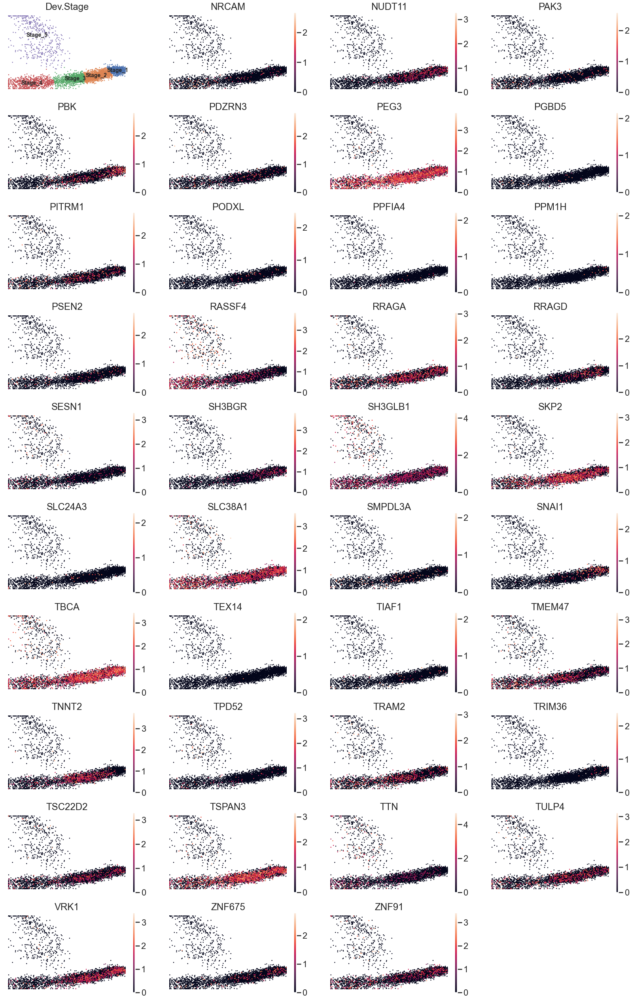

In [250]:
sns.set_context("poster", rc={"font.size": 14})        

sc.pl.embedding(adata, basis='diffmap_orig', color=['Dev.Stage']+\
                list(arms_all[np.in1d(arms_all, adata.var_names)])[50:],
                frameon=False, ncols=4, use_raw=True, legend_loc='on data', save='all_ARMS_stages_2.pdf')

(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)


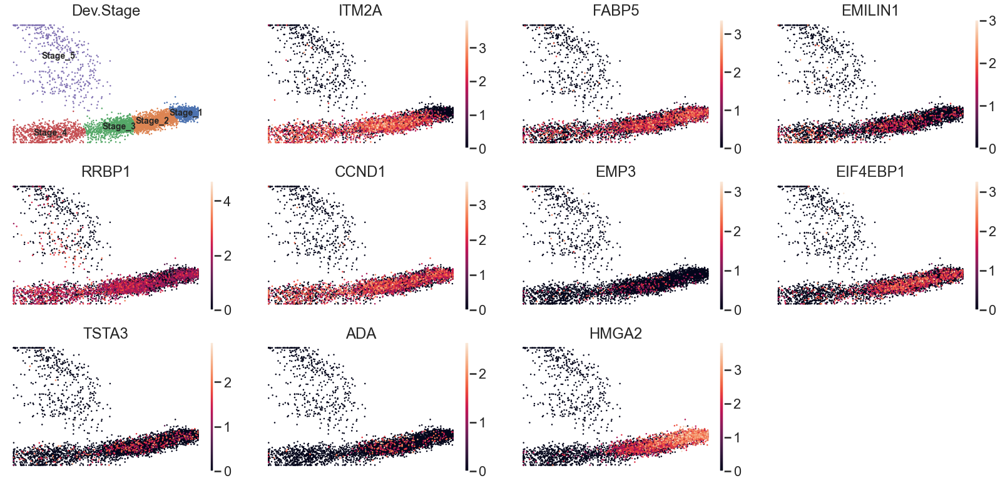

In [251]:
sns.set_context("poster", rc={"font.size": 14})        

sc.pl.embedding(adata, basis='diffmap_orig', color=['Dev.Stage']+\
                list(erms),
                frameon=False, ncols=4, use_raw=True, legend_loc='on data')

(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)


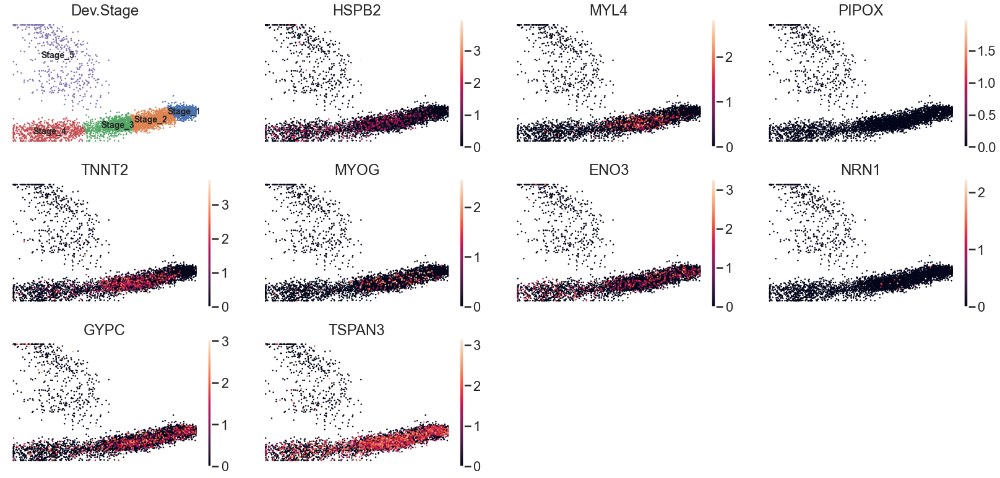

In [252]:
sns.set_context("poster", rc={"font.size": 14})        

sc.pl.embedding(adata, basis='diffmap_orig', color=['Dev.Stage']+\
                list(arms[np.in1d(arms, adata.var_names)]),
                frameon=False, ncols=4, use_raw=True, legend_loc='on data')

(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)


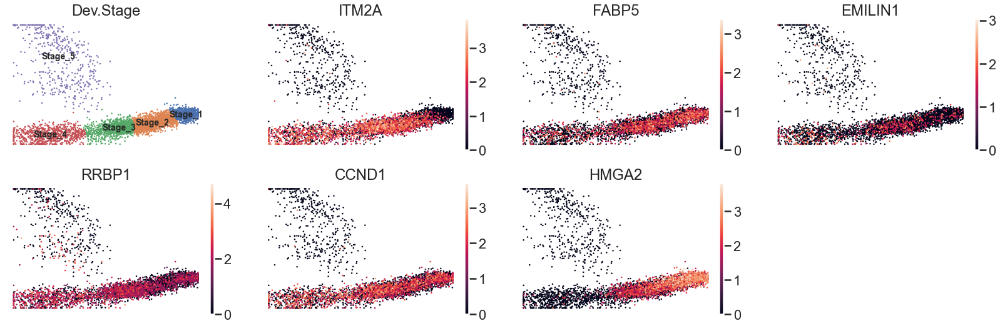

In [253]:
sns.set_context("poster", rc={"font.size": 14})        

sc.pl.embedding(adata, basis='diffmap_orig', color=['Dev.Stage']+\
                list(erms[[0,1,2,3,4,9]]),
                frameon=False, ncols=4, use_raw=True, legend_loc='on data')

(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)


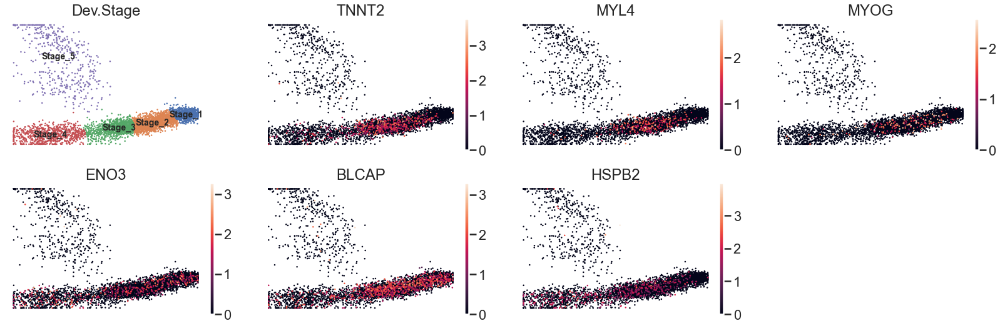

In [254]:
adata.obs['ARMS_all_score'] = adata[:, arms_all[np.in1d(arms_all, adata.var_names)]].X.toarray().mean(axis=1)
adata.obs['ERMS_all_score'] = adata[:, erms_all[np.in1d(erms_all, adata.var_names)]].X.toarray().mean(axis=1)

adata.obs['ARMS_core_score'] = adata[:, arms[np.in1d(arms, adata.var_names)]].X.toarray().mean(axis=1)
adata.obs['ERMS_core_score'] = adata[:, erms[np.in1d(erms, adata.var_names)]].X.toarray().mean(axis=1)

sns.set_context("poster", rc={"font.size": 14})        

sc.pl.embedding(adata, basis='diffmap_orig', color=['Dev.Stage']+\
                ['TNNT2', 'MYL4', 'MYOG', 'ENO3', 'BLCAP', 'HSPB2'], 
                frameon=False, ncols=4, use_raw=True, legend_loc='on data')

(4717, 2)
(4717, 2)
(4717, 2)
(4717, 2)


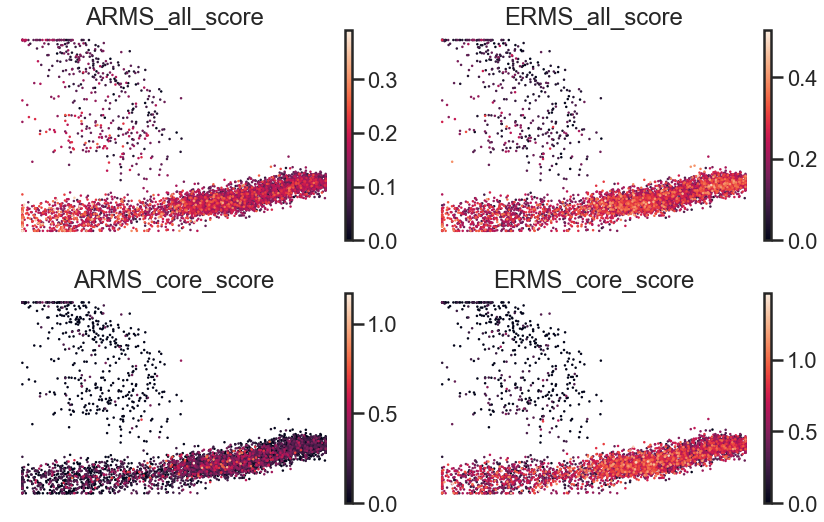

In [270]:

sns.set_context("poster", rc={"font.size": 14})        

sc.pl.embedding(adata, basis='diffmap_orig', color=['ARMS_all_score', 'ERMS_all_score', 
                                                    'ARMS_core_score', 'ERMS_core_score'],
                frameon=False, use_raw=True, ncols=2, legend_loc='on data', 
                save='core_arms_erms_average_score.pdf')

... storing 'orig.ident' as categorical
... storing 'Phase' as categorical
... storing 'Dev.Stage' as categorical
... storing 'orig.ident.short' as categorical
... storing 'age' as categorical


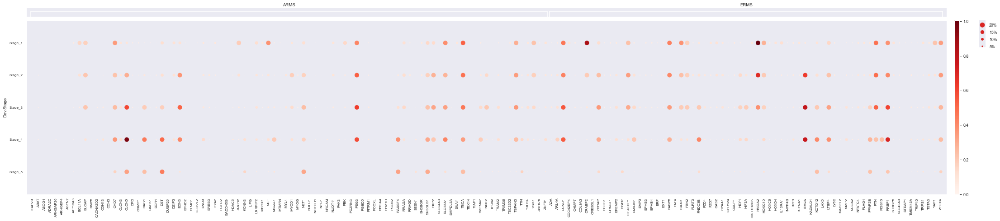

GridSpec(2, 5, height_ratios=[0.5, 10], width_ratios=[37.05, 0, 0.2, 0.5, 0.25])

In [302]:
sc.pl.dotplot(adata, {"ARMS": arms_all[np.in1d(arms_all, adata.var_names)], 
                      'ERMS': erms_all[np.in1d(erms_all, adata.var_names)]}, 
              groupby='Dev.Stage', dot_min=0, dot_max=0.2, figsize=[38, 7.6],
              save='core_arms_erms_dot.pdf',
              log=True)

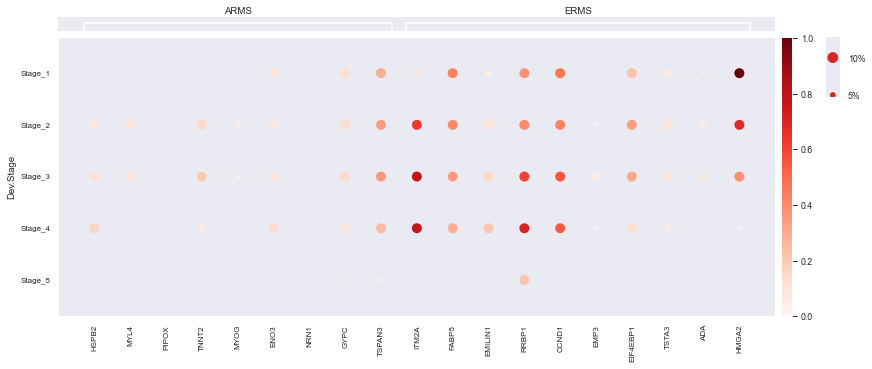

GridSpec(2, 5, height_ratios=[0.5, 10], width_ratios=[13.05, 0, 0.2, 0.5, 0.25])

In [277]:
sns.set('paper')
sc.pl.dotplot(adata, {"ARMS": arms[np.in1d(arms, adata.var_names)], 
                      'ERMS': erms[np.in1d(erms, adata.var_names)]}, 
              groupby='Dev.Stage', dot_min=0, dot_max=0.1, figsize=[14, 5.5], expression_cutoff=0.1,
              save='10_core_arms_erms_dot.pdf',
              log=True)

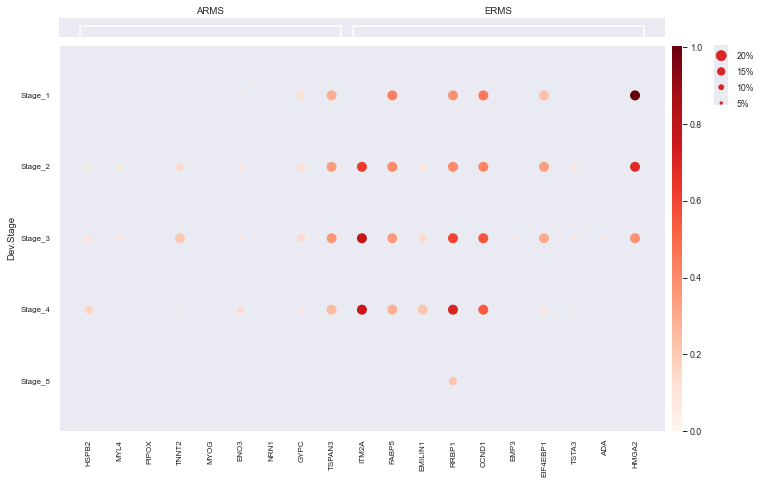

GridSpec(2, 5, height_ratios=[0.5, 10], width_ratios=[11.05, 0, 0.2, 0.5, 0.25])

In [278]:
sc.pl.dotplot(adata, {"ARMS": arms[np.in1d(arms, adata.var_names)], 'ERMS': erms}, 
              groupby='Dev.Stage', dot_min=0, dot_max=0.2, figsize=[12, 7.6], 
              log=True)

In [783]:
adata = load_adata()

In [784]:
mast118 = scv.read('MAST118.loom.h5ad')

In [785]:
mast111 = scv.read('MAST111.loom.h5ad')

In [786]:
from scanorama import correct_scanpy

In [788]:
integrated, corrected = correct_scanpy([adata, mast118], return_dimred=True)

Found 13367 genes among all datasets
[[0.           0.1985210466]
 [0.           0.          ]]
Processing datasets (0, 1)


In [793]:
corrected[0].obs.head()

""
0
1
2
3
4


## Stage DE genes vs RMS Signatures

In [289]:
import glob

emt = pd.read_table('../01_sc_rms/final_annotations/gene_modules/EMT.txt', header=None)
diffmuscle = pd.read_table('../01_sc_rms/final_annotations/gene_modules/Muscle.txt', header=None)
prolif = pd.read_table('../01_sc_rms/final_annotations/gene_modules/Prolif.txt', header=None)
histone = pd.read_table('../01_sc_rms/final_annotations/gene_modules/Histone.txt', header=None)
muscle = pd.read_table('../01_sc_rms/final_annotations/gene_modules/Muscle.txt', header=None)
interferon = pd.read_table('../01_sc_rms/final_annotations/gene_modules/Interferon.txt', header=None)
apoptosis = pd.read_table('../01_sc_rms/final_annotations/gene_modules/Apoptosis.txt', header=None)
upr = pd.read_table('../01_sc_rms/final_annotations/gene_modules/UPR.txt', header=None)

uniq1 = pd.read_table('../01_sc_rms/final_annotations/gene_modules/UNIQUE_1.txt', header=None)
uniq2 = pd.read_table('../01_sc_rms/final_annotations/gene_modules/UNIQUE_2_4.txt', header=None)
uniq3 = pd.read_table('../01_sc_rms/final_annotations/gene_modules/UNIQUE_3.txt', header=None)
uniq5 = pd.read_table('../01_sc_rms/final_annotations/gene_modules/UNIQUE_5.txt', header=None)
uniq6 = pd.read_table('../01_sc_rms/final_annotations/gene_modules/UNIQUE_6.txt', header=None)

erms = np.array(["ITM2A", "FABP5", "EMILIN1", "RRBP1", "CCND1", "EMP3", "EIF4EBP1", "TSTA3", "ADA", "HMGA2"])
arms = np.array(["HSPB2", "MYL4", "PIPOX", "TNNT2", "MYOG", "ENO3", "NRN1", "GYPC", "TSPAN3", "TFF3"])

stages = [pd.read_table(i)
          for i in glob.glob('/PHShome/qq06/projects/02_atlas/normal_muscle_cellbrowser/stages_marker/*gz')]
stages = [s.iloc[:, 0].values for s in stages]
rms_marker = [m.iloc[:, 0].values for m in [emt, diffmuscle, prolif, histone, interferon, apoptosis, 
                                            upr, uniq1, uniq2, uniq3, uniq5, uniq6]] + [np.array(erms)] + [np.array(arms)]
stage_rms = pd.DataFrame(np.zeros((5, 14)), index=['Stage%s' % i for i in range(1, 6)],
                         columns=['EMT', 'DiffMuscle', 'Prolif', 'Histone', 
                                   'Interferon', 'Apoptosis', 'UPR', 
                                  'Unique1', 'Unique2', 'Unique3', 'Unique5', 'Unique6',
                                  'ERMS', 'ARMS'])
stage_rms_p = pd.DataFrame(np.zeros((5, 14)), index=['Stage%s' % i for i in range(1, 6)],
                         columns=['EMT', 'DiffMuscle', 'Prolif', 'Histone', 
                                   'Interferon', 'Apoptosis', 'UPR', 
                                  'Unique1', 'Unique2', 'Unique3', 'Unique5', 'Unique6', 
                                   'ERMS', 'ARMS'])

from functools import reduce
allstages = reduce(np.union1d, stages)
allrms = reduce(np.union1d, rms_marker)

In [290]:
len(allstages), len(allrms), len(rms_marker)

(433, 771, 14)

In [291]:
for inx, i in zip(range(5), stages):
    for ind, j in zip(range(15), rms_marker):
        stage_rms.iloc[inx, ind] = np.intersect1d(i, j).shape[0]   
        
        non_j = np.setdiff1d(allrms, j)
        non_i = np.setdiff1d(allstages, i)
        
        cell1 = np.intersect1d(i, j).shape[0]
        cell2 = np.intersect1d(i, non_j).shape[0]
        
        cell3 = np.intersect1d(non_i, j).shape[0]       
        cell4 = np.intersect1d(non_i, non_j).shape[0]
        
        tab = [[cell1, cell2], [cell3, cell4]]
        print(stage_rms.index[inx], stage_rms.columns[ind], tab)
        stage_rms_p.iloc[inx, ind] = scipy.stats.fisher_exact(tab, alternative='greater')[1]

Stage1 EMT [[5, 24], [34, 43]]
Stage1 DiffMuscle [[1, 28], [7, 70]]
Stage1 Prolif [[12, 17], [5, 72]]
Stage1 Histone [[1, 28], [2, 75]]
Stage1 Interferon [[0, 29], [2, 75]]
Stage1 Apoptosis [[2, 27], [7, 70]]
Stage1 UPR [[0, 29], [0, 77]]
Stage1 Unique1 [[2, 27], [12, 65]]
Stage1 Unique2 [[0, 29], [7, 70]]
Stage1 Unique3 [[3, 26], [3, 74]]
Stage1 Unique5 [[0, 29], [2, 75]]
Stage1 Unique6 [[2, 27], [5, 72]]
Stage1 ERMS [[1, 28], [1, 76]]
Stage1 ARMS [[0, 29], [1, 76]]
Stage2 EMT [[6, 25], [33, 42]]
Stage2 DiffMuscle [[4, 27], [4, 71]]
Stage2 Prolif [[6, 25], [11, 64]]
Stage2 Histone [[3, 28], [0, 75]]
Stage2 Interferon [[2, 29], [0, 75]]
Stage2 Apoptosis [[1, 30], [8, 67]]
Stage2 UPR [[0, 31], [0, 75]]
Stage2 Unique1 [[6, 25], [8, 67]]
Stage2 Unique2 [[1, 30], [6, 69]]
Stage2 Unique3 [[2, 29], [4, 71]]
Stage2 Unique5 [[2, 29], [0, 75]]
Stage2 Unique6 [[2, 29], [5, 70]]
Stage2 ERMS [[1, 30], [1, 74]]
Stage2 ARMS [[0, 31], [1, 74]]
Stage3 EMT [[9, 11], [30, 56]]
Stage3 DiffMuscle [[3, 17]

In [292]:
scipy.stats.fisher_exact([[50, 1], [1, 3]], alternative='less')

(150.0, 0.999997067921598)

In [293]:
scipy.stats.fisher_exact([[1, 9], [11, 3]])

(0.030303030303030304, 0.0027594561852200745)

In [294]:
scipy.stats.fisher_exact([[60, 10], [12, 2]], alternative='greater')

(1.0, 0.6377409845161974)

In [295]:
stage_rms_p

,EMT,DiffMuscle,Prolif,Histone,Interferon,Apoptosis,UPR,Unique1,Unique2,Unique3,Unique5,Unique6,ERMS,ARMS
Stage1,9.981452e-01,0.930227,0.000058,0.620827,1.000000,0.765051,1.0,0.941646,1.000000,0.203062,1.000000,0.619183,0.474214,1.000000
Stage2,9.965226e-01,0.172312,0.370086,0.023300,0.083558,0.961754,1.0,0.185767,0.918555,0.568323,0.083558,0.662415,0.501348,1.000000
Stage3,2.756136e-01,0.171516,1.000000,1.000000,1.000000,0.225921,1.0,1.000000,0.022811,0.724395,1.000000,0.122149,0.343217,0.188679
Stage4,1.547003e-07,0.937476,1.000000,1.000000,1.000000,1.000000,1.0,0.355080,0.311397,0.871846,1.000000,0.910292,1.000000,1.000000
Stage5,3.244639e-01,0.662307,1.000000,1.000000,0.231267,0.078916,1.0,0.233110,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


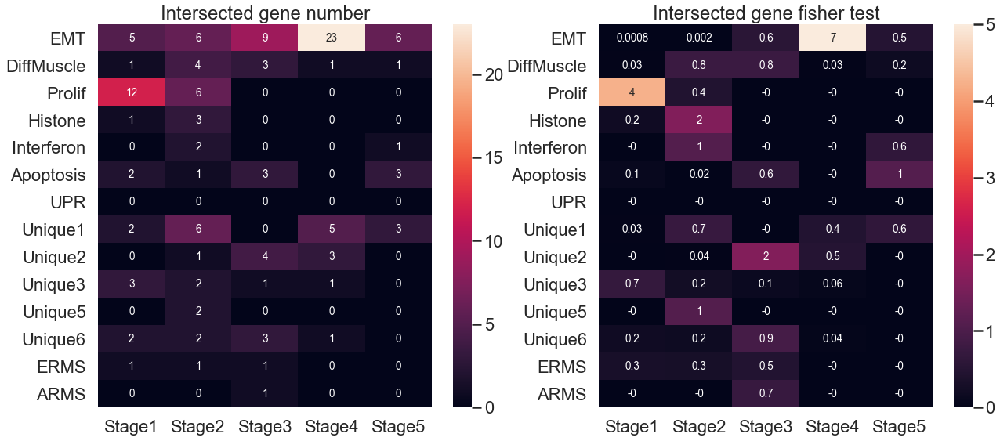

In [501]:
sns.set_context("poster", rc={"font.size": 13.5})        
sns.set_style("white")
fig, ax = plt.subplots(1, 2)
fig.set_size_inches(21, 9)
sns.heatmap(stage_rms.T, annot=True, ax=ax[0], square=False)
ax[0].set_title('Intersected gene number')
sns.heatmap(-np.log10(stage_rms_p).T, annot=True, vmin=0, vmax=5, fmt='.1g', ax=ax[1], square=False)
ax[1].set_title('Intersected gene fisher test')
plt.savefig('Fig2_stage_rms.pdf')

## Normal muscle state vs RMS Signatures

In [115]:
smp_sc_map = pd.read_table('/PHShome/qq06/projects/02_atlas/normal_muscle_cellbrowser/skeletal-muscle/fetal/fetal-wk9-myogenic/Seurat_tsne.coords.tsv.gz',
                           header=None)
smp_sc = pd.read_table('/PHShome/qq06/projects/02_atlas/normal_muscle_cellbrowser/skeletal-muscle/fetal/fetal-wk9-myogenic/exprMatrix.tsv.gz',
                       header=0, index_col=0)
smp_sc_meta = pd.read_table('/PHShome/qq06/projects/02_atlas/normal_muscle_cellbrowser/skeletal-muscle/fetal/fetal-wk9-myogenic/meta.tsv', 
                             header=0, index_col=0)
smp_sc_meta.loc[:, 'age'] = smp_sc_meta.loc[:, 'orig.ident.short'].map(lambda x: x.split('_')[0])

normal_muscle_marker = [pd.read_table('/PHShome/qq06/projects/02_atlas/normal_muscle_cellbrowser/skeletal-muscle/fetal/fetal-wk9-myogenic/%s.tsv.gz' % c.replace('.', '')) for c in np.unique(smp_sc_meta.loc[:, 'Cell.Type'])]
normal_muscle_marker = [s.iloc[:, 0].values for s in normal_muscle_marker]

In [118]:
state_rms = pd.DataFrame(np.zeros((4, 14)), index=np.unique(smp_sc_meta.loc[:, 'Cell.Type']),
                         columns=['EMT', 'DiffMuscle', 'Prolif', 'Histone', 
                                   'Interferon', 'Apoptosis', 'UPR', 
                                  'Unique1', 'Unique2', 'Unique3', 'Unique5', 'Unique6',
                                  'ERMS', 'ARMS'])
state_rms_p = pd.DataFrame(np.zeros((4, 14)), index=np.unique(smp_sc_meta.loc[:, 'Cell.Type']),
                         columns=['EMT', 'DiffMuscle', 'Prolif', 'Histone', 
                                   'Interferon', 'Apoptosis', 'UPR', 
                                  'Unique1', 'Unique2', 'Unique3', 'Unique5', 'Unique6', 
                                   'ERMS', 'ARMS'])
from functools import reduce
allstates = reduce(np.union1d, normal_muscle_marker)
allrms = reduce(np.union1d, rms_marker)

geneset_dict = {}

for inx, i in zip(range(4), normal_muscle_marker):
    for ind, j in zip(range(15), rms_marker):
        state_rms.iloc[inx, ind] = np.intersect1d(i, j).shape[0]   
        
        geneset_dict[np.unique(smp_sc_meta.loc[:, 'Cell.Type'])[inx]+"_"+state_rms_p.columns[ind]] = np.intersect1d(i, j)
        
        non_j = np.setdiff1d(allrms, j)
        non_i = np.setdiff1d(allstates, i)
        
        cell1 = np.intersect1d(i, j).shape[0]
        cell2 = np.intersect1d(i, non_j).shape[0]
        
        cell3 = np.intersect1d(non_i, j).shape[0]       
        cell4 = np.intersect1d(non_i, non_j).shape[0]
        
        tab = [[cell1, cell2], [cell3, cell4]]
        print(state_rms.index[inx], state_rms.columns[ind], tab)
        state_rms_p.iloc[inx, ind] = scipy.stats.fisher_exact(tab, alternative='greater')[1]

MB EMT [[5, 39], [40, 23]]
MB DiffMuscle [[30, 14], [4, 59]]
MB Prolif [[2, 42], [3, 60]]
MB Histone [[1, 43], [2, 61]]
MB Interferon [[1, 43], [3, 60]]
MB Apoptosis [[1, 43], [0, 63]]
MB UPR [[0, 44], [1, 62]]
MB Unique1 [[2, 42], [5, 58]]
MB Unique2 [[1, 43], [4, 59]]
MB Unique3 [[0, 44], [2, 61]]
MB Unique5 [[1, 43], [3, 60]]
MB Unique6 [[1, 43], [6, 57]]
MB ERMS [[0, 44], [0, 63]]
MB ARMS [[5, 39], [0, 63]]
MC EMT [[1, 6], [44, 56]]
MC DiffMuscle [[3, 4], [31, 69]]
MC Prolif [[1, 6], [4, 96]]
MC Histone [[0, 7], [3, 97]]
MC Interferon [[0, 7], [4, 96]]
MC Apoptosis [[0, 7], [1, 99]]
MC UPR [[1, 6], [0, 100]]
MC Unique1 [[1, 6], [6, 94]]
MC Unique2 [[0, 7], [5, 95]]
MC Unique3 [[0, 7], [2, 98]]
MC Unique5 [[0, 7], [4, 96]]
MC Unique6 [[0, 7], [7, 93]]
MC ERMS [[0, 7], [0, 100]]
MC ARMS [[0, 7], [5, 95]]
MP EMT [[13, 12], [32, 50]]
MP DiffMuscle [[1, 24], [33, 49]]
MP Prolif [[1, 24], [4, 78]]
MP Histone [[2, 23], [1, 81]]
MP Interferon [[1, 24], [3, 79]]
MP Apoptosis [[0, 25], [1, 8

In [119]:
geneset_dict

{'MB_EMT': array(['COL12A1', 'CRABP2', 'IL11RA', 'THY1', 'TNMD'], dtype=object),
 'MB_DiffMuscle': array(['ACTC1', 'ACTN2', 'BIN1', 'BLCAP', 'CHRNA1', 'CHRND', 'COBL',
        'CYB5R1', 'FNDC5', 'KLHL41', 'KREMEN2', 'LINC00948', 'MEF2C',
        'MYL4', 'MYLPF', 'MYOG', 'NEB', 'NES', 'NEXN', 'PLS3', 'RASSF4',
        'SCRIB', 'SEPT4', 'SEPW1', 'SHD', 'STAC3', 'TNNI1', 'TNNT2',
        'TSPAN33', 'ZNF106'], dtype=object),
 'MB_Prolif': array(['CDC25B', 'CENPU'], dtype=object),
 'MB_Histone': array(['HIST1H1C'], dtype=object),
 'MB_Interferon': array(['USP18'], dtype=object),
 'MB_Apoptosis': array(['GADD45G'], dtype=object),
 'MB_UPR': array([], dtype=object),
 'MB_Unique1': array(['CHRNA1', 'FAM178A'], dtype=object),
 'MB_Unique2': array(['KAT6B'], dtype=object),
 'MB_Unique3': array([], dtype=object),
 'MB_Unique5': array(['USP18'], dtype=object),
 'MB_Unique6': array(['KAT6B'], dtype=object),
 'MB_ERMS': array([], dtype=object),
 'MB_ARMS': array(['ENO3', 'HSPB2', 'MYL4', 'MYOG', 'TN

In [120]:
np.setdiff1d(geneset_dict['SkM.Mesen_EMT'], geneset_dict['MP_EMT'])

array(['CCDC80', 'COL11A1', 'COL12A1', 'COL1A2', 'COL3A1', 'COL5A1',
       'COL5A2', 'CRABP2', 'DCN', 'FIBIN', 'IL11RA', 'ITM2C', 'LGALS1',
       'LUM', 'MAP1B', 'MGP', 'NEFM', 'NOV', 'NUPR1', 'OGN', 'PCOLCE',
       'PLAC9', 'POSTN', 'PPAP2B', 'PTN', 'PTRF', 'SFRP2', 'SPARC',
       'TGFBI', 'THY1', 'TIMP1', 'TSHZ2'], dtype=object)

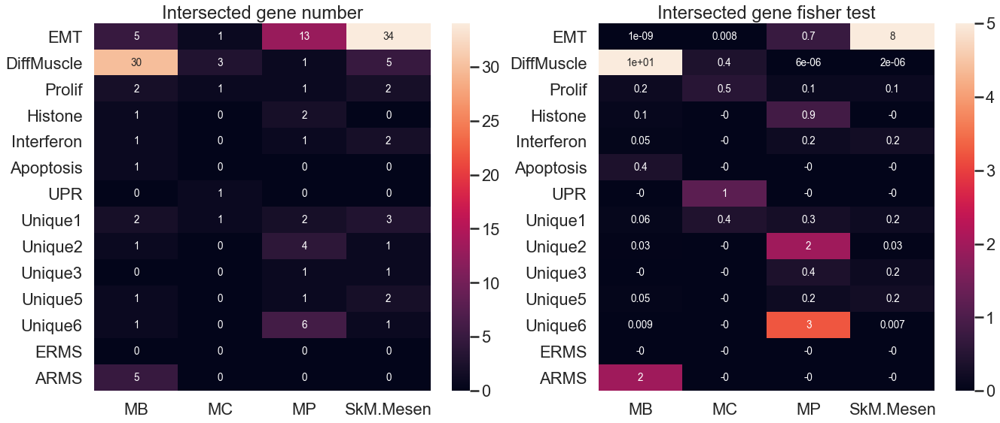

In [117]:
sns.set_context("poster", rc={"font.size": 13.5})        
sns.set_style("white")
fig, ax = plt.subplots(1, 2)
fig.set_size_inches(22, 9)
sns.heatmap(state_rms.T, annot=True, ax=ax[0], square=False)
ax[0].set_title('Intersected gene number')
sns.heatmap(-np.log10(state_rms_p).T, annot=True, vmin=0, vmax=5, fmt='.1g', ax=ax[1], square=False)
ax[1].set_title('Intersected gene fisher test')
plt.savefig('Fig4_state_rms.pdf')

#Skm -> EMT, MC->Muscle, MP->Prolif, MB->Ground

In [25]:
!ls /PHShome/qq06/projects/02_atlas/normal_muscle_cellbrowser/skeletal-muscle/embryonic/embryonic-wk5-6-myogenic/meta.tsv

/PHShome/qq06/projects/02_atlas/normal_muscle_cellbrowser/skeletal-muscle/embryonic/embryonic-wk5-6-myogenic/meta.tsv


/PHShome/qq06/projects/02_atlas/normal_muscle_cellbrowser/skeletal-muscle/embryonic/embryonic-wk5-6-myogenic/meta.tsv
/PHShome/qq06/projects/02_atlas/normal_muscle_cellbrowser/skeletal-muscle/embryonic/embryonic-wk5-6-myogenic/meta.tsv
/PHShome/qq06/projects/02_atlas/normal_muscle_cellbrowser/skeletal-muscle/embryonic/embryonic-wk6-7-myogenic/meta.tsv
/PHShome/qq06/projects/02_atlas/normal_muscle_cellbrowser/skeletal-muscle/embryonic/embryonic-wk6-7-myogenic/meta.tsv
/PHShome/qq06/projects/02_atlas/normal_muscle_cellbrowser/skeletal-muscle/embryonic/embryonic-wk7-8-myogenic/meta.tsv
['COL12A1' 'COL4A2' 'IL11RA' 'SERPINH1']
/PHShome/qq06/projects/02_atlas/normal_muscle_cellbrowser/skeletal-muscle/fetal/fetal-wk9-myogenic/meta.tsv
['CCDC80' 'COL11A1' 'COL12A1' 'COL1A2' 'COL3A1' 'COL5A1' 'COL5A2' 'CRABP2'
 'DCN' 'FIBIN' 'IL11RA' 'ITM2C' 'LGALS1' 'LUM' 'MAP1B' 'MGP' 'NEFM' 'NOV'
 'NUPR1' 'OGN' 'PCOLCE' 'PLAC9' 'POSTN' 'PPAP2B' 'PTN' 'PTRF' 'SFRP2'
 'SPARC' 'TGFBI' 'THY1' 'TIMP1' 'TSHZ2']
/

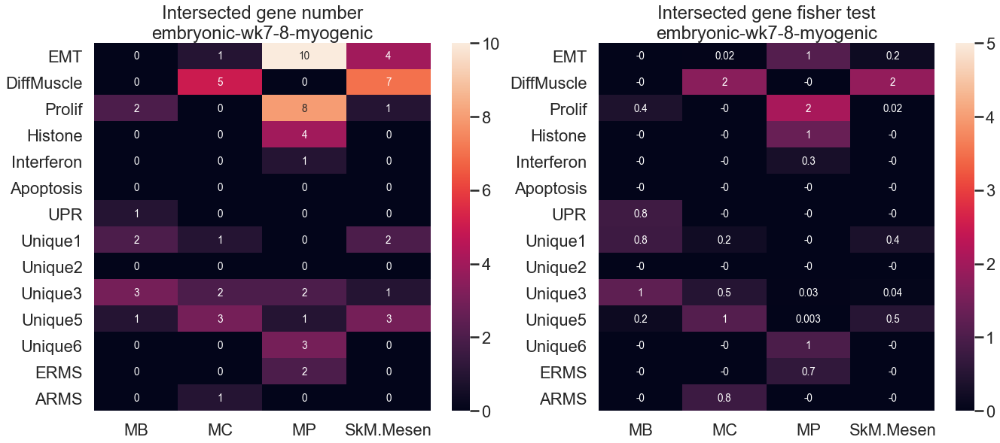

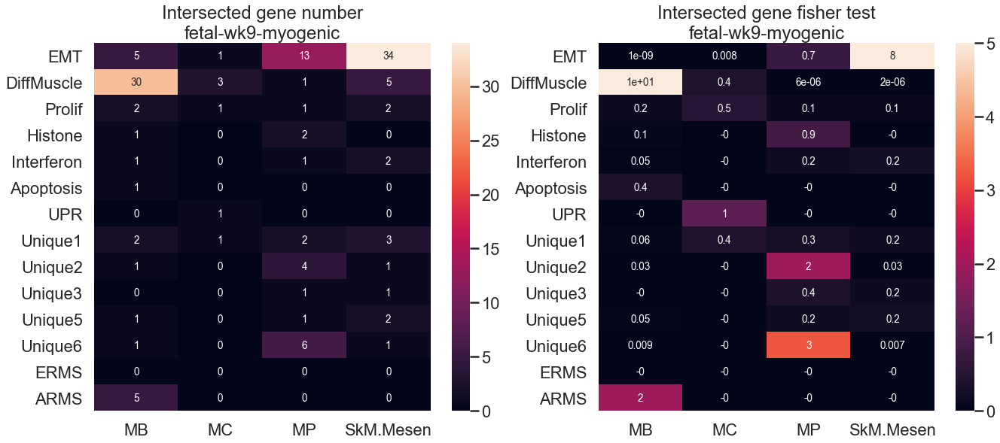

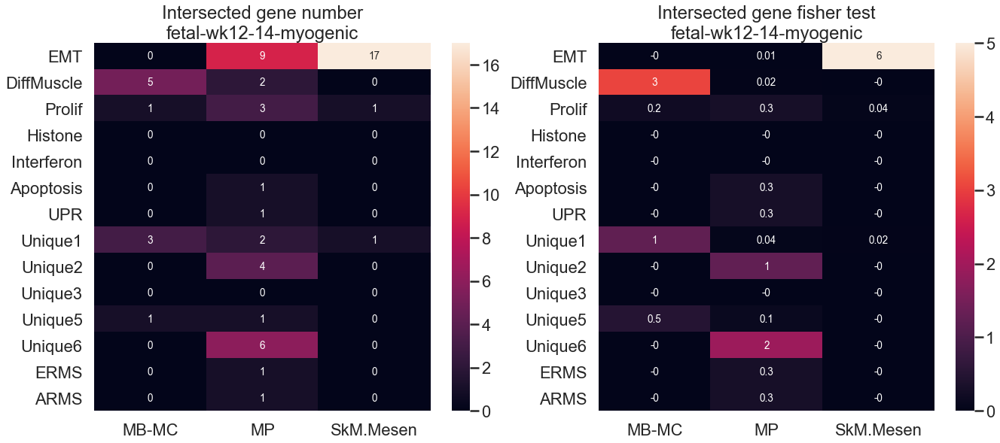

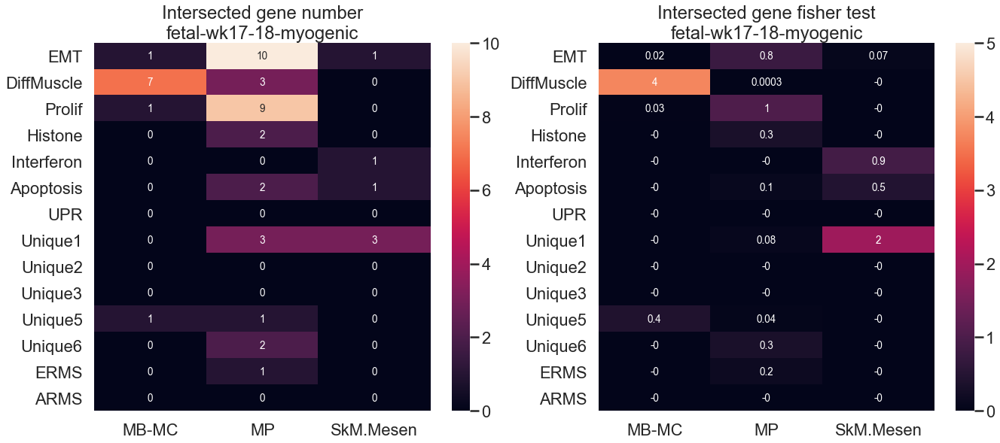

In [126]:
import os

state_rms_p_tmps = []
for m in glob.glob('/PHShome/qq06/projects/02_atlas/normal_muscle_cellbrowser/skeletal-muscle/*/*myogenic/meta.tsv')[:6]:
    try:
        smp_sc_meta = pd.read_table(m, header=0, index_col=0)
        print(m)
        dirs = os.path.dirname(m)
        label = os.path.basename(dirs)
        normal_muscle_marker = [pd.read_table('%s/%s.tsv.gz' % (dirs, c.replace('.', '').replace('-', ''))) 
                                for c in np.unique(smp_sc_meta.loc[:, 'Cell.Type'])]
        normal_muscle_marker = [s.iloc[:, 0].values for s in normal_muscle_marker]  
        state_rms = pd.DataFrame(np.zeros((np.unique(smp_sc_meta.loc[:, 'Cell.Type']).shape[0], 14)), index=np.unique(smp_sc_meta.loc[:, 'Cell.Type']),
                                 columns=['EMT', 'DiffMuscle', 'Prolif', 'Histone', 
                                           'Interferon', 'Apoptosis', 'UPR', 
                                          'Unique1', 'Unique2', 'Unique3', 'Unique5', 'Unique6',
                                          'ERMS', 'ARMS'])
        state_rms_p = pd.DataFrame(np.zeros((np.unique(smp_sc_meta.loc[:, 'Cell.Type']).shape[0], 14)), index=np.unique(smp_sc_meta.loc[:, 'Cell.Type']),
                                 columns=['EMT', 'DiffMuscle', 'Prolif', 'Histone', 
                                           'Interferon', 'Apoptosis', 'UPR', 
                                          'Unique1', 'Unique2', 'Unique3', 'Unique5', 'Unique6', 
                                           'ERMS', 'ARMS'])
        from functools import reduce
        allstates = reduce(np.union1d, normal_muscle_marker)
        allrms = reduce(np.union1d, rms_marker)        
        geneset_dict = {}
        
        for inx, i in zip(range(4), normal_muscle_marker):
            for ind, j in zip(range(15), rms_marker):
                state_rms.iloc[inx, ind] = np.intersect1d(i, j).shape[0]   
                non_j = np.setdiff1d(allrms, j)
                non_i = np.setdiff1d(allstates, i)

                cell1 = np.intersect1d(i, j).shape[0]
                cell2 = np.intersect1d(i, non_j).shape[0]

                cell3 = np.intersect1d(non_i, j).shape[0]       
                cell4 = np.intersect1d(non_i, non_j).shape[0]

                tab = [[cell1, cell2], [cell3, cell4]]
                #print(state_rms.index[inx], state_rms.columns[ind], tab)
                state_rms_p.iloc[inx, ind] = scipy.stats.fisher_exact(tab, alternative='greater')[1]                   
                geneset_dict[np.unique(smp_sc_meta.loc[:, 'Cell.Type'])[inx]+"_"+state_rms_p.columns[ind]] =\
                    np.intersect1d(i, j)  

        print(np.setdiff1d(geneset_dict['SkM.Mesen_EMT'], geneset_dict['MP_EMT']))
        state_rms_p_tmp = pd.melt(state_rms_p)
        state_rms_p_tmp.loc[:, 'age'] = label
        state_rms_p_tmps.append(state_rms_p_tmp)        
        sns.set_context("poster", rc={"font.size": 13.5})        
        sns.set_style("white")
        fig, ax = plt.subplots(1, 2)
        fig.set_size_inches(22, 9)
        sns.heatmap(state_rms.T, annot=True, ax=ax[0], square=False)
        ax[0].set_title('Intersected gene number\n%s' % label)
        sns.heatmap(-np.log10(state_rms_p).T, annot=True, vmin=0, vmax=5, fmt='.1g', ax=ax[1], square=False)
        ax[1].set_title('Intersected gene fisher test\n%s' % label)
        plt.savefig('Fig4_state_rms%s.pdf' % label)                        
    except:
        print(m)

In [27]:
!ls /PHShome/qq06/projects/02_atlas/normal_muscle_cellbrowser/skeletal-muscle/embryonic

embryonic-wk5-6-hindlimb  embryonic-wk6-7-hindlimb  embryonic-wk7-8-hindlimb
embryonic-wk5-6-myogenic  embryonic-wk6-7-myogenic  embryonic-wk7-8-myogenic


In [28]:
!ls /PHShome/qq06/projects/02_atlas/normal_muscle_cellbrowser/skeletal-muscle/fetal/

fetal-wk12-14-hindlimb	fetal-wk17-18-hindlimb	fetal-wk9-hindlimb
fetal-wk12-14-myogenic	fetal-wk17-18-myogenic	fetal-wk9-myogenic


In [29]:
!ls /PHShome/qq06/projects/02_atlas/normal_muscle_cellbrowser/skeletal-muscle/

adult  developmental-trajectory  embryonic  fetal  in-vitro  juvenile


/PHShome/qq06/projects/02_atlas/normal_muscle_cellbrowser/skeletal-muscle/embryonic/embryonic-wk6-7-myogenic/meta.tsv
MB-MC EMT ['CMYA5' 'SPARC']
MB-MC DiffMuscle ['COL25A1' 'FLNC' 'MACF1']
MB-MC Prolif []
MB-MC Histone []
MB-MC Interferon []
MB-MC Apoptosis []
MB-MC UPR ['DNAJC3' 'FDFT1']
MB-MC Unique1 ['CMYA5' 'GOLGA8A']
MB-MC Unique2 []
MB-MC Unique3 []
MB-MC Unique5 ['GRINA']
MB-MC Unique6 []
MB-MC ERMS []
MB-MC ARMS []
MP EMT ['FRMD4A' 'VCAN']
MP DiffMuscle []
MP Prolif ['ASPM' 'BIRC5' 'BUB1B' 'BUB3' 'CCNA2' 'CCNB2' 'CENPF' 'CENPU' 'CKAP2'
 'CKS2' 'FBXO5' 'GINS2' 'H2AFX' 'HMGB2' 'HMGB3' 'KIF23' 'LMNB1' 'MKI67'
 'NUSAP1' 'PCNA' 'SMC4' 'SYNE2' 'TOP2A' 'TPX2' 'TTK' 'UBE2C']
MP Histone ['HIST1H1A' 'HIST1H1D' 'HIST1H1E']
MP Interferon []
MP Apoptosis []
MP UPR []
MP Unique1 ['COL2A1' 'SYNE2']
MP Unique2 ['VCAN']
MP Unique3 ['BEX1' 'EPB41' 'STC1']
MP Unique5 []
MP Unique6 ['PAX7']
MP ERMS ['FABP5' 'HMGA2']
MP ARMS []
/PHShome/qq06/projects/02_atlas/normal_muscle_cellbrowser/skeletal-mus

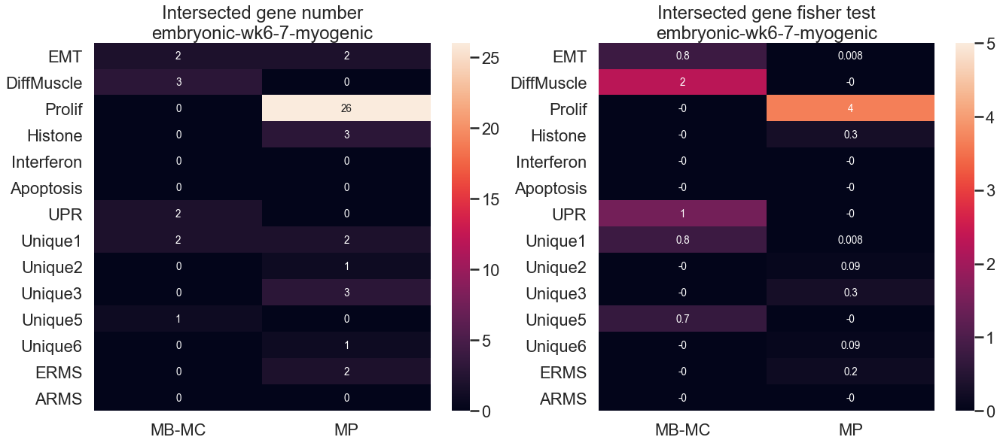

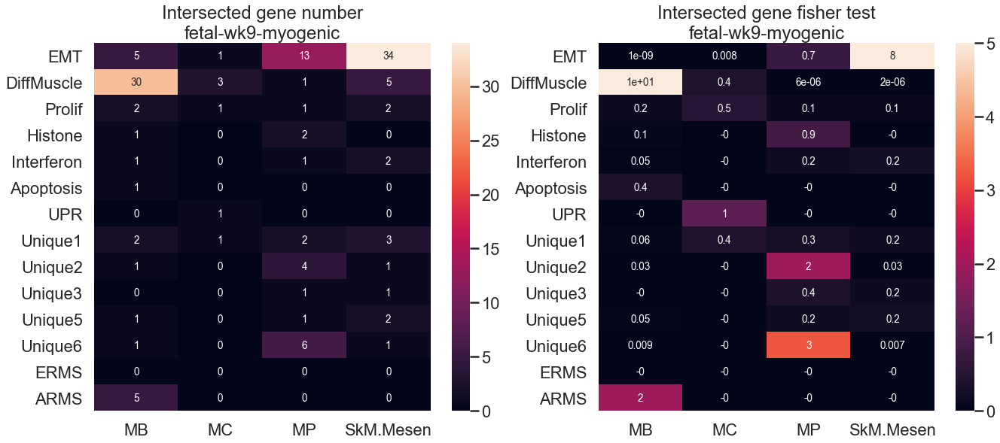

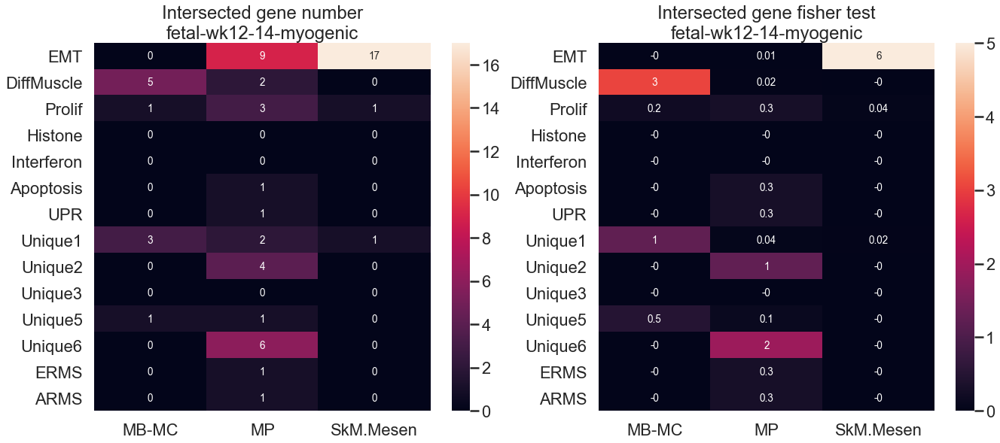

In [136]:
import os

state_rms_p_tmps = []
for m in ['/PHShome/qq06/projects/02_atlas/normal_muscle_cellbrowser/skeletal-muscle/embryonic/embryonic-wk6-7-myogenic/meta.tsv',
          '/PHShome/qq06/projects/02_atlas/normal_muscle_cellbrowser/skeletal-muscle/fetal/fetal-wk9-myogenic/meta.tsv', 
          '/PHShome/qq06/projects/02_atlas/normal_muscle_cellbrowser/skeletal-muscle/fetal/fetal-wk12-14-myogenic/meta.tsv']:
    try:
        smp_sc_meta = pd.read_table(m, header=0, index_col=0)
        print(m)
        dirs = os.path.dirname(m)
        label = os.path.basename(dirs)
        normal_muscle_marker = [pd.read_table('%s/%s.tsv.gz' % (dirs, c.replace('.', '').replace('-', ''))) 
                                for c in np.unique(smp_sc_meta.loc[:, 'Cell.Type'])]
        normal_muscle_marker = [s.iloc[:, 0].values for s in normal_muscle_marker]  
        state_rms = pd.DataFrame(np.zeros((np.unique(smp_sc_meta.loc[:, 'Cell.Type']).shape[0], 14)), index=np.unique(smp_sc_meta.loc[:, 'Cell.Type']),
                                 columns=['EMT', 'DiffMuscle', 'Prolif', 'Histone', 
                                           'Interferon', 'Apoptosis', 'UPR', 
                                          'Unique1', 'Unique2', 'Unique3', 'Unique5', 'Unique6',
                                          'ERMS', 'ARMS'])
        state_rms_p = pd.DataFrame(np.zeros((np.unique(smp_sc_meta.loc[:, 'Cell.Type']).shape[0], 14)), index=np.unique(smp_sc_meta.loc[:, 'Cell.Type']),
                                 columns=['EMT', 'DiffMuscle', 'Prolif', 'Histone', 
                                           'Interferon', 'Apoptosis', 'UPR', 
                                          'Unique1', 'Unique2', 'Unique3', 'Unique5', 'Unique6', 
                                           'ERMS', 'ARMS'])
        from functools import reduce
        allstates = reduce(np.union1d, normal_muscle_marker)
        allrms = reduce(np.union1d, rms_marker)

        for inx, i in zip(range(4), normal_muscle_marker):
            for ind, j in zip(range(15), rms_marker):
                state_rms.iloc[inx, ind] = np.intersect1d(i, j).shape[0]   
                non_j = np.setdiff1d(allrms, j)
                non_i = np.setdiff1d(allstates, i)

                cell1 = np.intersect1d(i, j).shape[0]
                cell2 = np.intersect1d(i, non_j).shape[0]

                cell3 = np.intersect1d(non_i, j).shape[0]       
                cell4 = np.intersect1d(non_i, non_j).shape[0]

                tab = [[cell1, cell2], [cell3, cell4]]
                #print(state_rms.index[inx], state_rms.columns[ind], tab)
                print(state_rms.index[inx], state_rms.columns[ind], np.intersect1d(i, j))                
                state_rms_p.iloc[inx, ind] = scipy.stats.fisher_exact(tab, alternative='greater')[1]   
        state_rms_p_tmp = pd.melt(state_rms_p)
        state_rms_p_tmp.loc[:, 'age'] = label
        state_rms_p_tmps.append(state_rms_p_tmp)        
        sns.set_context("poster", rc={"font.size": 13.5})        
        sns.set_style("white")
        fig, ax = plt.subplots(1, 2)
        fig.set_size_inches(22, 9)
        sns.heatmap(state_rms.T, annot=True, ax=ax[0], square=False)
        ax[0].set_title('Intersected gene number\n%s' % label)
        sns.heatmap(-np.log10(state_rms_p).T, annot=True, vmin=0, vmax=5, fmt='.1g', ax=ax[1], square=False)
        ax[1].set_title('Intersected gene fisher test\n%s' % label)
        #plt.savefig('Fig4_state_rms%s.pdf' % label)                        
    except:
        print(m)

## Fig.4 Heatmap of corresponding cell states

In [5]:
markers = np.array(['ACTN2', 
           'MYL4', 
           'TNNI1', 
           'TNNT2', 
           'ATP5J2',
           'COX6B1', 
           'NDUFA1', 
           'UQCR10', 
           'ATP2A1', 
           'ATP2B1', 
           'RYR1', 
           'RYR2', 
           'CCND2', 
           'CDK4', 
           'CENPF', 
           'MKI67', 
           'ENO1', 
           'MYC', 
           'NPM1', 
           'PTMA', 
           'CHD8', 
           'CYR61', 
           'GPC3', 
           'VCAN', 
           'LAMA2', 
           'LAMA4', 
           'LAMB1', 
           'LAMC1', 
           'FBLN5', 
           'SDC2', 
           'DCN', 
           'FN1', 
           'LGALS1', 
           'MFAP2', 
           'COL1A1', 
           'COL3A1', 
           'COL5A2', 
           'COL11A1', 
           'COL12A1', 
           'COL14A1', 
           'PCOLCE', 
           'FBLN2', 
           'LUM', 
           'SULF2', 
           'EBF2', 
           'MGP', 
           'OGN', 
           'OSR1', 
           'POSTN', 
           'TNMD', 
           'FAP', 
           'PDGFRA', 
           'THY1', 
           'VIM'])

In [6]:
marker_types = [
    'Contraction', 
    'Contraction', 
    'Contraction', 
    'Contraction', 
 
    'OxPhos', 
    'OxPhos', 
    'OxPhos', 
    'OxPhos', 

    'Calcium', 
    'Calcium', 
    'Calcium', 
    'Calcium', 

    'CellCycle',
    'CellCycle',
    'CellCycle',
    'CellCycle',

    'MYC',
    'MYC',
    'MYC',
    'MYC',

    'WNT/b-Catenin', 
    'WNT/b-Catenin', 
    'WNT/b-Catenin', 
    'WNT/b-Catenin', 

    'ECM',
    'ECM',
    'ECM',
    'ECM',
    'ECM',
    'ECM',
    'ECM',
    'ECM',
    'ECM',
    'ECM',
    'ECM',
    'ECM',
    'ECM',
    'ECM',
    'ECM',
    'ECM',
    'ECM',
    'ECM',
    'ECM',
    'ECM',

    'Skeletal',
    'Skeletal',
    'Skeletal',
    'Skeletal',
    'Skeletal',
    'Skeletal',

    'Mesen/Fibro', 
    'Mesen/Fibro', 
    'Mesen/Fibro', 
    'Mesen/Fibro']

In [7]:
len(markers)

54

In [8]:
pdx_annot = pd.read_table('../01_sc_rms/phaseA_explore_rms/PDX_all_cells.xls', index_col=0)

In [9]:
pdx_annot

,Ground,Hypoxia,EMT,Prolif,Apoptosis,Muscle,Interferon,Histone,UPR,Unique#6,Unique #1,Unique #5,Unique #2,Unique #3,Unique #4
MAST111,852,400,430,300,149,68,0,0,0,0,0,0,0,0,0
MAST139,593,1043,1619,2506,0,454,300,0,0,0,0,0,0,0,0
MAST35,1344,286,0,835,0,0,103,1027,0,0,0,0,0,0,0
MAST39,3812,658,151,3186,0,0,126,2644,0,0,0,0,0,0,0
MAST85,1786,257,0,3860,0,0,243,1277,0,0,0,0,0,0,0
MAST95,1414,802,0,1329,0,669,0,0,362,195,0,0,0,0,0
MSK82489,362,146,0,691,0,186,0,0,0,0,0,0,0,0,0
RH74,1656,678,0,1734,0,0,144,1223,0,0,0,0,0,0,0
MAST85-1,1675,609,27,812,0,0,234,1250,0,0,0,0,0,0,0
RH74-10,2990,609,0,2467,265,0,361,1362,0,0,0,0,0,0,0


In [723]:
pdx_annot = pd.read_table('../01_sc_rms/final_annotations/Final_clusters.txt', index_col=0)

In [724]:
pdx_annot

,0,1,2,3,4,5,6,7,8,9,10,11,12,13
PDX Sample,,,,,,,,,,,,,,
MSK74711,EMT,Ground,Ground,EMT,Prolif,Muscle,Prolif,Ground,Unique #1,Interferon,NaN,NaN,NaN,NaN
MSK72117,Ground,Ground,Ground,Unique #2,Unique #3,Unique #4,Prolif,Ground,Muscle,Prolif,Muscle,Prolif,Unique #3,Prolif
MAST118,Prolif,Muscle,Ground,Ground,Ground,Prolif,Prolif,Prolif,Prolif,Prolif,UPR,EMT,Unique #5,Apoptosis
MAST111,Ground,Hypoxia,EMT,Ground,Prolif,Apoptosis,Prolif,EMT,Muscle,NaN,NaN,NaN,NaN,NaN
MAST139,Prolif,Hypoxia,Prolif,EMT,Ground,EMT,Muscle,EMT,Interferon,EMT,NaN,NaN,NaN,NaN
MAST35,Ground,Histone,Ground,Prolif,Histone,Prolif,Hypoxia,Ground,Interferon,Prolif,NaN,NaN,NaN,NaN
MAST39,Ground,Histone,Ground,Prolif,Prolif,Histone,Hypoxia,Prolif,Prolif,Interferon,EMT,EMT,NaN,NaN
MAST85,Ground,Prolif,Histone,Prolif,Prolif,Prolif,Hypoxia,Interferon,Ground,NaN,NaN,NaN,NaN,NaN
MAST95,Ground,Hypoxia,Muscle,Prolif,Prolif,Prolif,UPR,Ground,Unique#6,Hypoxia,Muscle,NaN,NaN,NaN


In [735]:
tumors = []
for tumorl in ['MAST111', 'MAST139', 'MAST39', 'RH74', 
               'MAST85', 'MSK74711', 'MAST35']:
    tumor = scv.read('%s.loom.h5ad' % tumorl)

    if tumorl == 'MSK72117tencell':
        tumorl = 'MSK72117'
    tumor.obs['cellstate'] = None
    tumor.obs['cellstate'] = tumor.obs.loc[:, 'RNA_snn_res_0_8'].map(pdx_annot.loc[tumorl, :].to_dict())

    sc.pp.normalize_total(tumor, target_sum=1e6)
    sc.pp.log1p(tumor)
    sc.pp.highly_variable_genes(tumor, n_top_genes=5000)
    tumor.raw = tumor
    tumors.append(tumor)

In [736]:
target_state = ['Prolif', 'Ground', 'EMT', 'Muscle']
results = []

for t in target_state: 
    for tumor in tumors:
        expr = np.zeros((len(markers)))
        ind = np.in1d(np.array(markers), tumor.var_names)
        print(tumor[tumor.obs['cellstate']==t, markers[ind]].X.toarray().mean(axis=0))
        expr[ind] = tumor[tumor.obs['cellstate']==t, markers[ind]].X.toarray().mean(axis=0)        
        ##tumor[tumor.obs['cellstate']==t, markers].X.toarray().mean(axis=0)        
        results.append([t, tumor.obs['orig_ident'][0]] + list(expr))

[0.21278368  0.07125676  1.5523012   0.058227424 3.2267902   5.228524
 2.3818781   3.8146005   0.18259007  3.71583     1.6393745   0.33159876
 5.6090264   4.8212576   5.930873    5.002004    6.3912506   3.7539103
 8.027787    8.339998    1.9875866   5.4465775   5.3018856   5.9899426
 1.1215953   0.12062541  1.9510063   2.1019626   1.7825928   3.4168332
 4.92717     4.844828    5.637267    2.7771363   2.2410295   5.516606
 2.7220156   2.1964333   2.756579    0.72518504  1.0271447   0.1658069
 1.0483993   1.6212924   0.00906531  0.98324424  0.17940415  0.1343989
 0.7257786   0.28918633  0.2214283   1.6326996   1.6338637   7.7754784  ]
[3.55676234e-01 6.28078938e-01 4.57012844e+00 1.05645168e+00
 2.86017156e+00 4.30216646e+00 1.70529866e+00 4.11295843e+00
 2.24491522e-01 3.48212767e+00 7.54841685e-01 8.25534984e-02
 5.00875807e+00 5.71554613e+00 5.28053904e+00 4.10479927e+00
 7.46172333e+00 2.89975476e+00 7.70327997e+00 8.42694092e+00
 1.53291893e+00 5.16036987e+00 5.53834867e+00 4.166547

[0.17510258  0.087709054 0.4628717   0.43814868  3.5894496   5.5835233
 2.5513353   4.788354    0.07669799  3.9283564   2.8929133   0.26249498
 6.11203     4.6077404   5.0912576   2.9685085   6.8580923   3.1731906
 7.8438406   8.443225    2.5788398   4.1465907   4.8862863   6.0727882
 1.9954394   1.325854    3.5678427   3.9018764   1.4743516   5.0777907
 1.2786162   5.1306953   6.7798977   2.488396    3.1318493   6.738914
 4.7428217   0.66785306  0.5661162   2.8419297   1.8043005   0.4539488
 1.346701    2.8183086   0.22184661  0.15745942  0.92114776  0.13829729
 0.017468153 0.018976146 0.4772065   0.16544291  0.7710765   7.7017894  ]
[0.16375409  0.047046192 0.6797164   0.044791248 2.0179255   4.9728436
 1.6616746   2.6566086   0.06499234  3.223111    0.5016473   0.48551905
 5.6296535   3.7291455   1.4561441   0.4259392   6.520305    2.315066
 7.839579    7.5406713   1.4447634   4.913517    5.1671624   4.6569657
 1.9454637   0.95960283  3.4447777   2.315039    2.9393196   2.3619819
 5

In [737]:
pd.DataFrame(results).shape

(28, 56)

In [738]:
pd.DataFrame(results).to_csv('Fig5_heatmap_erms.csv')

In [739]:
tumors = []
for tumorl in ['MSK72117tencell', 'MAST95', 'MAST118', 'MSK82489']:
    tumor = scv.read('%s.loom.h5ad' % tumorl)
    if tumorl == 'MSK72117tencell':
        tumorl = 'MSK72117'
    tumor.obs['cellstate'] = None
    tumor.obs['cellstate'] = tumor.obs.loc[:, 'RNA_snn_res_0_8'].map(pdx_annot.loc[tumorl, :].to_dict())
    sc.pp.normalize_total(tumor, target_sum=1e6)
    sc.pp.log1p(tumor)
    sc.pp.highly_variable_genes(tumor, n_top_genes=5000)
    tumor.raw = tumor
    tumors.append(tumor)

In [740]:
target_state = ['Prolif', 'Ground', 'EMT', 'Muscle']
results = []
for t in target_state: 
    for tumor in tumors:
        expr = np.zeros((len(markers)))
        ind = np.in1d(np.array(markers), tumor.var_names)
        print(tumor[tumor.obs['cellstate']==t, markers[ind]].X.toarray().mean(axis=0))
        expr[ind] = tumor[tumor.obs['cellstate']==t, markers[ind]].X.toarray().mean(axis=0)        
        ##tumor[tumor.obs['cellstate']==t, markers].X.toarray().mean(axis=0)        
        results.append([t, tumor.obs['orig_ident'][0]] + list(expr))

[1.91758499e-01 5.42276382e+00 5.38718748e+00 5.74291086e+00
 3.10307145e+00 5.09512377e+00 3.82901907e+00 5.09848309e+00
 3.71849149e-01 3.05531836e+00 1.30130506e+00 2.07090050e-01
 5.43123865e+00 3.78716254e+00 5.65143824e+00 4.07759666e+00
 6.10387278e+00 2.16424346e-01 7.88720798e+00 7.70979548e+00
 1.74894631e+00 5.96537888e-01 2.58894515e+00 1.73498943e-01
 4.40986007e-02 7.52823502e-02 8.18331838e-01 8.05633485e-01
 2.68048716e+00 2.11858004e-01 3.61415267e-01 1.61986426e-01
 6.69349656e-02 0.00000000e+00 0.00000000e+00 5.56843840e-02
 5.02903610e-02 1.14601064e+00 6.12953445e-03 7.58522563e-03
 9.57082435e-02 2.61165357e+00 1.70018971e-02 2.49071550e-02
 1.26975905e-02 2.81800106e-02 0.00000000e+00 3.79412562e-01
 7.71115944e-02 7.61433935e+00]
[4.0116152e-01 4.4536734e+00 2.3945868e+00 4.4409318e+00 5.4091334e+00
 5.8872929e+00 4.4722381e+00 5.4705176e+00 5.1944707e-02 2.4397743e+00
 5.2540356e-01 4.1941601e-01 2.9418452e+00 4.3289428e+00 4.2803140e+00
 3.0929351e+00 5.661042

In [745]:
expr.shape, ind.shape

((54,), (54,))

In [742]:
pd.DataFrame(results).to_csv('Fig5_heatmap_arms.csv')

 ## Fig.6 markers distributed on Week 9 normal muscles

In [32]:
smp_sc_map = pd.read_table('/PHShome/qq06/projects/02_atlas/normal_muscle_cellbrowser/skeletal-muscle/fetal/fetal-wk9-myogenic/Seurat_tsne.coords.tsv.gz',
                           header=None)
smp_sc_meta.loc[:, 'age'] = smp_sc_meta.loc[:, 'orig.ident.short'].map(lambda x: x.split('_')[0])
smp_sc = pd.read_table('/PHShome/qq06/projects/02_atlas/normal_muscle_cellbrowser/skeletal-muscle/fetal/fetal-wk9-myogenic/exprMatrix.tsv.gz',
                       header=0, index_col=0)
smp_sc_meta = pd.read_table('/PHShome/qq06/projects/02_atlas/normal_muscle_cellbrowser/skeletal-muscle/fetal/fetal-wk9-myogenic/meta.tsv', 
                             header=0, index_col=0)
normal_muscle_marker = [pd.read_table('/PHShome/qq06/projects/02_atlas/normal_muscle_cellbrowser/skeletal-muscle/fetal/fetal-wk9-myogenic/%s.tsv.gz' % c.replace('.', '')) for c in np.unique(smp_sc_meta.loc[:, 'Cell.Type'])]
normal_muscle_marker = [s.iloc[:, 0].values for s in normal_muscle_marker]

adata = anndata.AnnData(scipy.sparse.csr_matrix(smp_sc.values).T.toarray(), 
                    var=pd.DataFrame(smp_sc.index, index=smp_sc.index), 
                    obs=smp_sc_meta)
adata.obsm['X_tsne'] = smp_sc_map.iloc[:, 1:].values
sc.pp.normalize_total(adata, target_sum=1e6)
sc.pp.log1p(adata)
sc.pp.highly_variable_genes(adata, n_top_genes=5000)
adata.raw = adata

In [33]:
sns.set('poster')
sns.set_style('white')

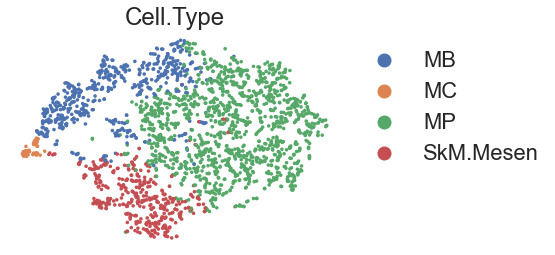

In [34]:
scv.pl.tsne(adata, color=['Cell.Type'])

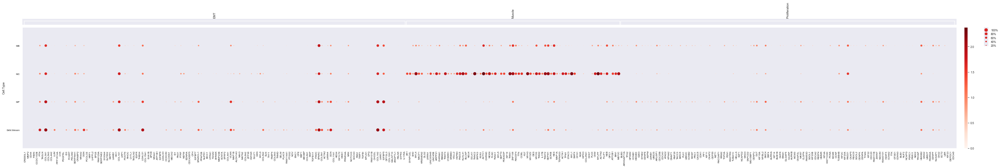

GridSpec(2, 5, height_ratios=[0.5, 10], width_ratios=[54.05, 0, 0.2, 0.5, 0.25])

In [37]:
sns.set('paper')
sc.pl.dotplot(adata, {"EMT": emt.iloc[:, 0].values[np.in1d(emt.iloc[:, 0].values, adata.var_names)], 
                      'Muscle': muscle.iloc[:, 0].values[np.in1d(muscle.iloc[:, 0].values, adata.var_names)],
                      'Proliferation': prolif.iloc[:, 0].values[np.in1d(prolif.iloc[:, 0].values, adata.var_names)]},
              groupby='Cell.Type', dot_min=0, dot_max=1.0, figsize=[55, 7.6],
              save='normal_9week_state_rms_statemarker.pdf',
              log=True)

saving figure to file ./figures/scvelo_normal_9week_state_score.pdf


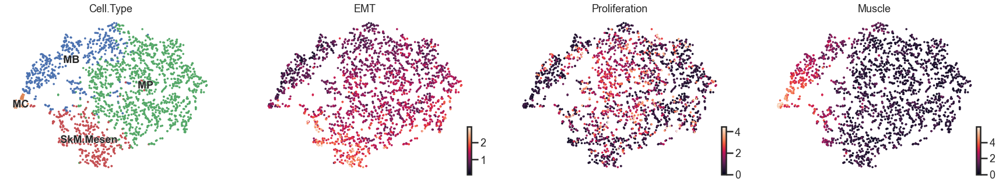

In [38]:
adata.obs['EMT'] = adata[:, emt.iloc[:, 0].values[np.in1d(emt.iloc[:, 0].values, adata.var_names)]].X.toarray().mean(axis=1)
adata.obs['Muscle'] = adata[:, muscle.iloc[:, 0].values[np.in1d(muscle.iloc[:, 0].values, adata.var_names)]].X.toarray().mean(axis=1)
adata.obs['Proliferation'] = adata[:, prolif.iloc[:, 0].values[np.in1d(prolif.iloc[:, 0].values, adata.var_names)]].X.toarray().mean(axis=1)

sns.set_context("poster", rc={"font.size": 18})        
sns.set_style('white')
scv.pl.tsne(adata, color=['Cell.Type']+['EMT', 'Proliferation', 'Muscle'], ncols=4,        
            save='normal_9week_state_score.pdf', legend_loc='on data', figsize=[7.5, 5])

saving figure to file ./figures/scvelo_normal_9week_state_demo.pdf


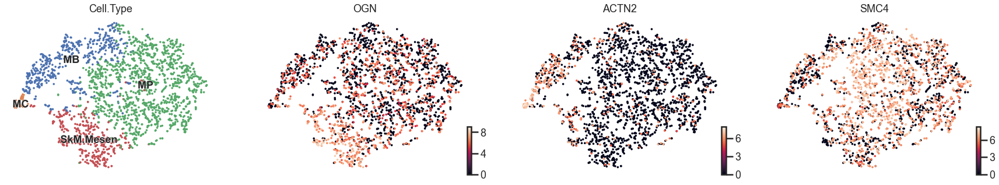

In [39]:
scv.pl.tsne(adata, color=['Cell.Type']+['OGN', 'ACTN2', 'SMC4'], legend_loc='on data', figsize=[7.5, 5],
           save='normal_9week_state_demo.pdf')

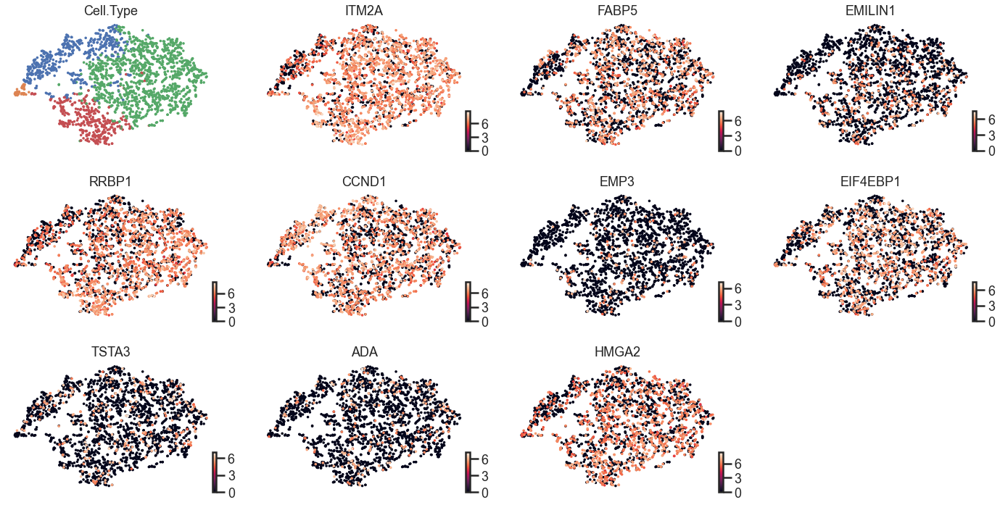

In [40]:
scv.pl.tsne(adata, color=['Cell.Type']+list(erms), ncols=4)

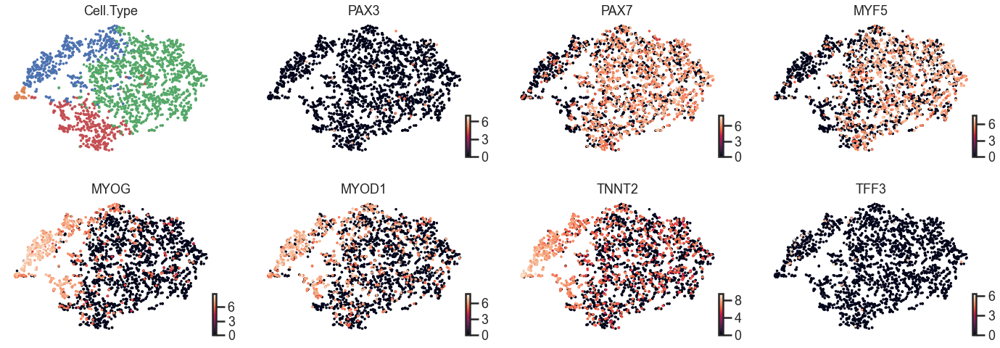

In [41]:
scv.pl.tsne(adata, color=['Cell.Type']+['PAX3', 'PAX7', 'MYF5', 'MYOG', 'MYOD1', 'TNNT2', 'TFF3'], ncols=4)

In [4]:
%pwd

'/data/langenau/alvin_singlecell/projects/02_atlas'

In [6]:
smp_sc_map = pd.read_table('/data/langenau/alvin_singlecell/projects/02_atlas/normal_muscle_cellbrowser/skeletal-muscle/embryonic/embryonic-wk7-8-myogenic/Seurat_tsne.coords.tsv.gz',
                           header=None)
smp_sc_meta = pd.read_table('/data/langenau/alvin_singlecell/projects/02_atlas/normal_muscle_cellbrowser/skeletal-muscle/embryonic/embryonic-wk7-8-myogenic/meta.tsv', 
                             header=0, index_col=0)
smp_sc_meta.loc[:, 'age'] = smp_sc_meta.loc[:, 'orig.ident.short'].map(lambda x: x.split('_')[0])
smp_sc = pd.read_table('/data/langenau/alvin_singlecell/projects/02_atlas/normal_muscle_cellbrowser/skeletal-muscle/embryonic/embryonic-wk7-8-myogenic/exprMatrix.tsv.gz',
                       header=0, index_col=0)
smp_sc_meta = pd.read_table('/data/langenau/alvin_singlecell/projects/02_atlas/normal_muscle_cellbrowser/skeletal-muscle/embryonic/embryonic-wk7-8-myogenic/meta.tsv', 
                             header=0, index_col=0)
normal_muscle_marker = [pd.read_table('/data/langenau/alvin_singlecell/projects/02_atlas/normal_muscle_cellbrowser/skeletal-muscle/embryonic/embryonic-wk7-8-myogenic/%s.tsv.gz' % c.replace('.', '')) for c in np.unique(smp_sc_meta.loc[:, 'Cell.Type'])]
normal_muscle_marker = [s.iloc[:, 0].values for s in normal_muscle_marker]
adata0 = anndata.AnnData(scipy.sparse.csr_matrix(smp_sc.values).T.toarray(), 
                    var=pd.DataFrame(smp_sc.index, index=smp_sc.index), 
                    obs=smp_sc_meta)
adata0.obsm['X_tsne'] = smp_sc_map.iloc[:, 1:].values
sc.pp.normalize_total(adata0, target_sum=1e6)
sc.pp.log1p(adata0)
sc.pp.highly_variable_genes(adata0, n_top_genes=5000)
adata0.raw = adata0

In [11]:
smp_sc_map = pd.read_table('/data/langenau/alvin_singlecell/projects/02_atlas/normal_muscle_cellbrowser/skeletal-muscle/fetal/fetal-wk12-14-myogenic/Seurat_tsne.coords.tsv.gz',
                           header=None)
smp_sc_meta = pd.read_table('/data/langenau/alvin_singlecell/projects/02_atlas/normal_muscle_cellbrowser/skeletal-muscle/fetal/fetal-wk12-14-myogenic/meta.tsv', 
                             header=0, index_col=0)
smp_sc_meta.loc[:, 'age'] = smp_sc_meta.loc[:, 'orig.ident.short'].map(lambda x: x.split('_')[0])
smp_sc = pd.read_table('/data/langenau/alvin_singlecell/projects/02_atlas/normal_muscle_cellbrowser/skeletal-muscle/fetal/fetal-wk12-14-myogenic/exprMatrix.tsv.gz',
                       header=0, index_col=0)
smp_sc_meta = pd.read_table('/data/langenau/alvin_singlecell/projects/02_atlas/normal_muscle_cellbrowser/skeletal-muscle/fetal/fetal-wk12-14-myogenic/meta.tsv', 
                             header=0, index_col=0)
normal_muscle_marker = [pd.read_table('/data/langenau/alvin_singlecell/projects/02_atlas/normal_muscle_cellbrowser/skeletal-muscle/fetal/fetal-wk12-14-myogenic/%s.tsv.gz' % c.replace('.', '')) for c in np.unique(smp_sc_meta.loc[:, 'Cell.Type'])]
normal_muscle_marker = [s.iloc[:, 0].values for s in normal_muscle_marker]

adata2 = anndata.AnnData(scipy.sparse.csr_matrix(smp_sc.values).T.toarray(), 
                    var=pd.DataFrame(smp_sc.index, index=smp_sc.index), 
                    obs=smp_sc_meta)
adata2.obsm['X_tsne'] = smp_sc_map.iloc[:, 1:].values
sc.pp.normalize_total(adata2, target_sum=1e6)
sc.pp.log1p(adata2)
sc.pp.highly_variable_genes(adata2, n_top_genes=5000)
adata2.raw = adata2

FileNotFoundError: [Errno 2] No such file or directory: '/data/langenau/alvin_singlecell/projects/02_atlas/normal_muscle_cellbrowser/skeletal-muscle/fetal/fetal-wk12-14-myogenic/MB-MC.tsv.gz'

In [52]:
adata.shape, adata0.shape, adata2.shape

((2345, 15894), (1448, 14802), (1448, 14802))

In [84]:
emt.iloc[:, 0].values[np.in1d(emt.iloc[:, 0].values, adata.var_names)]

array(['CREB3L1', 'MMP2', 'CD44', 'FIBIN', 'CCDC102B', 'PTN', 'TAGLN',
       'COL3A1', 'COL5A3', 'COL4A2', 'LUM', 'PPP1R14A', 'C1R', 'PDGFRL',
       'ID3', 'FCGRT', 'PDLIM2', 'SERPINH1', 'CRABP2', 'NR4A2', 'OGN',
       'PCOLCE', 'NRP1', 'LHFPL2', 'EPS8', 'FAM129A', 'SERPINE2',
       'S100A4', 'GLT8D2', 'SEPP1', 'LAMB1', 'HIC1', 'COL1A1', 'LRP1',
       'POSTN', 'RHOC', 'CYTL1', 'TAGLN2', 'EGFR', 'THBS4', 'LGALS1',
       'COL15A1', 'EVA1B', 'APOE', 'NR4A1', 'ATP1B1', 'IGFBP6', 'LGALS3',
       'CCDC80', 'SLC40A1', 'MEOX2', 'ID1', 'PAG1', 'PTRF', 'NEFM',
       'EDNRA', 'CDC42EP5', 'CFH', 'IGFBP7', 'SPARCL1', 'PPAP2B', 'NUPR1',
       'BICC1', 'HTRA1', 'TSHZ2', 'AHNAK', 'MMP23B', 'SCN7A', 'SFRP2',
       'COL4A1', 'VCAN', 'MAP1B', 'ALDH1A3', 'NAV3', 'MATN2', 'COL6A2',
       'ZFP36', 'CMYA5', 'SULF1', 'GSN', 'MYL9', 'COL5A2', 'ELN', 'THY1',
       'FABP4', 'COL6A3', 'TNMD', 'SELM', 'PLAC9', 'FAM114A1', 'PTGS2',
       'NOV', 'ENC1', 'CPE', 'EBF1', 'ABI3BP', 'COL6A1', 'MGP', 'TGFB1I1

In [86]:
prolif.iloc[:, 0].values[np.in1d(prolif.iloc[:, 0].values, adata.var_names)]

array(['BUB3', 'ARHGAP11A', 'TPX2', 'GPSM2', 'CCNB1', 'HMGB3', 'G2E3',
       'SYNE2', 'CENPE', 'ASPM', 'LMNB1', 'UBE2S', 'ARL6IP1', 'CDC25B',
       'CDCA3', 'ATAD2', 'KPNA2', 'DNMT1', 'RNF26', 'TACC3', 'BIRC5',
       'PLK1', 'UBE2C', 'CCNB2', 'MCM7', 'PRC1', 'CASC5', 'CDK1', 'PIF1',
       'KIF11', 'CKAP2', 'CEP55', 'MZT1', 'RACGAP1', 'RRM2', 'TOP2A',
       'FEN1', 'KNSTRN', 'TUBA1C', 'HELLS', 'E2F1', 'NCAPD2', 'MXD3',
       'SAPCD2', 'MIS18BP1', 'CENPU', 'DUT', 'KIF18A', 'MYBL2', 'SMC4',
       'DBF4', 'AURKA', 'KIF14', 'BUB1B', 'DHFR', 'RRM1', 'DLGAP5',
       'HJURP', 'AURKB', 'MCM3', 'CKAP2L', 'MKI67', 'CLSPN', 'FAM83D',
       'SGOL1', 'KIF20B', 'CDCA2', 'REEP4', 'HMMR', 'KIF4A', 'HIST1H3D',
       'PCNA', 'MCM6', 'CCNF', 'TUBB4B', 'KIF2C', 'KIF20A', 'RAD21',
       'CKAP5', 'FBXO5', 'SGOL2', 'CENPK', 'CENPA', 'TYMS', 'KIF22',
       'CDC20', 'FAM111B', 'ZWINT', 'NDC80', 'KIAA0101', 'H2AFX', 'CCNA2',
       'TTK', 'GTSE1', 'CDKN3', 'BUB1', 'NUF2', 'NCAPG', 'PSRC1', 'PRR11',
 

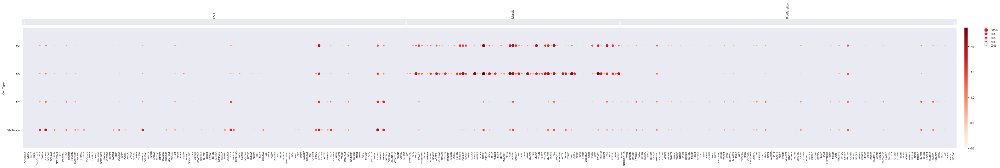

GridSpec(2, 5, height_ratios=[0.5, 10], width_ratios=[54.05, 0, 0.2, 0.5, 0.25])

In [375]:
sns.set('paper')
sc.pl.dotplot(adata, {"EMT": emt.iloc[:, 0].values[np.in1d(emt.iloc[:, 0].values, adata.var_names)], 
                      'Muscle': muscle.iloc[:, 0].values[np.in1d(muscle.iloc[:, 0].values, adata.var_names)],
                      'Proliferation': prolif.iloc[:, 0].values[np.in1d(prolif.iloc[:, 0].values, adata.var_names)]},
              groupby='Cell.Type', dot_min=0, dot_max=1.0, figsize=[55, 7.6],
              save='normal_78week_rms_statemarker.pdf',
              log=True)

saving figure to file ./figures/scvelo_normal_78week_rmsstate_demo.pdf


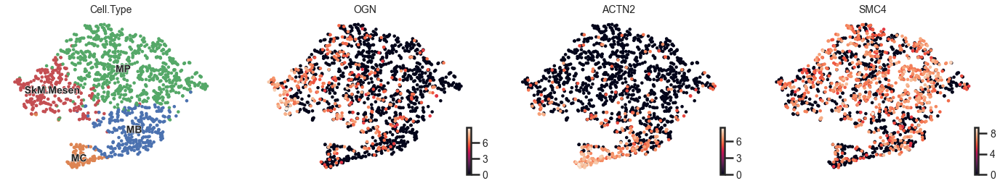

In [376]:
adata.obs['EMT'] = adata[:, emt.iloc[:, 0].values[np.in1d(emt.iloc[:, 0].values, adata.var_names)]].X.toarray().mean(axis=1)
adata.obs['Muscle'] = adata[:, muscle.iloc[:, 0].values[np.in1d(muscle.iloc[:, 0].values, adata.var_names)]].X.toarray().mean(axis=1)
adata.obs['Proliferation'] = adata[:, prolif.iloc[:, 0].values[np.in1d(prolif.iloc[:, 0].values, adata.var_names)]].X.toarray().mean(axis=1)

sns.set_context("poster", rc={"font.size": 14})        
sns.set_style('white')
scv.pl.tsne(adata, color=['Cell.Type']+['OGN', 'ACTN2', 'SMC4'], ncols=4, legend_loc='on data',             
            save='normal_78week_rmsstate_demo.pdf')

saving figure to file ./figures/scvelo_normal_78week_rmsstate_score.pdf


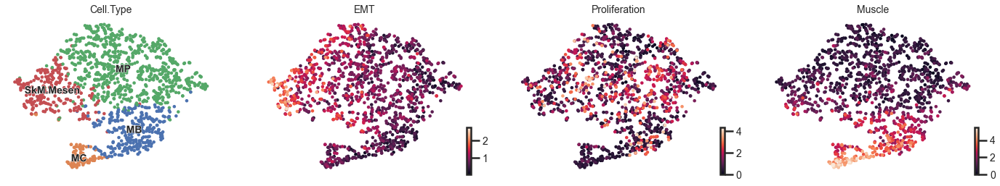

In [377]:
sns.set_context("poster", rc={"font.size": 14})        
sns.set_style('white')
scv.pl.tsne(adata, color=['Cell.Type']+['EMT', 'Proliferation', 'Muscle'], ncols=4, legend_loc='on data', 
            save='normal_78week_rmsstate_score.pdf')

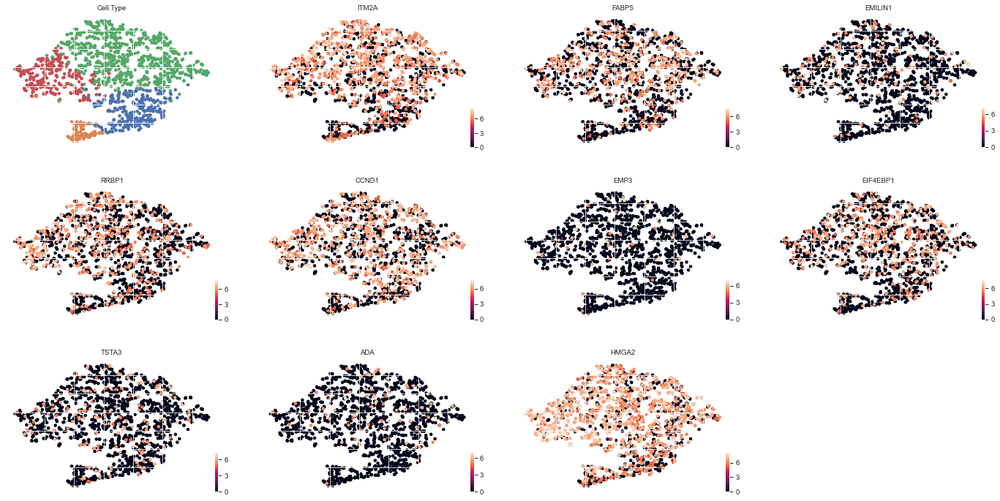

In [331]:
scv.pl.tsne(adata, color=['Cell.Type']+list(erms), ncols=4)

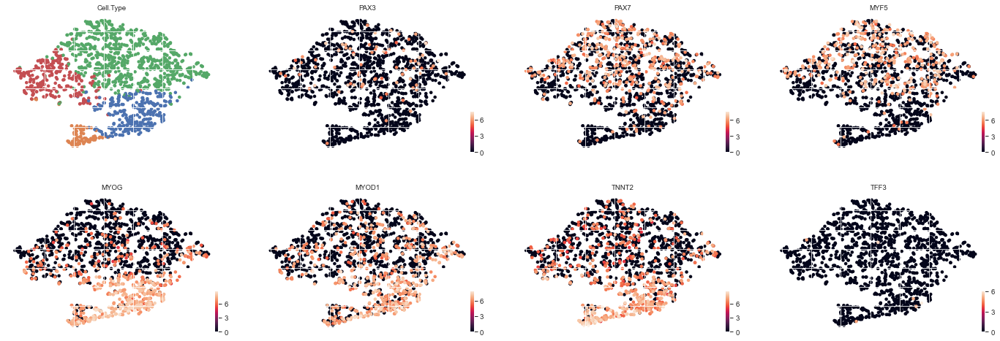

In [332]:
scv.pl.tsne(adata, color=['Cell.Type']+['PAX3', 'PAX7', 'MYF5', 'MYOG', 'MYOD1', 'TNNT2', 'TFF3'], ncols=4)

## Figure 1 from Dave's design

In [63]:
smp_sc_map = pd.read_table('/data/langenau/alvin_singlecell/projects/02_atlas/normal_muscle_cellbrowser/skeletal-muscle/embryonic/embryonic-wk6-7-myogenic/Seurat_tsne.coords.tsv.gz',
                           header=None)
smp_sc = pd.read_table('/data/langenau/alvin_singlecell/projects/02_atlas/normal_muscle_cellbrowser/skeletal-muscle/embryonic/embryonic-wk6-7-myogenic/exprMatrix.tsv.gz',
                       header=0, index_col=0)
smp_sc_meta = pd.read_table('/data/langenau/alvin_singlecell/projects/02_atlas/normal_muscle_cellbrowser/skeletal-muscle/embryonic/embryonic-wk6-7-myogenic/meta.tsv', 
                             header=0, index_col=0)

smp_sc_meta.loc[:, 'age'] = smp_sc_meta.loc[:, 'orig.ident.short'].map(lambda x: x.split('_')[0])

adata0 = anndata.AnnData(scipy.sparse.csr_matrix(smp_sc.values).T.toarray(), 
                    var=pd.DataFrame(smp_sc.index, index=smp_sc.index), 
                    obs=smp_sc_meta)
adata0.obsm['X_tsne'] = smp_sc_map.iloc[:, 1:].values
sc.pp.normalize_total(adata0, target_sum=1e6)
sc.pp.log1p(adata0)
sc.pp.highly_variable_genes(adata0, n_top_genes=5000)
#adata0.raw = adata0

smp_sc_map = pd.read_table('/data/langenau/alvin_singlecell/projects/02_atlas/normal_muscle_cellbrowser/skeletal-muscle/fetal/fetal-wk9-myogenic/Seurat_tsne.coords.tsv.gz',
                           header=None)
smp_sc = pd.read_table('/data/langenau/alvin_singlecell/projects/02_atlas/normal_muscle_cellbrowser/skeletal-muscle/fetal/fetal-wk9-myogenic/exprMatrix.tsv.gz',
                       header=0, index_col=0)
smp_sc_meta = pd.read_table('/data/langenau/alvin_singlecell/projects/02_atlas/normal_muscle_cellbrowser/skeletal-muscle/fetal/fetal-wk9-myogenic/meta.tsv', 
                             header=0, index_col=0)

smp_sc_meta.loc[:, 'age'] = smp_sc_meta.loc[:, 'orig.ident.short'].map(lambda x: x.split('_')[0])

adata1 = anndata.AnnData(scipy.sparse.csr_matrix(smp_sc.values).T.toarray(), 
                    var=pd.DataFrame(smp_sc.index, index=smp_sc.index), 
                    obs=smp_sc_meta)
adata1.obsm['X_tsne'] = smp_sc_map.iloc[:, 1:].values
sc.pp.normalize_total(adata1, target_sum=1e6)
sc.pp.log1p(adata1)
sc.pp.highly_variable_genes(adata1, n_top_genes=5000)
#adata1.raw = adata1

smp_sc_map = pd.read_table('/data/langenau/alvin_singlecell/projects/02_atlas/normal_muscle_cellbrowser/skeletal-muscle/fetal/fetal-wk12-14-myogenic/Seurat_tsne.coords.tsv.gz',
                           header=None)
smp_sc = pd.read_table('/data/langenau/alvin_singlecell/projects/02_atlas/normal_muscle_cellbrowser/skeletal-muscle/fetal/fetal-wk12-14-myogenic/exprMatrix.tsv.gz',
                       header=0, index_col=0)
smp_sc_meta = pd.read_table('/data/langenau/alvin_singlecell/projects/02_atlas/normal_muscle_cellbrowser/skeletal-muscle/fetal/fetal-wk12-14-myogenic/meta.tsv', 
                             header=0, index_col=0)

smp_sc_meta.loc[:, 'age'] = smp_sc_meta.loc[:, 'orig.ident.short'].map(lambda x: x.split('_')[0])

adata2 = anndata.AnnData(scipy.sparse.csr_matrix(smp_sc.values).T.toarray(), 
                    var=pd.DataFrame(smp_sc.index, index=smp_sc.index), 
                    obs=smp_sc_meta)
adata2.obsm['X_tsne'] = smp_sc_map.iloc[:, 1:].values
sc.pp.normalize_total(adata2, target_sum=1e6)
sc.pp.log1p(adata2)
sc.pp.highly_variable_genes(adata2, n_top_genes=5000)
#adata2.raw = adata1

In [64]:
adata2.shape

(554, 12652)

In [65]:
adata2.obs.head()

,nGene,nUMI,orig.ident,S.Score,G2M.Score,Phase,Muscle.Score,orig.ident.short,orig.ident.short_cell.type,Cell.Type,age
Cell,,,,,,,,,,,
B_Fet_Wk12_AP23_AAAACCCGTGAG,1418,2483,B_Fet_Wk12_AP23,-0.171069,0.521937,G2M,-0.432976,Wk12_AP23,Wk12_AP23_SkM.Mesen,SkM.Mesen,Wk12
B_Fet_Wk12_AP23_AAAAGCGGCGCA,936,1457,B_Fet_Wk12_AP23,-0.114076,0.782730,G2M,-0.038681,Wk12_AP23,Wk12_AP23_SkM.Mesen,SkM.Mesen,Wk12
B_Fet_Wk12_AP23_AAAATATATTAG,1440,2782,B_Fet_Wk12_AP23,-0.169543,-0.320377,G1,0.400173,Wk12_AP23,Wk12_AP23_MP,MP,Wk12
B_Fet_Wk12_AP23_AAAATTTGTTTG,1434,2541,B_Fet_Wk12_AP23,0.303042,0.269428,S,-0.439416,Wk12_AP23,Wk12_AP23_MP,MP,Wk12
B_Fet_Wk12_AP23_AAACTGCCCACA,938,1585,B_Fet_Wk12_AP23,-0.237097,-0.168355,G1,-0.297361,Wk12_AP23,Wk12_AP23_MP,MP,Wk12


In [10]:
# sns.set('paper')
# sc.pl.dotplot(adata0, {"EMT": emt.iloc[:, 0].values[np.in1d(emt.iloc[:, 0].values, adata0.var_names)], 
#                        'Muscle': muscle.iloc[:, 0].values[np.in1d(muscle.iloc[:, 0].values, adata0.var_names)],
#                        'Proliferation': prolif.iloc[:, 0].values[np.in1d(prolif.iloc[:, 0].values, adata0.var_names)]},
#               groupby='Cell.Type', dot_min=0, dot_max=0.5, figsize=[55, 7.6],
#               log=True)

# sc.pl.dotplot(adata1, {"EMT": emt.iloc[:, 0].values[np.in1d(emt.iloc[:, 0].values, adata1.var_names)], 
#                       'Muscle': muscle.iloc[:, 0].values[np.in1d(muscle.iloc[:, 0].values, adata1.var_names)],
#                       'Proliferation': prolif.iloc[:, 0].values[np.in1d(prolif.iloc[:, 0].values, adata1.var_names)]},
#               groupby='Cell.Type', dot_min=0, dot_max=0.5, figsize=[55, 7.6],
#               log=True)


# sc.pl.dotplot(adata2, {"EMT": emt.iloc[:, 0].values[np.in1d(emt.iloc[:, 0].values, adata2.var_names)], 
#                       'Muscle': muscle.iloc[:, 0].values[np.in1d(muscle.iloc[:, 0].values, adata2.var_names)],
#                       'Proliferation': prolif.iloc[:, 0].values[np.in1d(prolif.iloc[:, 0].values, adata2.var_names)]},
#               groupby='Cell.Type', dot_min=0, dot_max=0.5, figsize=[55, 7.6],
#               log=True)

In [11]:
# sns.set_style('white')
# fig, ax = plt.subplots(4, 3)
# fig.set_size_inches(15, 15)
# ax = ax.flatten()
# scv.pl.tsne(adata0, color=['Cell.Type'], ax=ax[0], s=18, legend_loc='on data', show=False)

# scv.pl.tsne(adata1, color=['Cell.Type'], ax=ax[1], s=18, legend_loc='on data', show=False)

# scv.pl.tsne(adata2, color=['Cell.Type'], ax=ax[2], s=18, legend_loc='on data', show=False)


# # scv.pl.tsne(adata0, color=['OGN'], ax=ax[3], legend_loc='on data', show=False)
# # scv.pl.tsne(adata1, color=['OGN'], ax=ax[4], legend_loc='on data', show=False)
# # scv.pl.tsne(adata2, color=['OGN'], ax=ax[5], legend_loc='on data', show=False)

# scv.pl.tsne(adata0, color=['KIF20A'], ax=ax[3], s=18, legend_loc='on data', show=False)
# scv.pl.tsne(adata1, color=['KIF20A'], ax=ax[4], s=18, legend_loc='on data', show=False)
# scv.pl.tsne(adata2, color=['KIF20A'], ax=ax[5], s=18, legend_loc='on data', show=False)

# scv.pl.tsne(adata0, color=['ACTN2'], ax=ax[6], s=18, legend_loc='on data', show=False)
# scv.pl.tsne(adata1, color=['ACTN2'], ax=ax[7], s=18, legend_loc='on data', show=False)
# scv.pl.tsne(adata2, color=['ACTN2'], ax=ax[8], s=18, legend_loc='on data', show=False)


# scv.pl.tsne(adata0, color=['CD44'], ax=ax[9], s=18, legend_loc='on data', show=False)
# scv.pl.tsne(adata1, color=['CD44'], ax=ax[10], s=18, legend_loc='on data', show=False)
# scv.pl.tsne(adata2, color=['CD44'], ax=ax[11], s=18, legend_loc='on data', show=False)

# # scv.pl.tsne(adata0, color=['PTN'], ax=ax[9], legend_loc='on data', show=False)
# # scv.pl.tsne(adata1, color=['PTN'], ax=ax[10], legend_loc='on data', show=False)
# # scv.pl.tsne(adata2, color=['PTN'], ax=ax[11], legend_loc='on data', show=False)

# # scv.pl.tsne(adata0, color=['LUM'], ax=ax[9], legend_loc='on data', show=False)
# # scv.pl.tsne(adata1, color=['LUM'], ax=ax[10], legend_loc='on data', show=False)
# # scv.pl.tsne(adata2, color=['LUM'], ax=ax[11], legend_loc='on data', show=False)

# # scv.pl.tsne(adata0, color=['LGALS1'], ax=ax[9], legend_loc='on data', show=False)
# # scv.pl.tsne(adata1, color=['LGALS1'], ax=ax[10], legend_loc='on data', show=False)
# # scv.pl.tsne(adata2, color=['LGALS1'], ax=ax[11], legend_loc='on data', show=False)

# fig.savefig('DraftFig1_normalstate.pdf')

In [12]:
# for p, e, m in zip(prolif.iloc[:, 0].values[np.in1d(prolif.iloc[:, 0].values, adata0.var_names)],
#                    emt.iloc[:, 0].values[np.in1d(emt.iloc[:, 0].values, adata0.var_names)],    
#                    muscle.iloc[:, 0].values[np.in1d(muscle.iloc[:, 0].values, adata0.var_names)]):    
#     sns.set_style('white')
#     fig, ax = plt.subplots(4, 3)
#     fig.set_size_inches(15, 15)
#     ax = ax.flatten()
#     scv.pl.tsne(adata0, color=['Cell.Type'], ax=ax[0], s=18, legend_loc='on data', show=False)

#     scv.pl.tsne(adata1, color=['Cell.Type'], ax=ax[1], s=18, legend_loc='on data', show=False)

#     scv.pl.tsne(adata2, color=['Cell.Type'], ax=ax[2], s=18, legend_loc='on data', show=False)

#     # scv.pl.tsne(adata0, color=['OGN'], ax=ax[3], legend_loc='on data', show=False)
#     # scv.pl.tsne(adata1, color=['OGN'], ax=ax[4], legend_loc='on data', show=False)
#     # scv.pl.tsne(adata2, color=['OGN'], ax=ax[5], legend_loc='on data', show=False)
    
#     scv.pl.tsne(adata0, color=[p], ax=ax[9], s=18, legend_loc='on data', show=False)
#     scv.pl.tsne(adata1, color=[p], ax=ax[10], s=18, legend_loc='on data', show=False)
#     scv.pl.tsne(adata2, color=[p], ax=ax[11], s=18, legend_loc='on data', show=False)    
    
#     scv.pl.tsne(adata0, color=[m], ax=ax[6], s=18, legend_loc='on data', show=False)
#     scv.pl.tsne(adata1, color=[m], ax=ax[7], s=18, legend_loc='on data', show=False)
#     scv.pl.tsne(adata2, color=[m], ax=ax[8], s=18, legend_loc='on data', show=False)    

#     scv.pl.tsne(adata0, color=[e], ax=ax[3], s=18, legend_loc='on data', show=False)
#     scv.pl.tsne(adata1, color=[e], ax=ax[4], s=18, legend_loc='on data', show=False)
#     scv.pl.tsne(adata2, color=[e], ax=ax[5], s=18, legend_loc='on data', show=False)

#     # scv.pl.tsne(adata0, color=['PTN'], ax=ax[9], legend_loc='on data', show=False)
#     # scv.pl.tsne(adata1, color=['PTN'], ax=ax[10], legend_loc='on data', show=False)
#     # scv.pl.tsne(adata2, color=['PTN'], ax=ax[11], legend_loc='on data', show=False)

#     # scv.pl.tsne(adata0, color=['LUM'], ax=ax[9], legend_loc='on data', show=False)
#     # scv.pl.tsne(adata1, color=['LUM'], ax=ax[10], legend_loc='on data', show=False)
#     # scv.pl.tsne(adata2, color=['LUM'], ax=ax[11], legend_loc='on data', show=False)

#     # scv.pl.tsne(adata0, color=['LGALS1'], ax=ax[9], legend_loc='on data', show=False)
#     # scv.pl.tsne(adata1, color=['LGALS1'], ax=ax[10], legend_loc='on data', show=False)
#     # scv.pl.tsne(adata2, color=['LGALS1'], ax=ax[11], legend_loc='on data', show=False)
    
#     break

In [20]:
# size=25
# vmin=2.5
# sns.set('poster', rc={'font.size': 16})
# sns.set_style('white')
# fig, ax = plt.subplots(4, 3)
# fig.set_size_inches(9.5, 8)
# ax = ax.flatten()
# sc.pl.tsne(adata0, color=['Cell.Type'], ax=ax[0], s=size, legend_loc='on data', show=False, vmin=5, vmax=8, frameon=False)
# sc.pl.tsne(adata1, color=['Cell.Type'], ax=ax[1], s=size, legend_loc='on data', show=False, vmin=5, vmax=8, frameon=False)
# sc.pl.tsne(adata2, color=['Cell.Type'], ax=ax[2], s=size, legend_loc='on data', show=False, vmin=5, vmax=8, frameon=False)

# # 'ASPM' 'BIRC5' 'BUB1B' 'BUB3' 'CCNA2' 'CCNB2' 'CENPF' 'CENPU' 'CKAP2'
# #  'CKS2' 'FBXO5' 'GINS2' 'H2AFX' 'HMGB2' 'HMGB3' 'KIF23' 'LMNB1' 'MKI67'
# #  'NUSAP1' 'PCNA' 'SMC4' 'SYNE2' 'TOP2A' 'TPX2' 'TTK' 'UBE2C

# scv.pl.tsne(adata0, color=['BUB1B'], ax=ax[3], s=size, legend_loc='on data', show=False, vmin=vmin, vmax=10, colorbar=False)
# scv.pl.tsne(adata1, color=['BUB1B'], ax=ax[4], s=size, legend_loc='on data', show=False, vmin=vmin, vmax=10, colorbar=False)
# scv.pl.tsne(adata2, color=['BUB1B'], ax=ax[5], s=size, legend_loc='on data', show=False, vmin=vmin, vmax=10)

# # scv.pl.tsne(adata0, color=['HMGB3'], ax=ax[3], s=size, legend_loc='on data', show=False, vmin=3, vmax=10)
# # scv.pl.tsne(adata1, color=['HMGB3'], ax=ax[4], s=size, legend_loc='on data', show=False, vmin=3, vmax=10)
# # scv.pl.tsne(adata2, color=['HMGB3'], ax=ax[5], s=size, legend_loc='on data', show=False, vmin=3, vmax=10)

# # scv.pl.tsne(adata0, color=['KIF20A'], ax=ax[3], s=size, legend_loc='on data', show=False)
# # scv.pl.tsne(adata1, color=['KIF20A'], ax=ax[4], s=size, legend_loc='on data', show=False)
# # scv.pl.tsne(adata2, color=['KIF20A'], ax=ax[5], s=size, legend_loc='on data', show=False)

# scv.pl.tsne(adata0, color=['ACTN2'], ax=ax[6], s=size, legend_loc='on data', show=False, vmin=vmin, vmax=10, colorbar=False)
# scv.pl.tsne(adata1, color=['ACTN2'], ax=ax[7], s=size, legend_loc='on data', show=False, vmin=vmin, vmax=10, colorbar=False)
# scv.pl.tsne(adata2, color=['ACTN2'], ax=ax[8], s=size, legend_loc='on data', show=False, vmin=vmin, vmax=10)

# ## array(['CCDC80', 'COL11A1', 'COL12A1', 'COL1A2', 'COL3A1', 'COL5A1',
# #        'COL5A2', 'CRABP2', 'DCN', 'FIBIN', 'IL11RA', 'ITM2C', 'LGALS1',
# #        'LUM', 'MAP1B', 'MGP', 'NEFM', 'NOV', 'NUPR1', 'OGN', 'PCOLCE',
# #        'PLAC9', 'POSTN', 'PPAP2B', 'PTN', 'PTRF', 'SFRP2', 'SPARC',
# #        'TGFBI', 'THY1', 'TIMP1', 'TSHZ2'], dtype=object)
# # scv.pl.tsne(adata0, color=['CCDC80'], ax=ax[9], s=size, legend_loc='on data', show=False)
# # scv.pl.tsne(adata1, color=['CCDC80'], ax=ax[10], s=size, legend_loc='on data', show=False)
# # scv.pl.tsne(adata2, color=['CCDC80'], ax=ax[11], s=size, legend_loc='on data', show=False)

# # scv.pl.tsne(adata0, color=['PPAP2B'], ax=ax[9], s=size, legend_loc='on data', show=False)
# # scv.pl.tsne(adata1, color=['PPAP2B'], ax=ax[10], s=size, legend_loc='on data', show=False)
# # scv.pl.tsne(adata2, color=['PPAP2B'], ax=ax[11], s=size, legend_loc='on data', show=False)

# scv.pl.tsne(adata0, color=['PTN'], ax=ax[9], s=size, legend_loc='on data', show=False, vmin=vmin+3, vmax=10, colorbar=False)
# scv.pl.tsne(adata1, color=['PTN'], ax=ax[10], s=size, legend_loc='on data', show=False, vmin=vmin+3, vmax=10, colorbar=False)
# scv.pl.tsne(adata2, color=['PTN'], ax=ax[11], s=size, legend_loc='on data', show=False, vmin=vmin+3, vmax=10)

# # scv.pl.tsne(adata0, color=['LUM'], ax=ax[9], legend_loc='on data', show=False)
# # scv.pl.tsne(adata1, color=['LUM'], ax=ax[10], legend_loc='on data', show=False)
# # scv.pl.tsne(adata2, color=['LUM'], ax=ax[11], legend_loc='on data', show=False)

# # scv.pl.tsne(adata0, color=['LGALS1'], ax=ax[9], legend_loc='on data', show=False)
# # scv.pl.tsne(adata1, color=['LGALS1'], ax=ax[10], legend_loc='on data', show=False)
# # scv.pl.tsne(adata2, color=['LGALS1'], ax=ax[11], legend_loc='on data', show=False)

# plt.subplots_adjust(left=0.02, right=0.93, top=0.96, bottom=0.02)
# fig.savefig('DraftFig1_normalstate_PTN.png', dpi=320)

In [66]:
adata0.obs['Prolif signature score'] = adata0[:, adata0.var_names.isin(prolif.iloc[:, 0].values)].X.toarray().mean(axis=1)
adata0.obs['EMT signature score'] = adata0[:, adata0.var_names.isin(emt.iloc[:, 0].values)].X.toarray().mean(axis=1)
adata0.obs['Muscle signature score'] = adata0[:, adata0.var_names.isin(muscle.iloc[:, 0].values)].X.toarray().mean(axis=1)

In [67]:
adata1.obs['Prolif signature score'] = adata1[:, adata1.var_names.isin(prolif.iloc[:, 0].values)].X.toarray().mean(axis=1)
adata1.obs['EMT signature score'] = adata1[:, adata1.var_names.isin(emt.iloc[:, 0].values)].X.toarray().mean(axis=1)
adata1.obs['Muscle signature score'] = adata1[:, adata1.var_names.isin(muscle.iloc[:, 0].values)].X.toarray().mean(axis=1)

In [68]:
adata2.obs['Prolif signature score'] = adata2[:, adata2.var_names.isin(prolif.iloc[:, 0].values)].X.toarray().mean(axis=1)
adata2.obs['EMT signature score'] = adata2[:, adata2.var_names.isin(emt.iloc[:, 0].values)].X.toarray().mean(axis=1)
adata2.obs['Muscle signature score'] = adata2[:, adata2.var_names.isin(muscle.iloc[:, 0].values)].X.toarray().mean(axis=1)

In [69]:
import matplotlib
cmap = matplotlib.colors.LinearSegmentedColormap.from_list("", ["lightgray", "red"])
cmap1 = matplotlib.colors.LinearSegmentedColormap.from_list("", ["lightgray", "blue"])
cmap2 = matplotlib.colors.LinearSegmentedColormap.from_list("", ["lightgray", "purple"])

In [70]:
adata0.obs.loc[:, 'Cell.Type'].astype('category').cat.categories

Index(['MB-MC', 'MP'], dtype='object')

In [71]:
colors = [ "red", 'gray']
palette0 = sns.color_palette(colors)

In [72]:
colors = [ 'red', 'gray', "purple"]
palette = sns.color_palette(colors)

In [73]:
colors = [ "red", 'red', 'gray', 'purple']
palette2 = sns.color_palette(colors)

... storing 'orig.ident' as categorical
... storing 'Phase' as categorical
... storing 'orig.ident.short' as categorical
... storing 'orig.ident.short_cell.type' as categorical
... storing 'Cell.Type' as categorical
... storing 'age' as categorical
... storing 'orig.ident' as categorical
... storing 'Phase' as categorical
... storing 'orig.ident.short' as categorical
... storing 'orig.ident.short_cell.type' as categorical
... storing 'Cell.Type' as categorical
... storing 'age' as categorical
... storing 'orig.ident' as categorical
... storing 'Phase' as categorical
... storing 'orig.ident.short' as categorical
... storing 'orig.ident.short_cell.type' as categorical
... storing 'Cell.Type' as categorical
... storing 'age' as categorical


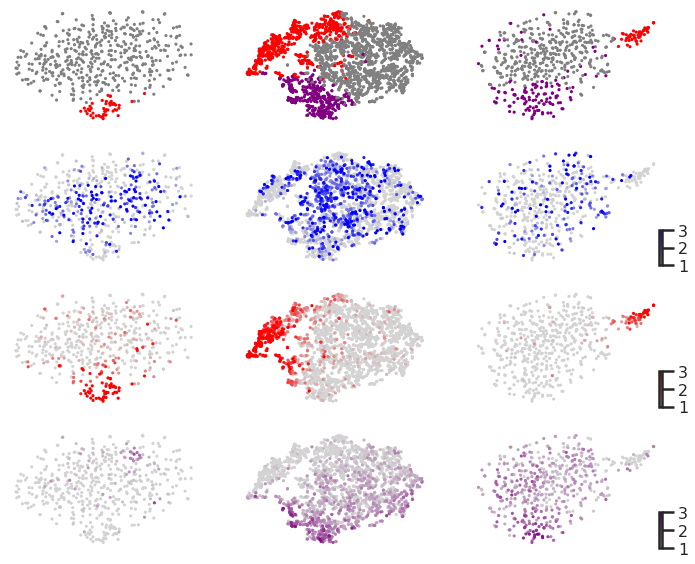

In [74]:
size=40
vmax=3
vmin=1
sns.set('poster', rc={'font.size': 16})
sns.set_style('white')
fig, ax = plt.subplots(4, 3)
fig.set_size_inches(10, 8)
ax = ax.flatten()
sc.pl.tsne(adata0, color=['Cell.Type'], title='', ax=ax[0], s=size, palette=palette0,
           legend_loc='none', show=False, frameon=False)
sc.pl.tsne(adata1, color=['Cell.Type'], title='', ax=ax[1], s=size, palette=palette2, 
           legend_loc='none', show=False, frameon=False)
sc.pl.tsne(adata2, color=['Cell.Type'], title='', ax=ax[2], s=size, legend_loc='none', 
           palette=palette, show=False, frameon=False)

scv.pl.tsne(adata0, color=['Prolif signature score'], ax=ax[3], title='', s=size, legend_loc='none', cmap = cmap1, show=False, vmin=vmin, vmax=vmax, colorbar=False)
scv.pl.tsne(adata1, color=['Prolif signature score'], ax=ax[4], title='', s=size, legend_loc='none', cmap = cmap1, show=False, vmin=vmin, vmax=vmax, colorbar=False)
scv.pl.tsne(adata2, color=['Prolif signature score'], ax=ax[5], title='', s=size, legend_loc='none', cmap = cmap1, show=False, vmin=vmin, vmax=vmax, )

scv.pl.tsne(adata0, color=['Muscle signature score'], ax=ax[6], title='', s=size, legend_loc='none', cmap = cmap, show=False, vmin=vmin, vmax=vmax, colorbar=False)
scv.pl.tsne(adata1, color=['Muscle signature score'], ax=ax[7], title='', s=size, legend_loc='none', cmap = cmap, show=False, vmin=vmin, vmax=vmax, colorbar=False)
scv.pl.tsne(adata2, color=['Muscle signature score'], ax=ax[8], title='', s=size, legend_loc='none', cmap = cmap, show=False, vmin=vmin, vmax=vmax, )

scv.pl.tsne(adata0, color=['EMT signature score'], ax=ax[9], title='', s=size, legend_loc='none', cmap = cmap2, show=False, vmin=vmin, vmax=vmax, colorbar=False)
scv.pl.tsne(adata1, color=['EMT signature score'], ax=ax[10], title='', s=size, legend_loc='none', cmap = cmap2, show=False, vmin=vmin, vmax=vmax, colorbar=False)
scv.pl.tsne(adata2, color=['EMT signature score'], ax=ax[11], title='', s=size, legend_loc='none', cmap = cmap2, show=False, vmin=vmin, vmax=vmax, )

plt.subplots_adjust(left=0.02, right=0.93, top=0.96, bottom=0.02)
fig.savefig('DraftFig1_normalstate_PTN.pdf', dpi=320)

In [75]:
%pwd

'/data/langenau/alvin_singlecell/projects/02_atlas'

In [29]:
# sns.set('paper')
# sc.pl.dotplot(adata0, {"EMT": emt.iloc[:, 0].values[np.in1d(emt.iloc[:, 0].values, adata0.var_names)], 
#                        'Muscle': muscle.iloc[:, 0].values[np.in1d(muscle.iloc[:, 0].values, adata0.var_names)],
#                        'Proliferation': prolif.iloc[:, 0].values[np.in1d(prolif.iloc[:, 0].values, adata0.var_names)]},
#               groupby='Cell.Type', dot_min=0, dot_max=1, figsize=[55, 7.6],
#               log=True)

# sc.pl.dotplot(adata1, {"EMT": emt.iloc[:, 0].values[np.in1d(emt.iloc[:, 0].values, adata1.var_names)], 
#                       'Muscle': muscle.iloc[:, 0].values[np.in1d(muscle.iloc[:, 0].values, adata1.var_names)],
#                       'Proliferation': prolif.iloc[:, 0].values[np.in1d(prolif.iloc[:, 0].values, adata1.var_names)]},
#               groupby='Cell.Type', dot_min=0, dot_max=1, figsize=[55, 7.6],
#               log=True)

# sc.pl.dotplot(adata2, {"EMT": emt.iloc[:, 0].values[np.in1d(emt.iloc[:, 0].values, adata2.var_names)], 
#                       'Muscle': muscle.iloc[:, 0].values[np.in1d(muscle.iloc[:, 0].values, adata2.var_names)],
#                       'Proliferation': prolif.iloc[:, 0].values[np.in1d(prolif.iloc[:, 0].values, adata2.var_names)]},
#               groupby='Cell.Type', dot_min=0, dot_max=1, figsize=[55, 7.6],
#               log=True)

In [30]:
cutoff = 2.0
results = []
for c in ['MP', 'MB', 'MC', 'MB-MC', 'SkM.Mesen']:
    for a in [adata0, adata1, adata2]:
        if c in a.obs.loc[:, 'Cell.Type'].values:
            for p in prolif.iloc[:, 0].values[np.in1d(prolif.iloc[:, 0].values, a.var_names)]:
                ann = a[a.obs.loc[:, 'Cell.Type'] == c, p]
                expr = ann.X.toarray()[:, 0]
                expr[expr < cutoff] = 0
                results.append([ann.obs.loc[:, ['age', 'Cell.Type']].apply(lambda x:'_'.join(x), axis=1)[0],
                                'Prolif', p,
                                (expr > 0).sum()/expr.shape[0], expr.mean()])
                
            for p in muscle.iloc[:, 0].values[np.in1d(muscle.iloc[:, 0].values, a.var_names)]:
                ann = a[a.obs.loc[:, 'Cell.Type'] == c, p]
                expr = ann.X.toarray()[:, 0]
                expr[expr < cutoff] = 0
                results.append([ann.obs.loc[:, ['age', 'Cell.Type']].apply(lambda x:'_'.join(x), axis=1)[0],
                                'Muscle', p, 
                                (expr > 0).sum()/expr.shape[0], expr.mean()])       
                
            for p in emt.iloc[:, 0].values[np.in1d(emt.iloc[:, 0].values, a.var_names)]:
                ann = a[a.obs.loc[:, 'Cell.Type'] == c, p]
                expr = ann.X.toarray()[:, 0]
                expr[expr < cutoff] = 0
                results.append([ann.obs.loc[:, ['age', 'Cell.Type']].apply(lambda x:'_'.join(x), axis=1)[0],
                                'EMT', p, 
                                (expr > 0).sum()/expr.shape[0], expr.mean()])

In [31]:
results = pd.DataFrame(results)

In [32]:
results.head()

,0,1,2,3,4
0,Wk7.0_MP,Prolif,BUB3,0.345652,2.054124
1,Wk7.0_MP,Prolif,ARHGAP11A,0.223913,1.330979
2,Wk7.0_MP,Prolif,TPX2,0.410870,2.641624
3,Wk7.0_MP,Prolif,GPSM2,0.065217,0.375654
4,Wk7.0_MP,Prolif,CCNB1,0.213043,1.284990


In [33]:
results.iloc[:, 0].unique()

array(['Wk7.0_MP', 'Wk9_MP', 'Wk12_MP', 'Wk9_MB', 'Wk9_MC', 'Wk7.0_MB-MC',
       'Wk12_MB-MC', 'Wk9_SkM.Mesen', 'Wk12_SkM.Mesen'], dtype=object)

In [34]:
from collections import OrderedDict
map_dict = OrderedDict()
map_dict2 = OrderedDict()

for i, j in zip(results.iloc[:, 0].unique(), [1, 2, 3, 5, 6, 4, 7, 8, 9]):
    map_dict[i] = j-1
    map_dict2[j-1] = i

In [35]:
gene_dict = OrderedDict()
gene_dict2 = OrderedDict()

for i, j in enumerate(results.sort_values(1).iloc[:, 2].unique()):
    gene_dict[j] = i
    gene_dict2[i] = j

In [36]:
results.iloc[:, 0] = results.iloc[:, 0].astype('category')
results.iloc[:, 2] = results.iloc[:, 2].astype('category')

In [37]:
results.loc[:, 'X'] = results.iloc[:, 0].map(map_dict)
results.loc[:, 'Y'] = results.iloc[:, 2].map(gene_dict)

In [38]:
results.head()

,0,1,2,3,4,X,Y
0,Wk7.0_MP,Prolif,BUB3,0.345652,2.054124,0,262
1,Wk7.0_MP,Prolif,ARHGAP11A,0.223913,1.330979,0,263
2,Wk7.0_MP,Prolif,TPX2,0.410870,2.641624,0,264
3,Wk7.0_MP,Prolif,GPSM2,0.065217,0.375654,0,265
4,Wk7.0_MP,Prolif,CCNB1,0.213043,1.284990,0,266


In [39]:
results.loc[results.iloc[:, 2] == 'TNNC1', :]

,0,1,2,3,4,X,Y
143,Wk7.0_MP,Muscle,TNNC1,0.019565,0.116187,0,199
448,Wk9_MP,Muscle,TNNC1,0.011976,0.071171,1,199
1078,Wk9_MB,Muscle,TNNC1,0.023132,0.139660,4,199
1395,Wk9_MC,Muscle,TNNC1,0.804348,5.807579,5,199
1711,Wk7.0_MB-MC,Muscle,TNNC1,0.666667,4.462527,3,199
2329,Wk9_SkM.Mesen,Muscle,TNNC1,0.054863,0.344432,7,199


In [40]:
results.loc[results.iloc[:, 2] == 'BUB1B', :]

,0,1,2,3,4,X,Y
53,Wk7.0_MP,Prolif,BUB1B,0.256522,1.531217,0,294
357,Wk9_MP,Prolif,BUB1B,0.159431,0.929874,1,294
674,Wk12_MP,Prolif,BUB1B,0.117021,0.710346,2,294
987,Wk9_MB,Prolif,BUB1B,0.108541,0.642792,4,294
1304,Wk9_MC,Prolif,BUB1B,0.000000,0.000000,5,294
1621,Wk7.0_MB-MC,Prolif,BUB1B,0.020833,0.106536,3,294
1925,Wk12_MB-MC,Prolif,BUB1B,0.041667,0.251079,6,294
2238,Wk9_SkM.Mesen,Prolif,BUB1B,0.139651,0.823455,7,294
2555,Wk12_SkM.Mesen,Prolif,BUB1B,0.161538,0.993479,8,294


In [41]:
results.loc[results.iloc[:, 2] == 'DUT', :]

,0,1,2,3,4,X,Y
46,Wk7.0_MP,Prolif,DUT,0.476087,2.945205,0,315
350,Wk9_MP,Prolif,DUT,0.538174,3.382600,1,315
667,Wk12_MP,Prolif,DUT,0.481383,3.132271,2,315
980,Wk9_MB,Prolif,DUT,0.516014,3.202223,4,315
1297,Wk9_MC,Prolif,DUT,0.326087,1.912588,5,315
1614,Wk7.0_MB-MC,Prolif,DUT,0.312500,1.837344,3,315
1918,Wk12_MB-MC,Prolif,DUT,0.291667,1.741817,6,315
2231,Wk9_SkM.Mesen,Prolif,DUT,0.566085,3.483039,7,315
2548,Wk12_SkM.Mesen,Prolif,DUT,0.523077,3.355567,8,315


In [42]:
results.iloc[:, 3].max()

1.0

In [43]:
state_dict = OrderedDict()
for i, j in zip(results.Y, results.iloc[:, 1]):
    state_dict[i] = j

In [44]:
('NEU4' in muscle.values), ('KIF19' in muscle.values), ('RGR' in muscle.values)

(True, True, True)

In [45]:
('NEU4' in emt.values), ('KIF19' in emt.values), ('RGR' in emt.values)

(False, False, False)

In [46]:
# # All genes

# # plt.rcParams['xtick.bottom'] = plt.rcParams['xtick.labelbottom'] = False
# # plt.rcParams['xtick.top'] = plt.rcParams['xtick.labeltop'] = True


# sns.set('poster', rc={"font.size": 8})
# scaled_expr = results.iloc[:, 4].values
# scaled_expr[scaled_expr>np.percentile(scaled_expr, 95)] = np.percentile(scaled_expr, 95)

# fig, ax = plt.subplots()
# fig.set_size_inches(6.5, 55)
# ax.scatter(results.loc[:, 'X'].values, 
#            results.loc[:, 'Y'].values, 
#            c=scaled_expr/np.max(scaled_expr), 
#            s=results.iloc[:, 3].values*10,
#            vmin=0, vmax=1.0,
#            cmap='Reds')
# #ax.set_xticks(range(0, 9))
# #ax.set_xticklabels([map_dict2[i] for i in range(0, 9)])
# for i in range(9):
#     ax.text(i, 317, map_dict2[i], ha='left', rotation=45, verticalalignment='bottom')
# ##ax.xaxis.set_tick_params(labeltop='on')
# #ax.set_yticks(range(0, len(gene_dict2.values())))
# #ax.set_yticklabels([gene_dict2[i] for i in range(0, len(gene_dict2.values()))])

# for i in range(len(gene_dict2.values())):
#     ax.text(-0.4, i, gene_dict2[i], ha='right', rotation=0, verticalalignment='center')
    
# for i in range(len(state_dict.values())):
#     ax.text(8.5, i, state_dict[i], ha='left', rotation=0, verticalalignment='center')
# ax.axis('off')

# # manual legend
# ax.scatter([0, 1, 2], 
#            [-1.5, -1.5, -1.5],
#            c=[1, 1, 1],
#            s=[1, 25, 50],
#            vmin=0, vmax=1.0,
#            cmap='Reds')

# ax.scatter([5, 6, 7], 
#            [-1.5, -1.5, -1.5],
#            c=[0, 0.5, 1],
#            s=[25, 25, 25],
#            vmin=0, vmax=1.0,
#            cmap='Reds')

# ax.text(-0.3, -1.5, 'cell ratio', ha='right', va='center')
# ax.text(0, -3, '2%', ha='center', va='center')
# ax.text(1, -3, '50%', ha='center', va='center')
# ax.text(2, -3, '100%', ha='center', va='center')

# ax.text(4.7, -1.5, 'expression', ha='right', va='center')
# ax.text(5, -3, '2%', ha='center', va='center')
# ax.text(6, -3, '50%', ha='center', va='center')
# ax.text(7, -3, '100%', ha='center', va='center')

# ax.margins(0.2)

# plt.savefig("DraftFig1_fulldotplot.pdf")

In [47]:
'ACTN2' in muscle.iloc[:, 0].values

True

In [48]:
results_s = results.loc[results.iloc[:, 2].isin(['BUB1B', 'SET4', 'ZNF106', 'TTN', 'MYH3', 'FNDC5', 'ACTN2', 'NES', 'MYL4', 'ACTC1',
                                                 'POSTN', 'COL5A2', 'DCN', 'LAMA4', 'PTN', 'OGN', 'SERPINH1', 'NRK',
                                                 'TOP2A', 'SMC4', 'MK167', 'HMGB3', 'HMGB2', 'CENPF', 'SYNE2', 'TUBB4B'])]

In [49]:
gene_dict = OrderedDict()
gene_dict2 = OrderedDict()

for i, j in enumerate(results_s.sort_values(1).iloc[:, 2].unique()):
    gene_dict[j] = i
    gene_dict2[i] = j
    
results_s.loc[:, 'X'] = results_s.iloc[:, 0].map(map_dict)
results_s.loc[:, 'Y'] = results_s.iloc[:, 2].map(gene_dict)    

In [50]:
state_dict = OrderedDict()
for i, j in zip(results_s.Y, results_s.iloc[:, 1]):
    state_dict[i] = j

In [51]:
np.min(results_s.iloc[:, 4]), np.max(results_s.iloc[:, 4])

(0.0, 9.798842430114746)

In [52]:
(np.min(results_s.iloc[:, 4]) + np.max(results_s.iloc[:, 4]))/2

4.899421215057373

In [53]:
results_s.loc[results_s.iloc[:, 2]=='BUB1B', :]

,0,1,2,3,4,X,Y
53,Wk7.0_MP,Prolif,BUB1B,0.256522,1.531217,0,19.0
357,Wk9_MP,Prolif,BUB1B,0.159431,0.929874,1,19.0
674,Wk12_MP,Prolif,BUB1B,0.117021,0.710346,2,19.0
987,Wk9_MB,Prolif,BUB1B,0.108541,0.642792,4,19.0
1304,Wk9_MC,Prolif,BUB1B,0.000000,0.000000,5,19.0
1621,Wk7.0_MB-MC,Prolif,BUB1B,0.020833,0.106536,3,19.0
1925,Wk12_MB-MC,Prolif,BUB1B,0.041667,0.251079,6,19.0
2238,Wk9_SkM.Mesen,Prolif,BUB1B,0.139651,0.823455,7,19.0
2555,Wk12_SkM.Mesen,Prolif,BUB1B,0.161538,0.993479,8,19.0


In [54]:
np.max(results_s.iloc[:, 3]), np.max(results_s.iloc[:, 4])

(1.0, 9.798842430114746)

In [55]:
from sklearn.preprocessing import StandardScaler

In [56]:
results_s2 = results_s.copy()

for i in results_s2.iloc[:, 2].unique():
    print(i)
    scale = StandardScaler()
    #print(scale.fit_transform(results_s2.loc[results_s2.iloc[:, 2] == i, 3].values.reshape(1, -1))[0])
    exprs = results_s2.loc[results_s2.iloc[:, 2] == i, 4].values
    print(exprs)
    exprs[exprs < 1] = 0
    exprs = (exprs-exprs.mean())/exprs.std()
    print(exprs)
    results_s2.loc[results_s2.iloc[:, 2] == i, 4] = exprs

HMGB3
[4.08929396 3.04020309 1.90920532 2.83995247 1.20135021 2.31921649
 1.90151024 2.38764143 1.97705078]
[ 2.13840607  0.80466682 -0.63320304  0.55008246 -1.53311951 -0.1119441
 -0.64298602 -0.02495351 -0.54694916]
SYNE2
[2.93348503 2.05343652 2.14145279 1.46877122 1.15419078 1.37815487
 0.74981117 1.84705532 2.00087094]
[ 1.65614115  0.50790752  0.62274579 -0.2549281  -0.66537347 -0.37315878
 -2.1712912   0.23863392  0.43932317]
TOP2A
[3.50929713 2.6190505  1.83809245 2.36853671 0.6065076  2.07392883
 0.81124085 2.10185981 2.76039672]
[ 1.41559423  0.62313712 -0.07203627  0.40014112 -1.70822266  0.13789457
 -1.70822266  0.16275746  0.7489571 ]
SMC4
[3.92942309 4.09681511 3.55468202 3.4987545  2.39696527 2.3384645
 2.58202052 3.2887907  3.40834546]
[ 1.13993742  1.41381271  0.52681187  0.43530712 -1.36736458 -1.4630795
 -1.06458991  0.09177881  0.28738607]
BUB1B
[1.53121698 0.929874   0.71034616 0.64279151 0.         0.10653602
 0.25107947 0.82345527 0.99347931]
[ 2.82842712 -0.3535

In [57]:
np.min(results_s2.iloc[:, 4].values), np.max(results_s2.iloc[:, 4].values)

(-2.171291200297446, 2.82842712474619)

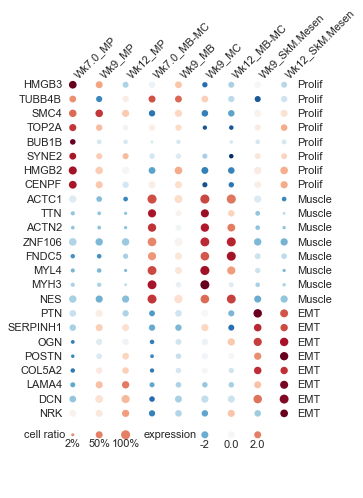

In [58]:
# Cherrypick genes
# plt.rcParams['xtick.bottom'] = plt.rcParams['xtick.labelbottom'] = False
# plt.rcParams['xtick.top'] = plt.rcParams['xtick.labeltop'] = True
sns.set('poster', rc={"font.size": 11})
scaled_expr = results_s2.iloc[:, 4].values
scaled_expr[np.isnan(scaled_expr)] = 0
#scaled_expr[scaled_expr>np.percentile(scaled_expr, 90)] = np.percentile(scaled_expr, 90)
#scaled_expr[scaled_expr <= 0.2] = 0

fig, ax = plt.subplots()
fig.set_size_inches(5, 8.5)
ax.scatter(results_s2.loc[:, 'X'].values, 
           results_s2.loc[:, 'Y'].values, 
           c=scaled_expr,
           s=results_s2.iloc[:, 3].values*50,
           vmin=-2, vmax=2.0,
           cmap='RdBu_r')

           #cmap='Reds')
#ax.set_xticks(range(0, 9))
#ax.set_xticklabels([map_dict2[i] for i in range(0, 9)])
for i in range(9):
    ax.text(i, 23.4, map_dict2[i], ha='left', rotation=45, verticalalignment='bottom')
    
##ax.xaxis.set_tick_params(labeltop='on')
#ax.set_yticks(range(0, len(gene_dict2.values())))
#ax.set_yticklabels([gene_dict2[i] for i in range(0, len(gene_dict2.values()))])

for i in results_s.Y.unique():
    ax.text(-0.4, i, gene_dict2[i], ha='right', rotation=0, verticalalignment='center')    
    ax.text(8.5, i, state_dict[i], ha='left', rotation=0, verticalalignment='center')
ax.axis('off')

# manual legend
ax.scatter([0, 1, 2], 
           [-1.5, -1.5, -1.5],
           c=[1, 1, 1],
           s=[1, 25, 50],
           vmin=-2, vmax=2.0,
           cmap='RdBu_r')

ax.scatter([5, 6, 7], 
           [-1.5, -1.5, -1.5],
           c=[-1, 0, 1],
           s=[25, 25, 25],
           vmin=-2, vmax=2.0,
           cmap='RdBu_r')

ax.text(-0.3, -1.5, 'cell ratio', ha='right', va='center')
ax.text(0, -2.12, '2%', ha='center', va='center')
ax.text(1, -2.12, '50%', ha='center', va='center')
ax.text(2, -2.12, '100%', ha='center', va='center')

ax.text(4.7, -1.5, 'expression', ha='right', va='center')
ax.text(5, -2.16, '-2', ha='center', va='center')
ax.text(6, -2.16, '%.1f' % (0), ha='center', va='center')
#ax.text(6, -2.16, '%.2f' % ((np.min(results_s.iloc[:, 4]) + np.max(results_s.iloc[:, 4]))/2), ha='center', va='center')
#ax.text(7, -2.16, '%.2f' % (np.max(results_s.iloc[:, 4])), ha='center', va='center')
ax.text(7, -2.16, '%.1f' % (2.0), ha='center', va='center')

ax.margins(0.16)
plt.savefig("DraftFig1_selecteddotplot.pdf")

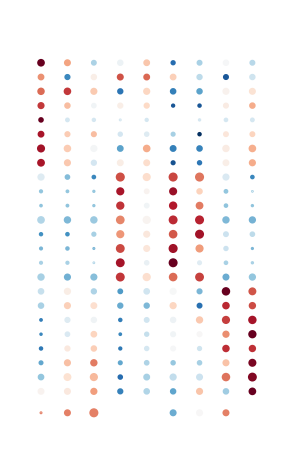

In [60]:
# Cherrypick genes
# plt.rcParams['xtick.bottom'] = plt.rcParams['xtick.labelbottom'] = False
# plt.rcParams['xtick.top'] = plt.rcParams['xtick.labeltop'] = True
sns.set('poster', rc={"font.size": 11})
scaled_expr = results_s2.iloc[:, 4].values
scaled_expr[np.isnan(scaled_expr)] = 0
#scaled_expr[scaled_expr>np.percentile(scaled_expr, 90)] = np.percentile(scaled_expr, 90)
#scaled_expr[scaled_expr <= 0.2] = 0

fig, ax = plt.subplots()
fig.set_size_inches(5, 8.5)
ax.scatter(results_s2.loc[:, 'X'].values, 
           results_s2.loc[:, 'Y'].values, 
           c=scaled_expr,
           s=results_s2.iloc[:, 3].values*50,
           vmin=-2, vmax=2.0,
           cmap='RdBu_r')

           #cmap='Reds')
#ax.set_xticks(range(0, 9))
#ax.set_xticklabels([map_dict2[i] for i in range(0, 9)])
#for i in range(9):
#     ax.text(i, 23.4, map_dict2[i], ha='left', rotation=45, verticalalignment='bottom')
    
##ax.xaxis.set_tick_params(labeltop='on')
#ax.set_yticks(range(0, len(gene_dict2.values())))
#ax.set_yticklabels([gene_dict2[i] for i in range(0, len(gene_dict2.values()))])

# for i in results_s.Y.unique():
#     ax.text(-0.4, i, gene_dict2[i], ha='right', rotation=0, verticalalignment='center')    
#     ax.text(8.5, i, state_dict[i], ha='left', rotation=0, verticalalignment='center')
ax.axis('off')

# manual legend
ax.scatter([0, 1, 2], 
           [-1.5, -1.5, -1.5],
           c=[1, 1, 1],
           s=[1, 25, 50],
           vmin=-2, vmax=2.0,
           cmap='RdBu_r')

ax.scatter([5, 6, 7], 
           [-1.5, -1.5, -1.5],
           c=[-1, 0, 1],
           s=[25, 25, 25],
           vmin=-2, vmax=2.0,
           cmap='RdBu_r')

# ax.text(-0.3, -1.5, 'cell ratio', ha='right', va='center')
# ax.text(0, -2.12, '2%', ha='center', va='center')
# ax.text(1, -2.12, '50%', ha='center', va='center')
# ax.text(2, -2.12, '100%', ha='center', va='center')

# ax.text(4.7, -1.5, 'expression', ha='right', va='center')
# ax.text(5, -2.16, '-2', ha='center', va='center')
# ax.text(6, -2.16, '%.1f' % (0), ha='center', va='center')
# #ax.text(6, -2.16, '%.2f' % ((np.min(results_s.iloc[:, 4]) + np.max(results_s.iloc[:, 4]))/2), ha='center', va='center')
# #ax.text(7, -2.16, '%.2f' % (np.max(results_s.iloc[:, 4])), ha='center', va='center')
# ax.text(7, -2.16, '%.1f' % (2.0), ha='center', va='center')

ax.margins(0.16)
plt.savefig("DraftFig1_selecteddotplot_nolabel.pdf")

In [419]:
!pwd

/PHShome/qq06/projects/02_atlas


### GSEA 

In [9]:
import gseapy as gp

/PHShome/qq06/projects/02_atlas/normal_muscle_cellbrowser/skeletal-muscle/embryonic/embryonic-wk6-7-myogenic/meta.tsv
(100, 2)
   symbol      fold
2     DST  0.780969
30   ATF7  0.625889
4   CSRP2  0.621802
53   DLK1  0.615154
6   SPARC  0.614761
(100, 2)
      symbol      fold
23     MKI67  1.020437
8   HIST1H1D  0.969085
34     TOP2A  0.966279
9     FAM60A  0.822185
94  HIST1H1E  0.811097
MB-MC EMT ['CMYA5' 'SPARC']
MB-MC DiffMuscle ['COL25A1' 'FLNC' 'MACF1']
MB-MC Prolif []
MB-MC Histone []
MB-MC Interferon []
MB-MC Apoptosis []
MB-MC UPR ['DNAJC3' 'FDFT1']
MB-MC Unique1 ['CMYA5' 'GOLGA8A']
MB-MC Unique2 []
MB-MC Unique3 []
MB-MC Unique5 ['GRINA']
MB-MC Unique6 []
MB-MC ERMS []
MB-MC ARMS []
MP EMT ['FRMD4A' 'VCAN']
MP DiffMuscle []
MP Prolif ['ASPM' 'BIRC5' 'BUB1B' 'BUB3' 'CCNA2' 'CCNB2' 'CENPF' 'CENPU' 'CKAP2'
 'CKS2' 'FBXO5' 'GINS2' 'H2AFX' 'HMGB2' 'HMGB3' 'KIF23' 'LMNB1' 'MKI67'
 'NUSAP1' 'PCNA' 'SMC4' 'SYNE2' 'TOP2A' 'TPX2' 'TTK' 'UBE2C']
MP Histone ['HIST1H1A' 'HIST1H1D' 'HIST

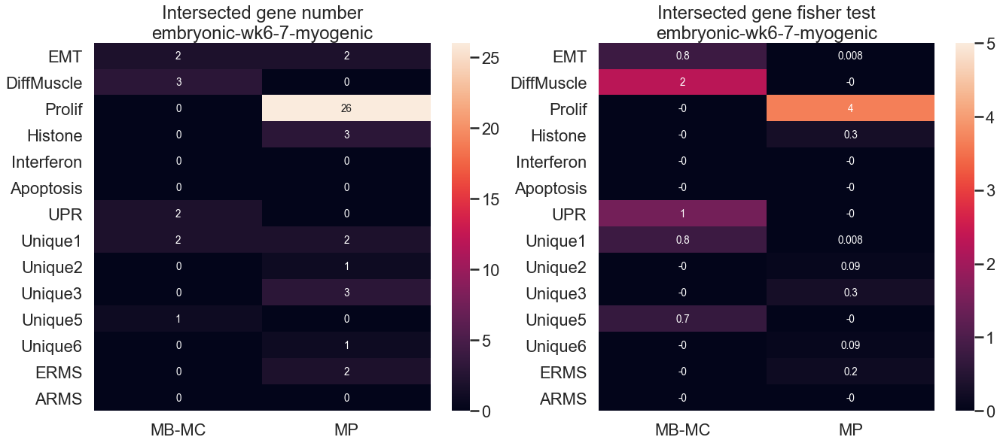

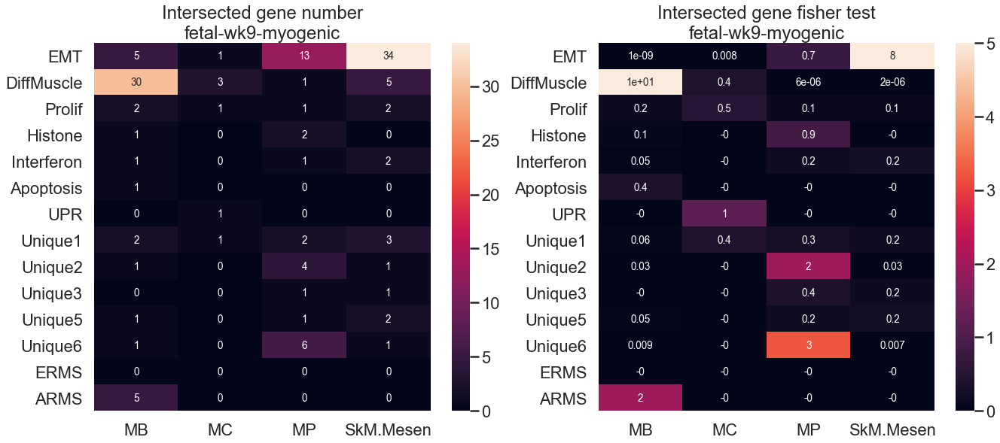

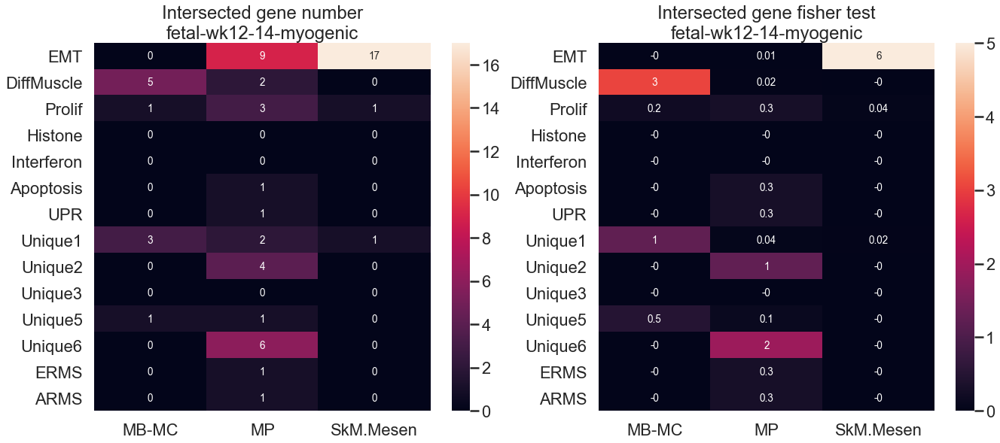

In [10]:
import os

state_rms_p_tmps = []

geneset = {}

for m in ['/PHShome/qq06/projects/02_atlas/normal_muscle_cellbrowser/skeletal-muscle/embryonic/embryonic-wk6-7-myogenic/meta.tsv',
          '/PHShome/qq06/projects/02_atlas/normal_muscle_cellbrowser/skeletal-muscle/fetal/fetal-wk9-myogenic/meta.tsv', 
          '/PHShome/qq06/projects/02_atlas/normal_muscle_cellbrowser/skeletal-muscle/fetal/fetal-wk12-14-myogenic/meta.tsv']:
    try:
        smp_sc_meta = pd.read_table(m, header=0, index_col=0)
        print(m)
        
        geneset[m] = {}
        
        dirs = os.path.dirname(m)
        label = os.path.basename(dirs)
        normal_muscle_marker = [pd.read_table('%s/%s.tsv.gz' % (dirs, c.replace('.', '').replace('-', ''))) 
                                for c in np.unique(smp_sc_meta.loc[:, 'Cell.Type'])]
        normal_muscle_marker2 = [s.iloc[:, [1, 3]] for s in normal_muscle_marker]
        for s in normal_muscle_marker2:
            print(s.shape)
            s.columns = ['symbol', 'fold']
            s.sort_values('fold',
                           ascending=False, inplace=True)
            print(s.head())


        normal_muscle_marker = [s.iloc[:, 0].values for s in normal_muscle_marker]  
        state_rms = pd.DataFrame(np.zeros((np.unique(smp_sc_meta.loc[:, 'Cell.Type']).shape[0], 14)), index=np.unique(smp_sc_meta.loc[:, 'Cell.Type']),
                                 columns=['EMT', 'DiffMuscle', 'Prolif', 'Histone', 
                                           'Interferon', 'Apoptosis', 'UPR', 
                                          'Unique1', 'Unique2', 'Unique3', 'Unique5', 'Unique6',
                                          'ERMS', 'ARMS'])
        state_rms_p = pd.DataFrame(np.zeros((np.unique(smp_sc_meta.loc[:, 'Cell.Type']).shape[0], 14)), index=np.unique(smp_sc_meta.loc[:, 'Cell.Type']),
                                 columns=['EMT', 'DiffMuscle', 'Prolif', 'Histone', 
                                           'Interferon', 'Apoptosis', 'UPR', 
                                          'Unique1', 'Unique2', 'Unique3', 'Unique5', 'Unique6', 
                                           'ERMS', 'ARMS'])
        from functools import reduce
        allstates = reduce(np.union1d, normal_muscle_marker)
        allrms = reduce(np.union1d, rms_marker)

        for inx, i, iii in zip(range(4), normal_muscle_marker, normal_muscle_marker2):
            for ind, j in zip(range(15), rms_marker):
                state_rms.iloc[inx, ind] = np.intersect1d(i, j).shape[0]   
                non_j = np.setdiff1d(allrms, j)
                non_i = np.setdiff1d(allstates, i)

                cell1 = np.intersect1d(i, j).shape[0]
                cell2 = np.intersect1d(i, non_j).shape[0]

                cell3 = np.intersect1d(non_i, j).shape[0]       
                cell4 = np.intersect1d(non_i, non_j).shape[0]

                tab = [[cell1, cell2], [cell3, cell4]]
                #print(state_rms.index[inx], state_rms.columns[ind], tab)
                print(state_rms.index[inx], state_rms.columns[ind], np.intersect1d(i, j))                
                state_rms_p.iloc[inx, ind] = scipy.stats.fisher_exact(tab, alternative='greater')[1]   
                #geneset[m][np.unique(smp_sc_meta.loc[:, 'Cell.Type'])[inx]+"_"+state_rms_p.columns[ind]]=np.intersect1d(i, j)                
                geneset[m][np.unique(smp_sc_meta.loc[:, 'Cell.Type'])[inx]+"_"+state_rms_p.columns[ind]]=iii
                
        state_rms_p_tmp = pd.melt(state_rms_p)
        state_rms_p_tmp.loc[:, 'age'] = label
        state_rms_p_tmps.append(state_rms_p_tmp)        
        sns.set_context("poster", rc={"font.size": 13.5})        
        sns.set_style("white")
        fig, ax = plt.subplots(1, 2)
        fig.set_size_inches(22, 9)
        sns.heatmap(state_rms.T, annot=True, ax=ax[0], square=False)
        ax[0].set_title('Intersected gene number\n%s' % label)
        sns.heatmap(-np.log10(state_rms_p).T, annot=True, vmin=0, vmax=5, fmt='.1g', ax=ax[1], square=False)
        ax[1].set_title('Intersected gene fisher test\n%s' % label)
        #plt.savefig('Fig4_state_rms%s.pdf' % label)                        
    except:
        print(m)

In [11]:
geneset.keys()

dict_keys(['/PHShome/qq06/projects/02_atlas/normal_muscle_cellbrowser/skeletal-muscle/embryonic/embryonic-wk6-7-myogenic/meta.tsv', '/PHShome/qq06/projects/02_atlas/normal_muscle_cellbrowser/skeletal-muscle/fetal/fetal-wk9-myogenic/meta.tsv', '/PHShome/qq06/projects/02_atlas/normal_muscle_cellbrowser/skeletal-muscle/fetal/fetal-wk12-14-myogenic/meta.tsv'])

In [12]:
smp_sc_map = pd.read_table('/PHShome/qq06/projects/02_atlas/normal_muscle_cellbrowser/skeletal-muscle/embryonic/embryonic-wk6-7-myogenic/Seurat_tsne.coords.tsv.gz',
                           header=None)

smp_sc_meta = pd.read_table('/PHShome/qq06/projects/02_atlas/normal_muscle_cellbrowser/skeletal-muscle/embryonic/embryonic-wk6-7-myogenic/meta.tsv', 
                             header=0, index_col=0)

smp_sc_meta.loc[:, 'age'] = smp_sc_meta.loc[:, 'orig.ident.short'].map(lambda x: x.split('_')[0])
smp_sc = pd.read_table('/PHShome/qq06/projects/02_atlas/normal_muscle_cellbrowser/skeletal-muscle/embryonic/embryonic-wk6-7-myogenic/exprMatrix.tsv.gz',
                       header=0, index_col=0)

adata = anndata.AnnData(scipy.sparse.csr_matrix(smp_sc.values).T.toarray(), 
                    var=pd.DataFrame(smp_sc.index, index=smp_sc.index), 
                    obs=smp_sc_meta)
adata.obsm['X_tsne'] = smp_sc_map.iloc[:, 1:].values
sc.pp.normalize_total(adata, target_sum=1e6)
sc.pp.log1p(adata)
#sc.pp.highly_variable_genes(adata, n_top_genes=5000)
adata.raw = adata

sc.tl.rank_genes_groups(adata, 'Cell.Type', method='t-test', n_genes=13000)
df = pd.DataFrame(adata.uns['rank_genes_groups']['names'])
df.loc[:,'rnk'] = df.shape[0]-df.index.values

... storing 'orig.ident' as categorical
... storing 'Phase' as categorical
... storing 'orig.ident.short' as categorical
... storing 'orig.ident.short_cell.type' as categorical
... storing 'Cell.Type' as categorical
... storing 'age' as categorical


In [13]:
np.intersect1d(muscle.iloc[:, 0].tolist(), list(geneset['/PHShome/qq06/projects/02_atlas/normal_muscle_cellbrowser/skeletal-muscle/embryonic/embryonic-wk6-7-myogenic/meta.tsv']['MP_Prolif'].symbol))

array([], dtype='<U12')

In [14]:
enr = gp.enrichr(gene_list=list(geneset['/PHShome/qq06/projects/02_atlas/normal_muscle_cellbrowser/skeletal-muscle/embryonic/embryonic-wk6-7-myogenic/meta.tsv']['MP_Prolif'].symbol),
                 gene_sets={'Prolif': prolif.iloc[:, 0].tolist(), 
                            'EMT': emt.iloc[:, 0].tolist(),
                            'Muscle': muscle.iloc[:, 0].tolist()},
                 organism='Human', # don't forget to set organism to the one you desired! e.g. Yeast
                 description='test_name',
                 outdir='gsea/custom',
                 # no_plot=True,
                 cutoff=1.0 # test dataset, use lower value from range(0,1)
                )

In [15]:
enr.results

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Genes
0,CUSTOM139951000411808,EMT,2/133,1.546274e-01,1.546274e-01,FRMD4A;VCAN
1,CUSTOM139951000411808,Prolif,26/114,3.746954e-36,7.493907e-36,CENPU;CKAP2;MKI67;BUB3;SMC4;TPX2;HMGB2;BIRC5;C...


In [17]:
!pwd

/PHShome/qq06/projects/02_atlas


In [18]:
??gseaplot

Object `gseaplot` not found.


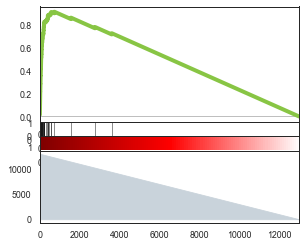

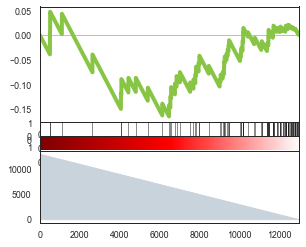

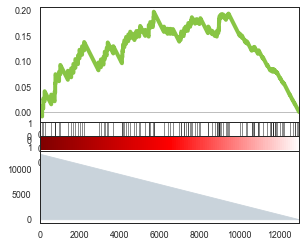

In [16]:
pre_res = gp.prerank(rnk=df.loc[:, ['MB-MC', 'rnk']],
                     gene_sets={'Prolif': prolif.iloc[:, 0].tolist(), 
                             'EMT': emt.iloc[:, 0].tolist(),
                             'Muscle': muscle.iloc[:, 0].tolist()},
                     processes=4, min_size=0,
                     permutation_num=100, # reduce number to speed up testing
                     outdir='test', format='png', seed=6)
from gseapy.plot import gseaplot, heatmap
terms = pre_res.res2d.index
# Make sure that ``ofname`` is not None, if you want to save your figure to disk
sns.set('paper', rc={'font.size': 9})
sns.set_style('white')

for t in terms:
    gseaplot(pre_res.ranking, term=t, **pre_res.results[t], 
             figsize=(4.5, 4))
    
    plt.subplots_adjust(left=0.8, bottom=0.2, right=0.9, top=0.95, wspace=0.38, hspace=0.65)        
    plt.savefig('DraftFig1_%s_wk67_GSEA_allgenes_MBMC.pdf' % t)

In [17]:
!pwd

/PHShome/qq06/projects/02_atlas


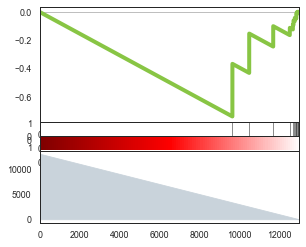

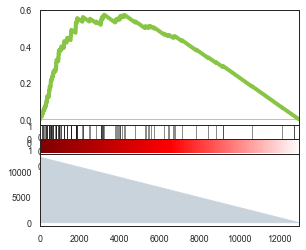

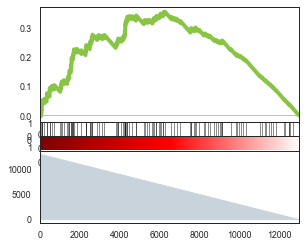

In [18]:
pre_res = gp.prerank(rnk=df.loc[:, ['MP', 'rnk']],
                     gene_sets={'Prolif': prolif.iloc[:, 0].tolist(), 
                             'EMT': emt.iloc[:, 0].tolist(),
                             'Muscle': muscle.iloc[:, 0].tolist()},
                     processes=4, min_size=0,
                     permutation_num=100, # reduce number to speed up testing
                     outdir='test', format='png', seed=6)
from gseapy.plot import gseaplot, heatmap
terms = pre_res.res2d.index
# Make sure that ``ofname`` is not None, if you want to save your figure to disk
sns.set('paper', rc={'font.size': 9})
sns.set_style('white')

for t in terms:
    gseaplot(pre_res.ranking, term=t, **pre_res.results[t], 
             figsize=(4.5, 4))
    
    plt.subplots_adjust(left=0.8, bottom=0.2, right=0.9, top=0.95, wspace=0.38, hspace=0.65)
    plt.savefig('DraftFig1_%s_wk67_GSEA_allgenes.pdf' % t)    

In [19]:
enr = gp.enrichr(gene_list=list(geneset['/PHShome/qq06/projects/02_atlas/normal_muscle_cellbrowser/skeletal-muscle/fetal/fetal-wk9-myogenic/meta.tsv']['MB_DiffMuscle'].symbol),
                 gene_sets={'Prolif': prolif.iloc[:, 0].tolist(), 
                            'EMT': emt.iloc[:, 0].tolist(),
                            'Muscle': muscle.iloc[:, 0].tolist()},
                 organism='Human', # don't forget to set organism to the one you desired! e.g. Yeast
                 description='test_name',
                 outdir='gsea/custom',
                 # no_plot=True,
                 cutoff=0.01 # test dataset, use lower value from range(0,1)
                )
enr.results

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Genes
0,CUSTOM139953110558544,EMT,5/133,6.827144e-04,1.024072e-03,TNMD;COL12A1;THY1;IL11RA;CRABP2
1,CUSTOM139953110558544,Muscle,28/75,6.071207e-46,1.821362e-45,MYL4;NEXN;TSPAN33;PLS3;CHRNA1;FNDC5;BLCAP;CHRN...
2,CUSTOM139953110558544,Prolif,2/114,1.207230e-01,1.207230e-01,CDC25B;CENPU


... storing 'orig.ident' as categorical
... storing 'Phase' as categorical
... storing 'orig.ident.short' as categorical
... storing 'orig.ident.short_cell.type' as categorical
... storing 'Cell.Type' as categorical


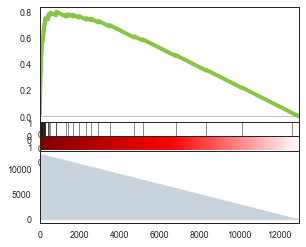

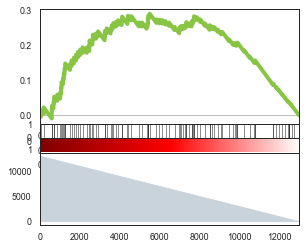

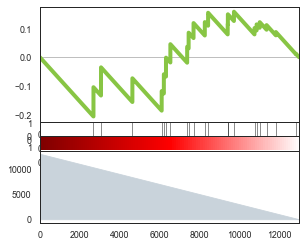

In [20]:
smp_sc_map = pd.read_table('/PHShome/qq06/projects/02_atlas/normal_muscle_cellbrowser/skeletal-muscle/fetal/fetal-wk9-myogenic/Seurat_tsne.coords.tsv.gz',
                           header=None)
smp_sc_meta.loc[:, 'age'] = smp_sc_meta.loc[:, 'orig.ident.short'].map(lambda x: x.split('_')[0])
smp_sc = pd.read_table('/PHShome/qq06/projects/02_atlas/normal_muscle_cellbrowser/skeletal-muscle/fetal/fetal-wk9-myogenic/exprMatrix.tsv.gz',
                       header=0, index_col=0)
smp_sc_meta = pd.read_table('/PHShome/qq06/projects/02_atlas/normal_muscle_cellbrowser/skeletal-muscle/fetal/fetal-wk9-myogenic/meta.tsv', 
                             header=0, index_col=0)
adata = anndata.AnnData(scipy.sparse.csr_matrix(smp_sc.values).T.toarray(), 
                    var=pd.DataFrame(smp_sc.index, index=smp_sc.index), 
                    obs=smp_sc_meta)
adata.obsm['X_tsne'] = smp_sc_map.iloc[:, 1:].values
sc.pp.normalize_total(adata, target_sum=1e6)
sc.pp.log1p(adata)
#sc.pp.highly_variable_genes(adata, n_top_genes=5000)
adata.raw = adata

sc.tl.rank_genes_groups(adata, 'Cell.Type', method='t-test', n_genes=13000)
df = pd.DataFrame(adata.uns['rank_genes_groups']['names'])
df.loc[:,'rnk'] = df.shape[0]-df.index.values

sns.set('paper', rc={'font.size': 9})
sns.set_style('white')
pre_res = gp.prerank(rnk=df.loc[:, ['MB', 'rnk']],
                     gene_sets={'Prolif': prolif.iloc[:, 0].tolist(), 
                             'EMT': emt.iloc[:, 0].tolist(),
                             'Muscle': muscle.iloc[:, 0].tolist()},
                     processes=4,
                     permutation_num=100, # reduce number to speed up testing
                     outdir='test', format='png', seed=6)
from gseapy.plot import gseaplot, heatmap
terms = pre_res.res2d.index

for t in terms:
    gseaplot(pre_res.ranking, term=t, **pre_res.results[t], figsize=(4.5, 4))
    plt.subplots_adjust(left=0.8, bottom=0.2, right=0.9, top=0.95, wspace=0.38, hspace=0.65)
    plt.savefig('DraftFig1_wk9_%s_GSEA_allgenes.pdf' % t)    

Index(['Muscle'], dtype='object', name='Term')


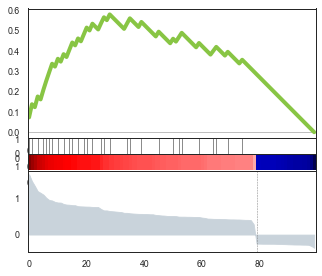

In [21]:
pre_res = gp.prerank(rnk=geneset['/PHShome/qq06/projects/02_atlas/normal_muscle_cellbrowser/skeletal-muscle/fetal/fetal-wk9-myogenic/meta.tsv']['MB_DiffMuscle'],
                     gene_sets={'Prolif': prolif.iloc[:, 0].tolist(), 
                             'EMT': emt.iloc[:, 0].tolist(),
                             'Muscle': muscle.iloc[:, 0].tolist()},
                     processes=4,
                     permutation_num=100, # reduce number to speed up testing
                     outdir='test', format='png', seed=6)

from gseapy.plot import gseaplot, heatmap
terms = pre_res.res2d.index

print(terms)

# Make sure that ``ofname`` is not None, if you want to save your figure to disk
gseaplot(pre_res.ranking, term=terms[0], **pre_res.results[terms[0]], 
         figsize=(5, 4.5))

plt.subplots_adjust(left=0.3, bottom=0.2, right=0.9, top=0.95, wspace=0.38, hspace=0.65)
plt.savefig('DraftFig1_Muscle.pdf')

In [15]:
geneset['/PHShome/qq06/projects/02_atlas/normal_muscle_cellbrowser/skeletal-muscle/fetal/fetal-wk9-myogenic/meta.tsv'].keys()

dict_keys(['MB_EMT', 'MB_DiffMuscle', 'MB_Prolif', 'MB_Histone', 'MB_Interferon', 'MB_Apoptosis', 'MB_UPR', 'MB_Unique1', 'MB_Unique2', 'MB_Unique3', 'MB_Unique5', 'MB_Unique6', 'MB_ERMS', 'MB_ARMS', 'MC_EMT', 'MC_DiffMuscle', 'MC_Prolif', 'MC_Histone', 'MC_Interferon', 'MC_Apoptosis', 'MC_UPR', 'MC_Unique1', 'MC_Unique2', 'MC_Unique3', 'MC_Unique5', 'MC_Unique6', 'MC_ERMS', 'MC_ARMS', 'MP_EMT', 'MP_DiffMuscle', 'MP_Prolif', 'MP_Histone', 'MP_Interferon', 'MP_Apoptosis', 'MP_UPR', 'MP_Unique1', 'MP_Unique2', 'MP_Unique3', 'MP_Unique5', 'MP_Unique6', 'MP_ERMS', 'MP_ARMS', 'SkM.Mesen_EMT', 'SkM.Mesen_DiffMuscle', 'SkM.Mesen_Prolif', 'SkM.Mesen_Histone', 'SkM.Mesen_Interferon', 'SkM.Mesen_Apoptosis', 'SkM.Mesen_UPR', 'SkM.Mesen_Unique1', 'SkM.Mesen_Unique2', 'SkM.Mesen_Unique3', 'SkM.Mesen_Unique5', 'SkM.Mesen_Unique6', 'SkM.Mesen_ERMS', 'SkM.Mesen_ARMS'])

In [16]:
geneset['/PHShome/qq06/projects/02_atlas/normal_muscle_cellbrowser/skeletal-muscle/fetal/fetal-wk12-14-myogenic/meta.tsv'].keys()

dict_keys(['MB-MC_EMT', 'MB-MC_DiffMuscle', 'MB-MC_Prolif', 'MB-MC_Histone', 'MB-MC_Interferon', 'MB-MC_Apoptosis', 'MB-MC_UPR', 'MB-MC_Unique1', 'MB-MC_Unique2', 'MB-MC_Unique3', 'MB-MC_Unique5', 'MB-MC_Unique6', 'MB-MC_ERMS', 'MB-MC_ARMS', 'MP_EMT', 'MP_DiffMuscle', 'MP_Prolif', 'MP_Histone', 'MP_Interferon', 'MP_Apoptosis', 'MP_UPR', 'MP_Unique1', 'MP_Unique2', 'MP_Unique3', 'MP_Unique5', 'MP_Unique6', 'MP_ERMS', 'MP_ARMS', 'SkM.Mesen_EMT', 'SkM.Mesen_DiffMuscle', 'SkM.Mesen_Prolif', 'SkM.Mesen_Histone', 'SkM.Mesen_Interferon', 'SkM.Mesen_Apoptosis', 'SkM.Mesen_UPR', 'SkM.Mesen_Unique1', 'SkM.Mesen_Unique2', 'SkM.Mesen_Unique3', 'SkM.Mesen_Unique5', 'SkM.Mesen_Unique6', 'SkM.Mesen_ERMS', 'SkM.Mesen_ARMS'])

In [22]:
enr = gp.enrichr(gene_list=list(geneset['/PHShome/qq06/projects/02_atlas/normal_muscle_cellbrowser/skeletal-muscle/fetal/fetal-wk12-14-myogenic/meta.tsv']['SkM.Mesen_EMT'].symbol),
                 gene_sets={'Prolif': prolif.iloc[:, 0].tolist(), 
                            'EMT': emt.iloc[:, 0].tolist(),
                            'Muscle': muscle.iloc[:, 0].tolist()},
                 organism='Human', # don't forget to set organism to the one you desired! e.g. Yeast
                 description='test_name',
                 outdir='gsea/custom',
                 # no_plot=True,
                 cutoff=0.01 # test dataset, use lower value from range(0,1)
                )
enr.results

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Genes
0,CUSTOM139953113751272,EMT,15/133,3.140311e-16,6.280622e-16,MEOX2;PLAC9;LAMA4;NUPR1;FAM129A;SULF1;LAMB1;MG...
1,CUSTOM139953113751272,Prolif,1/114,4.523280e-01,4.523280e-01,TOP2A


... storing 'orig.ident' as categorical
... storing 'Phase' as categorical
... storing 'orig.ident.short' as categorical
... storing 'orig.ident.short_cell.type' as categorical
... storing 'Cell.Type' as categorical


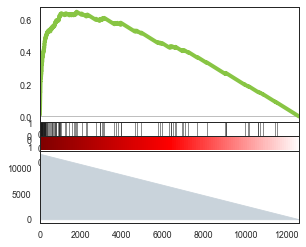

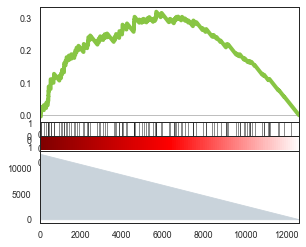

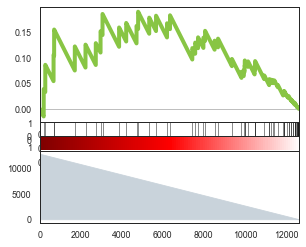

In [23]:
smp_sc_map = pd.read_table('/PHShome/qq06/projects/02_atlas/normal_muscle_cellbrowser/skeletal-muscle/fetal/fetal-wk12-14-myogenic/Seurat_tsne.coords.tsv.gz',
                           header=None)
smp_sc_meta.loc[:, 'age'] = smp_sc_meta.loc[:, 'orig.ident.short'].map(lambda x: x.split('_')[0])
smp_sc = pd.read_table('/PHShome/qq06/projects/02_atlas/normal_muscle_cellbrowser/skeletal-muscle/fetal/fetal-wk12-14-myogenic/exprMatrix.tsv.gz',
                       header=0, index_col=0)
smp_sc_meta = pd.read_table('/PHShome/qq06/projects/02_atlas/normal_muscle_cellbrowser/skeletal-muscle/fetal/fetal-wk12-14-myogenic/meta.tsv', 
                             header=0, index_col=0)
adata = anndata.AnnData(scipy.sparse.csr_matrix(smp_sc.values).T.toarray(), 
                    var=pd.DataFrame(smp_sc.index, index=smp_sc.index), 
                    obs=smp_sc_meta)
adata.obsm['X_tsne'] = smp_sc_map.iloc[:, 1:].values
sc.pp.normalize_total(adata, target_sum=1e6)
sc.pp.log1p(adata)
#sc.pp.highly_variable_genes(adata, n_top_genes=5000)
adata.raw = adata

sc.tl.rank_genes_groups(adata, 'Cell.Type', method='t-test', n_genes=13000)
df = pd.DataFrame(adata.uns['rank_genes_groups']['names'])
df.loc[:,'rnk'] = df.shape[0]-df.index.values
sns.set('paper', rc={'font.size': 9})
sns.set_style('white')
pre_res = gp.prerank(rnk=df.loc[:, ['SkM.Mesen', 'rnk']],
                     gene_sets={'Prolif': prolif.iloc[:, 0].tolist(), 
                             'EMT': emt.iloc[:, 0].tolist(),
                             'Muscle': muscle.iloc[:, 0].tolist()},
                     processes=4,
                     permutation_num=100, # reduce number to speed up testing
                     outdir='test', format='png', seed=6)
from gseapy.plot import gseaplot, heatmap
terms = pre_res.res2d.index

for t in terms:
    gseaplot(pre_res.ranking, term=t, **pre_res.results[t], figsize=(4.5, 4))
    plt.subplots_adjust(left=0.8, bottom=0.2, right=0.9, top=0.95, wspace=0.38, hspace=0.65)    
    plt.savefig('DraftFig1_%s_wk1214_GSEA_allgenes.pdf' % t)

In [24]:
!pwd

/PHShome/qq06/projects/02_atlas


Index(['EMT'], dtype='object', name='Term')


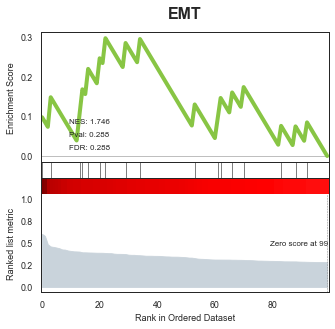

In [21]:
sns.set_context("paper", rc={"font.size": 8})        

pre_res = gp.prerank(rnk=geneset['/PHShome/qq06/projects/02_atlas/normal_muscle_cellbrowser/skeletal-muscle/fetal/fetal-wk12-14-myogenic/meta.tsv']['SkM.Mesen_EMT'],
                     gene_sets={'Prolif': prolif.iloc[:, 0].tolist(), 
                             'EMT': emt.iloc[:, 0].tolist(),
                             'Muscle': muscle.iloc[:, 0].tolist()},
                     processes=4,
                     permutation_num=100, # reduce number to speed up testing
                     outdir='test', format='png', seed=6)

from gseapy.plot import gseaplot, heatmap
terms = pre_res.res2d.index
print(terms)

# Make sure that ``ofname`` is not None, if you want to save your figure to disk
gseaplot(pre_res.ranking, term=terms[0], **pre_res.results[terms[0]], 
         figsize=(5, 4.5))

plt.subplots_adjust(left=0.3, bottom=0.2, right=0.9, top=0.95, wspace=0.38, hspace=0.65)
plt.savefig('DraftFig1_EMT.pdf')

## Figure 2 from Dave's design

In [15]:
adata = load_adata()
# sns.set('poster')
# sns.set_style('white')
# stages = pd.DataFrame({'DC1': adata.obsm['X_diffmap_orig'][:, 0], 
#               'DC2': adata.obsm['X_diffmap_orig'][:, 1],
#               'Stage': adata.obs.loc[:, 'Dev.Stage']})
# g = sns.scatterplot(x='DC1', y='DC2', data=stages, hue='Stage', legend='brief', s=20)
# sns.despine()
# g.legend(loc='center left', bbox_to_anchor=(1.25, 0.5), ncol=3)

# fig, ax = plt.subplots()
# sns.set('poster')
# sns.set_style('white')
# stages = pd.DataFrame({'DC1': adata.obsm['X_diffmap_orig'][:, 0], 
#               'DC2': adata.obsm['X_diffmap_orig'][:, 1],
#               'Age': adata.obs.loc[:, 'age']})
# g = sns.scatterplot(x='DC1', y='DC2', data=stages, hue='Age', legend='brief', s=20, ax=ax)
# sns.despine()
# g.legend(loc='center left', bbox_to_anchor=(1.25, 0.5), ncol=3)
#ax.legend(bbox_to_anchor=(1.01, 1), loc=2, borderaxespad=0.)

... storing 'orig.ident' as categorical
... storing 'Phase' as categorical
... storing 'Dev.Stage' as categorical
... storing 'orig.ident.short' as categorical
... storing 'age' as categorical


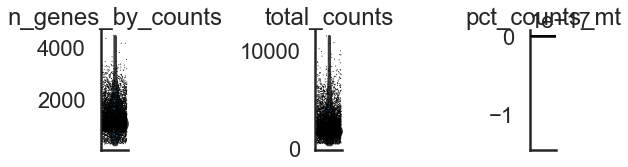

In [ ]:
adata.var['mt'] = adata.var_names.str.startswith('MT-')  # annotate the group of mitochondrial genes as 'mt'
sc.pp.calculate_qc_metrics(adata, qc_vars=['mt'], percent_top=None, inplace=True)
sc.pl.violin(adata, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt'],
             jitter=0.4, multi_panel=True)
adata = load_adata()
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)

sc.pp.highly_variable_genes(adata, n_top_genes=1000)
adata.raw = adata

adata.obs['ARMS_all_score'] = adata[:, arms_all[np.in1d(arms_all, adata.var_names)]].X.toarray().mean(axis=1)
adata.obs['ERMS_all_score'] = adata[:, erms_all[np.in1d(erms_all, adata.var_names)]].X.toarray().mean(axis=1)

adata.obs['ARMS_core_score'] = adata[:, arms[np.in1d(arms, adata.var_names)]].X.toarray().mean(axis=1)
adata.obs['ERMS_core_score'] = adata[:, erms[np.in1d(erms, adata.var_names)]].X.toarray().mean(axis=1)

In [ ]:
sns.set_context("poster", rc={"font.size": 14})        
sns.set_style('white')

fig, ax = plt.subplots(1, 3)
fig.set_size_inches(16, 3.5)
sc.pl.embedding(adata, legend_loc='none', color='Dev.Stage', basis='diffmap_orig', show=False, ax=ax[0])
ax[0].axis('off')
sns.despine()

sc.pl.embedding(adata, basis='diffmap_orig', color=['ARMS_core_score'],
                frameon=False, use_raw=True, ncols=2, legend_loc='none', ax=ax[1], show=False,
                )

sc.pl.embedding(adata, basis='diffmap_orig', color=['ERMS_core_score'],
                frameon=False, use_raw=True, ncols=2, legend_loc='none', ax=ax[2], show=False,
                )

###plt.savefig("DraftFig2_stages.png", dpi=300)
plt.savefig("DraftFig2_stages.pdf", dpi=300)

In [21]:
adata.obs.head()

,nGene,nUMI,orig.ident,S.Score,G2M.Score,Phase,Dev.Stage,Dev.Score,orig.ident.short,age,ARMS_all_score,ERMS_all_score,ARMS_core_score,ERMS_core_score
Cell,,,,,,,,,,,,,,
A_Emb_Wk06.0_AP5_AAACTAGTAGGG,2136,4042,A_Emb_Wk06.0_AP5,0.208240,0.820380,G2M,Stage_1,-0.881463,Wk6_AP5,Wk6,0.145808,0.348487,0.276971,0.653352
A_Emb_Wk06.0_AP5_AAAGGTCATCCC,1469,2555,A_Emb_Wk06.0_AP5,-0.108452,-0.260224,G1,Stage_1,-0.845096,Wk6_AP5,Wk6,0.090476,0.230590,0.176931,0.435650
A_Emb_Wk06.0_AP5_AATAATCTGTGC,1871,3445,A_Emb_Wk06.0_AP5,-0.162394,1.080385,G2M,Stage_1,-0.847552,Wk6_AP5,Wk6,0.121043,0.181794,0.000000,0.617295
A_Emb_Wk06.0_AP5_ACCAGGTATCGG,2288,5227,A_Emb_Wk06.0_AP5,0.068742,0.806510,G2M,Stage_1,-0.957340,Wk6_AP5,Wk6,0.139961,0.318650,0.000000,0.860334
A_Emb_Wk06.0_AP5_AGACATCGCAAT,1178,1730,A_Emb_Wk06.0_AP5,-0.169490,0.629559,G2M,Stage_1,-0.784398,Wk6_AP5,Wk6,0.065335,0.190037,0.000000,0.698297


In [31]:
data_tmp.head()

,nGene,nUMI,orig.ident,S.Score,G2M.Score,Phase,Dev.Stage,Dev.Score,orig.ident.short,age,ARMS_all_score,ERMS_all_score,ARMS_core_score,ERMS_core_score,groups
Cell,,,,,,,,,,,,,,,
A_Emb_Wk06.0_AP5_AAACTAGTAGGG,2136,4042,A_Emb_Wk06.0_AP5,0.208240,0.820380,G2M,Stage_1,-0.881463,Wk6_AP5,Wk6,0.145808,0.348487,0.276971,0.653352,Both
A_Emb_Wk06.0_AP5_AAAGGTCATCCC,1469,2555,A_Emb_Wk06.0_AP5,-0.108452,-0.260224,G1,Stage_1,-0.845096,Wk6_AP5,Wk6,0.090476,0.230590,0.176931,0.435650,Both
A_Emb_Wk06.0_AP5_AATAATCTGTGC,1871,3445,A_Emb_Wk06.0_AP5,-0.162394,1.080385,G2M,Stage_1,-0.847552,Wk6_AP5,Wk6,0.121043,0.181794,0.000000,0.617295,Not ARMS
A_Emb_Wk06.0_AP5_ACCAGGTATCGG,2288,5227,A_Emb_Wk06.0_AP5,0.068742,0.806510,G2M,Stage_1,-0.957340,Wk6_AP5,Wk6,0.139961,0.318650,0.000000,0.860334,Not ARMS
A_Emb_Wk06.0_AP5_AGACATCGCAAT,1178,1730,A_Emb_Wk06.0_AP5,-0.169490,0.629559,G2M,Stage_1,-0.784398,Wk6_AP5,Wk6,0.065335,0.190037,0.000000,0.698297,Not ARMS


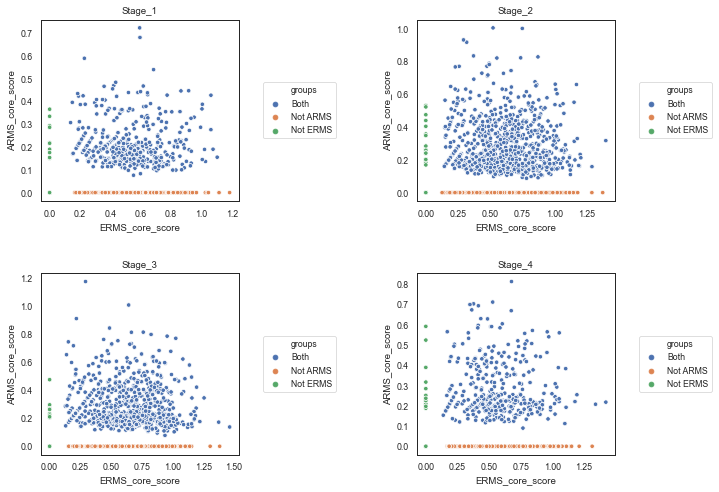

In [60]:
plt.rcParams['xtick.bottom'] = plt.rcParams['xtick.labelbottom'] = True
plt.rcParams['xtick.top'] = plt.rcParams['xtick.labeltop'] = False

sns.set('paper', style='white', rc={'font.size': 15})
fig, ax = plt.subplots(2, 2)
fig.set_size_inches(11, 8)
ax = ax.flatten()

for i, d in enumerate(['Stage_1', 'Stage_2', 'Stage_3', 'Stage_4']):
    data_tmp = adata.obs.loc[adata.obs.loc[:, 'Dev.Stage']==d, :]
    data_tmp.loc[:, 'groups'] = 'Both'
    data_tmp.loc[data_tmp.ARMS_core_score < 0.02, 'groups'] = 'Not ARMS'
    data_tmp.loc[data_tmp.ERMS_core_score < 0.02, 'groups'] = 'Not ERMS'
    data_tmp.groups = data_tmp.groups.astype('category')
    
    sns.scatterplot(x='ERMS_core_score', y='ARMS_core_score', hue='groups',
                    data=data_tmp, 
                    ax=ax[i], s=20)
    ax[i].legend(loc='center left', bbox_to_anchor=(1.1, 0.5), ncol=1)
    ax[i].set_title(d)
plt.subplots_adjust(hspace=0.4, wspace=0.9, right=0.85)
plt.savefig('DraftFig2_AERMS_comparison.pdf')

In [47]:
data_list = []
for i, d in enumerate(['Stage_1', 'Stage_2', 'Stage_3', 'Stage_4']):
    adata_tmp = adata.obs.loc[adata.obs.loc[:, 'Dev.Stage']==d, :]
    a_score = adata_tmp.ARMS_core_score
    e_score = adata_tmp.ERMS_core_score
    data_list.append([(a_score<0.02).sum()/a_score.shape[0], (e_score<0.02).sum()/e_score.shape[0], 
          ((a_score<0.02) & (e_score<0.02)).sum()/e_score.shape[0], 
          ((a_score>=0.02) | (e_score>=0.02)).sum()/e_score.shape[0]])

In [50]:
pd.DataFrame(data_list, columns=['Not express ARMS core', 
                                 'Not express ERMS core', 
                                 'Not express both', 
                                 'Express either'], index=['Stage_1', 'Stage_2', 'Stage_3', 'Stage_4']).to_csv("Supp2_scatter.csv")

In [51]:
!cat Supp2_scatter.csv

,Not express ARMS core,Not express ERMS core,Not express both,Express either
Stage_1,0.5107102593010147,0.043968432919954906,0.030439684329199548,0.9695603156708005
Stage_2,0.37315530569219957,0.03794799718903725,0.023190442726633873,0.9768095572733662
Stage_3,0.3227194492254733,0.016351118760757316,0.008605851979345954,0.9913941480206541
Stage_4,0.4759493670886076,0.04810126582278481,0.026582278481012658,0.9734177215189873


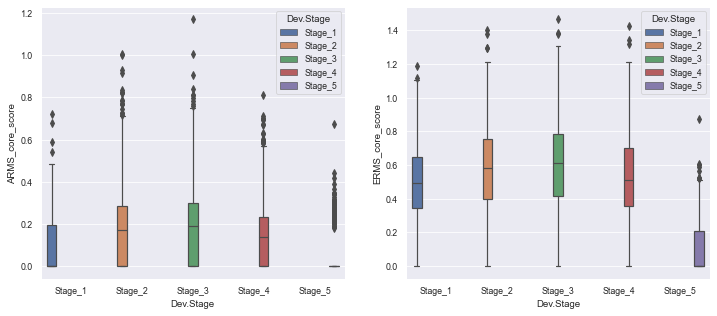

In [79]:
fig, ax = plt.subplots(1, 2)
fig.set_size_inches(12, 5)
sns.set('paper')
sns.boxplot(x='Dev.Stage', y='ARMS_core_score',
            hue='Dev.Stage', data=adata.obs, ax=ax[0])

sns.set('paper')
sns.boxplot(x='Dev.Stage', y='ERMS_core_score',
            hue='Dev.Stage', data=adata.obs, ax=ax[1])

plt.savefig('DraftFig2_boxplot.pdf')

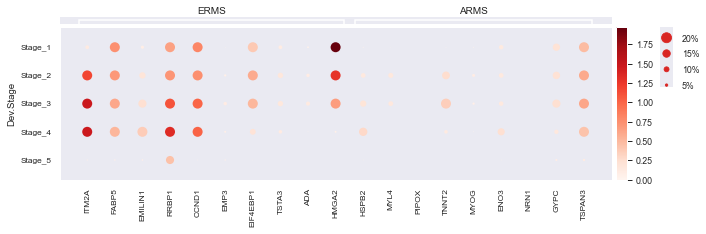

GridSpec(2, 5, height_ratios=[0.5, 10], width_ratios=[10.05, 0, 0.2, 0.5, 0.25])

In [80]:
sns.set('paper', rc={'font.size': 10})
sc.pl.dotplot(adata, {'ERMS': erms[np.in1d(erms, adata.var_names)], 
                      'ARMS': arms[np.in1d(arms, adata.var_names)]}, mean_only_expressed=False,
              groupby='Dev.Stage', dot_min=0.001, dot_max=0.2, expression_cutoff=0.001, figsize=[11, 3],
              save='DraftFig2_dot2.pdf')

In [132]:
arms[np.in1d(arms, adata.var_names)]

array(['HSPB2', 'MYL4', 'PIPOX', 'TNNT2', 'MYOG', 'ENO3', 'NRN1', 'GYPC',
       'TSPAN3'], dtype='<U6')

In [129]:
outputs = []
for s in ['Stage_1', 'Stage_2', 'Stage_3', 'Stage_4', 'Stage_5']:
    expr = adata[adata.obs.loc[:, 'Dev.Stage']==s, np.hstack([arms[np.in1d(arms, adata.var_names)], 
                                                              erms[np.in1d(erms, adata.var_names)]])].X.toarray()
    print(expr.shape)
    ratio = (expr >= 0.1).sum(axis=0)/adata.shape[0]
    print(ratio)
    ave_expr = expr.mean(axis=0)
    outputs.append(ratio * ave_expr)
outputs = pd.DataFrame(outputs, 
                                                        columns=np.hstack([arms[np.in1d(arms, adata.var_names)], 
                                                              erms[np.in1d(erms, adata.var_names)]]), 
                                                        index=['Stage_1', 'Stage_2', 'Stage_3', 'Stage_4', 'Stage_5'])
outputs[:] = StandardScaler().fit_transform(outputs.values)    

(887, 19)
[0.00360399 0.00211999 0.000424   0.00296799 0.00339199 0.01674793
 0.000212   0.02755989 0.05851177 0.01420394 0.08225567 0.01208395
 0.0739877  0.08649565 0.00275599 0.04621582 0.01441594 0.00657197
 0.15836337]
(1423, 19)
[0.02861989 0.03052788 0.000212   0.04727581 0.01823193 0.02861989
 0.00169599 0.04494382 0.10939156 0.17214331 0.12359551 0.03858385
 0.12295951 0.1261395  0.01399194 0.10493958 0.03307187 0.02119992
 0.18571126]
(1162, 19)
[0.03116388 0.02374391 0.         0.0506678  0.01165995 0.02225991
 0.000848   0.04027984 0.09115964 0.17299131 0.08840365 0.04027984
 0.14161543 0.12931948 0.01738393 0.07695569 0.02671189 0.02035192
 0.09327963]
(790, 19)
[0.02798389 0.00190799 0.         0.01208395 0.00275599 0.0239559
 0.         0.01462794 0.04133983 0.11151155 0.04515582 0.03476786
 0.10345559 0.08034768 0.00678397 0.01971592 0.01187195 0.00254399
 0.00657197]
(455, 19)
[0.00148399 0.         0.         0.000848   0.         0.00148399
 0.         0.00402798 0.0

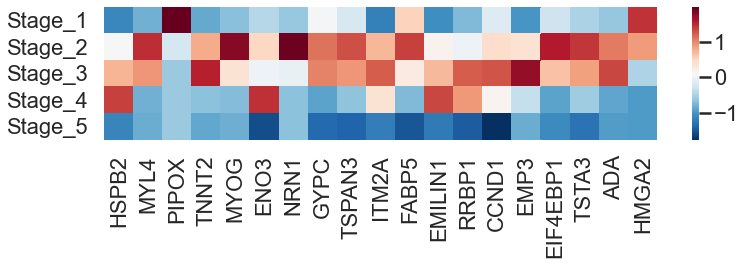

In [130]:
from sklearn.preprocessing import StandardScaler
sns.set('poster')
fig = plt.figure(figsize=(16, 4))
sns.heatmap(outputs, cmap='RdBu_r')
plt.subplots_adjust(left=0.3, bottom=0.42)
plt.savefig("DraftFig2_heatmap.pdf")

In [ ]:
sns.set('paper', rc={'font.size': 10})
sc.pl.dotplot(adata, {'ERMS': erms[np.in1d(erms, adata.var_names)], 
                      'ARMS': arms[np.in1d(arms, adata.var_names)]}, mean_only_expressed=False,
              groupby='Dev.Stage', dot_min=0.001, dot_max=0.2, expression_cutoff=0.001, figsize=[11, 3],
              save='DraftFig2_dot2.pdf')

In [550]:
pd.DataFrame(adata[:, np.hstack([erms[np.in1d(erms, adata.var_names)], arms[np.in1d(arms, adata.var_names)]])].X.toarray(), 
             columns=np.hstack([erms[np.in1d(erms, adata.var_names)], arms[np.in1d(arms, adata.var_names)]])).corr(method='spearman')

,ITM2A,FABP5,EMILIN1,RRBP1,CCND1,EMP3,EIF4EBP1,TSTA3,ADA,HMGA2,HSPB2,MYL4,PIPOX,TNNT2,MYOG,ENO3,NRN1,GYPC,TSPAN3
ITM2A,1.000000,0.024490,0.071474,0.174847,0.089149,0.053981,0.085811,0.033643,0.022151,-0.168006,0.112595,0.104771,-0.022376,0.134559,0.054420,0.047992,0.028313,0.014868,0.083360
FABP5,0.024490,1.000000,0.032435,0.008485,0.075026,0.028348,0.092159,0.034540,0.041625,0.123319,0.011748,0.045996,0.001500,0.025394,0.019408,0.041669,0.013444,0.066476,0.048935
EMILIN1,0.071474,0.032435,1.000000,0.055283,0.054398,0.064885,0.033034,0.015501,0.026443,-0.036498,0.015516,0.034486,-0.009664,0.022531,-0.001827,0.063823,0.002830,0.021242,-0.006456
RRBP1,0.174847,0.008485,0.055283,1.000000,0.091235,0.026779,-0.001500,-0.017686,-0.001433,-0.074151,0.042264,-0.011060,-0.001309,0.017141,-0.021345,0.022669,-0.006327,-0.001835,0.039080
CCND1,0.089149,0.075026,0.054398,0.091235,1.000000,0.014607,0.055632,0.057415,0.030134,0.063880,0.062378,0.021543,-0.004635,0.054279,0.060621,0.034432,-0.000286,0.031355,0.080884
EMP3,0.053981,0.028348,0.064885,0.026779,0.014607,1.000000,0.032669,0.026668,0.011028,-0.020316,0.051755,0.016119,-0.005375,0.044872,0.034886,0.024260,0.009215,0.022156,0.027495
EIF4EBP1,0.085811,0.092159,0.033034,-0.001500,0.055632,0.032669,1.000000,0.018189,0.032137,0.111142,0.022784,0.075096,-0.014334,0.078835,0.020382,0.009967,-0.003074,0.056013,0.098689
TSTA3,0.033643,0.034540,0.015501,-0.017686,0.057415,0.026668,0.018189,1.000000,0.068222,0.044081,0.019611,0.044006,-0.007783,0.024785,0.044736,0.025469,-0.001773,0.025870,0.035281
ADA,0.022151,0.041625,0.026443,-0.001433,0.030134,0.011028,0.032137,0.068222,1.000000,0.050248,0.013542,0.063505,-0.005825,0.049225,0.010454,0.012419,0.024356,0.011293,0.038646
HMGA2,-0.168006,0.123319,-0.036498,-0.074151,0.063880,-0.020316,0.111142,0.044081,0.050248,1.000000,-0.073016,0.019113,0.015165,-0.024208,0.014444,0.007585,0.015836,0.048451,0.070904


In [556]:
?sns.heatmap

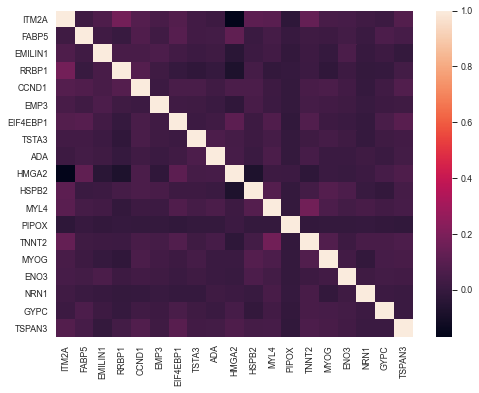

In [560]:
sns.set('paper')
fig, ax = plt.subplots()
fig.set_size_inches(8, 6)
ax = sns.heatmap(pd.DataFrame(adata[:, np.hstack([erms[np.in1d(erms, adata.var_names)], arms[np.in1d(arms, adata.var_names)]])].X.toarray(), 
             columns=np.hstack([erms[np.in1d(erms, adata.var_names)], arms[np.in1d(arms, adata.var_names)]])).corr(method='spearman'), ax=ax)
ax.margins(0.2)
plt.savefig('DraftFig2_RMSCore_corr.pdf')

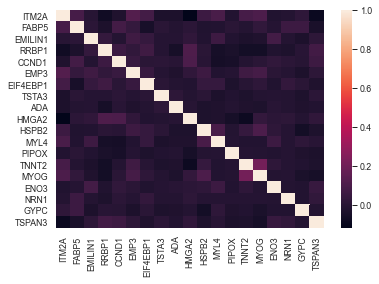

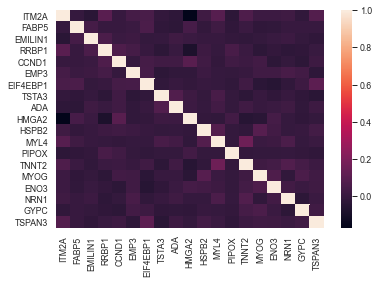

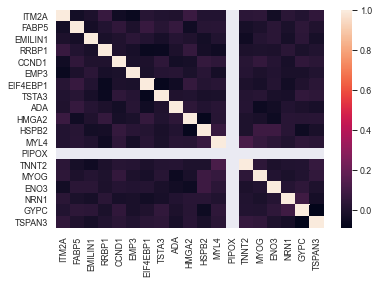

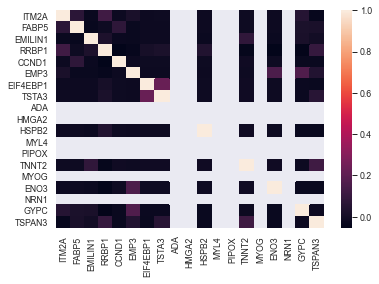

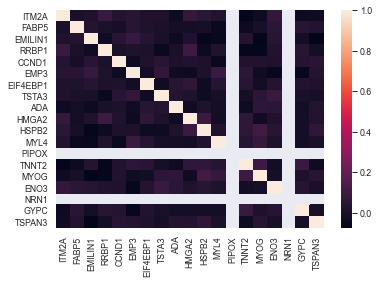

In [554]:
for s in adata.obs.loc[:, 'Dev.Stage'].unique():
    plt.figure()
    sns.heatmap(pd.DataFrame(adata[adata.obs.loc[:, 'Dev.Stage'] == s, np.hstack([erms[np.in1d(erms, adata.var_names)], arms[np.in1d(arms, adata.var_names)]])].X.toarray(), 
                 columns=np.hstack([erms[np.in1d(erms, adata.var_names)], arms[np.in1d(arms, adata.var_names)]])).corr())
    plt.savefig('DraftFig2_RMSCore_corr%s.pdf' % s)